# DEVOIR N°2


Vous devez compresser le dossier contenant vos réponses et le nommer par <strong>Your_Name_FirstName.zip</strong> et envoyez-le à mon adresse gamil: red.ezzahir 


Vous devez également remettre le devoir en format papier 

# Question 1 (5pts)

Décrire en 30 lignes maximum le principe des algorithmes génétiques ?
vous pour insert 4 images au maximum (voir en bas comment l'image est inserée)

Les algorithmes génétiques sont une famille d'algorithmes de recherche locale qui recherchent des solutions optimales aux problèmes en utilisant les principes de la sélection naturelle et de l'évolution. Ils peuvent être appliqués à presque tous les problèmes d'optimisation et sont particulièrement utiles pour les problèmes où d'autres techniques basées sur le calcul ne fonctionnent pas, comme lorsque la fonction objectif a de nombreux optima locaux, n'est pas différentiable ou continue, ou que les éléments de solution sont contraints d'être entiers ou séquences. Les étapes: en premier lieu on créer la population initiale, pour procéder: au lieu de juste créer une solution initiale, on génère aléatoiement une population initiale. Puis on calcule le nombre de fitness aproprié = nombre de conflits Deuxiemement, on applique les opérateurs génétiques:

1) Sélection Cet opérateur sélectionne les chromosomes dans la population pour la reproduction. Plus le chromosome est en forme, plus il est susceptible d'être sélectionné pour se reproduire.

2) Crossover Cet opérateur choisit aléatoirement un lieu et échange les sous-séquences avant et après ce lieu entre deux chromosomes pour créer deux descendants. Par exemple, les chaînes 10000100 et 11111111 pourraient être croisé après le troisième locus dans chacun pour produire les deux descendants 10011111 et 11100100. Le croisement imite à peu près la recombinaison biologique entre deux organismes monochromosomiques (haploïdes).

3) Mutation Cet opérateur retourne aléatoirement certains des bits d'un chromosome. Par exemple, la chaîne 00000100 peut être muté dans sa deuxième position pour donner 01000100. La mutation peut se produire à chaque position de bit dans une chaîne avec une certaine probabilité, généralement très faible (par exemple, 0,001). Si par exemple on traite un probleme de maximisation, on s'arrete au maximun déterminé ou bien on s'arrete à la limite des générations oou bien on ré-applique pour la nouvelle génération courantes les opérations génétiques.


Le code de ce devoir s'appuie sur la mise en œuvre que nous avons vue lors de travaux pratiques sur les algorithmes génétiques

In [1]:
from random import choices, choice, randint, randrange, shuffle, sample
from random import random as rnd
from typing import List, Optional, Callable, Tuple, Set
from copy import  deepcopy
from functools import partial,   reduce
from statistics import mean, stdev
import time 

Genome = List[int]
Chromosome = List[int] 
Population = List[Chromosome]
PopulateFunc = Callable[[], Population]
FitnessFunc = Callable[[Chromosome], int]
SelectionFunc = Callable[[Population, FitnessFunc], Tuple[Chromosome, Chromosome]]
CrossoverFunc = Callable[[Chromosome, Chromosome], Tuple[Chromosome, Chromosome]]
MutationFunc = Callable[[Chromosome], Chromosome]
PrinterFunc = Callable[[Population, int, FitnessFunc], None]



def generate_chromosome(genome: Genome,  chromosome_length=None) -> Chromosome:
    if  chromosome_length is None: 
        return choices(genome, k=len(genome))
    else:
        return choices(genome, k=chromosome_length)


def generate_population (size: int, genome: Genome,  chromosome_length=None ) -> Population: 
    population = []
    i = 0
    while len(population) < size:
        chromosome = generate_chromosome(genome, chromosome_length)
        if not chromosome in population or i == 10: 
            population.append(chromosome)
            i = 0
        else :
            i +=1
        
    return population



def single_point_crossover(a: Chromosome, b: Chromosome) -> Tuple[Chromosome, Chromosome]:
    if not len(a)==len(b):
        raise ValueError("The given chromosones don't have the same length!")
    r = randint(1, len(a)-1)  
    x, y = a.copy(), b.copy()  
    for i in range(r):
        x[i], y[i] = y[i], x[i]
    return x, y
        

def mutation(chromosome: Chromosome, genome: Genome, 
             probability: float = 0.2) -> Chromosome:
    """Mutate, usually with a low probability, the given chromosome. 
     @param chromosome: chromosome to mutate
     @param probability: probability that a mutation attempt will be successful
    """
    chromosome  = chromosome.copy() 
    r = rnd() 
    if r < probability:
        p = randrange(0, len(chromosome))
        x = choice(genome)
        while(x == chromosome[p]):
            x = choice(genome)
        
        chromosome[p]=x
    
    return chromosome


def population_fitness(population: Population, fitness_func: FitnessFunc) -> int:
    return reduce(lambda x, y: x+y, map(fitness_func, population))


def selection_pair(population: Population, fitness_func: FitnessFunc,  maximize: bool = False) -> Population:
    fitnesses= list(map(fitness_func, population))
    if not maximize : 
        maxi= max(fitnesses)
        fitnesses= map(lambda x: maxi-x+1, fitnesses)
    return  choices(population, weights=fitnesses,  k=2)
        

#help(sorted)
def sort_population(population: Population, 
                    fitness_func: FitnessFunc, 
                    maximize: bool=False) -> Population:
    return sorted(population, key = fitness_func, reverse=maximize)
    

def chromosome_to_string(chromosome: Chromosome) -> str:
    return ''.join(map(str,chromosome))


def print_statistics(population: Population, generation_id: int,  fitness_func: FitnessFunc):
    
    print("GENERATION %02d" % generation_id)
    print("=================")
    print("Population: [%s]" % ", ".join([chromosome_to_string(ch) for ch in population]))
    

    fitness = list(map(fitness_func, population))
    
    print("  Min %s" % min(fitness))
    print("  Max %s" % max(fitness))
    print("  Avg %s" % mean(fitness))
    print("  Std %s" % stdev(fitness))

     
        
def get_statistics(population: Population, generation_id: int,  fitness_func: FitnessFunc):  
    fitness = list(map(fitness_func, population)) 
    return generation_id,  min(fitness),  max(fitness),  mean(fitness), stdev(fitness)

     
    
def run_evolution(populate_func: PopulateFunc, fitness_func: FitnessFunc, 
                  fitness_limit: int, maximize: bool = False,
                  selection_func: SelectionFunc = selection_pair,
                  crossover_func: CrossoverFunc = single_point_crossover,
                  mutation_func: MutationFunc = mutation, generation_limit: int = 100,
                  printer: Optional[PrinterFunc] = None) -> Tuple[Population, int]:  
    
    #generate a population initial
    population = populate_func()
    # sort and assign the population 
    population = sort_population(population, fitness_func, maximize)
    # iterate until the generation_limit
    for i in range(generation_limit) : 
        # print the i^th generation if a printer is given
        if not printer is None:
            printer(population, i, fitness_func)
        
        # we break if the fitness_limit is reached, >=fitness_limit when maximization and <=fitness_limit for minimizatio
        best_fitness =fitness_func(population[0])
        if (maximize and best_fitness >= fitness_limit) \
                or (not maximize and best_fitness <= fitness_limit):
            break;
             
        # initialize next_generation by the two first individuals in the sorted population
        next_generation = [population[0], population[1]]
        while len(next_generation) < len(population): 
            # select  a pair of parents  uning selection_func and fitness_func 
            x, y = selection_func(population, fitness_func, maximize) 
            # call crossover_func to get offspring a, b from the parents
            a, b = crossover_func(x, y)
            # apply  mutation_func on each offspring 
            a = mutation_func(a)
            b = mutation_func(b)
            # increment the next generation 
            next_generation.append(a)
            next_generation.append(b)
            

        # population = next_generation
        population = next_generation
        # sort and assign the population 
        population = sort_population(population, fitness_func, maximize) 
        
    printer(population, i, fitness_func)
    best_fitness =fitness_func(population[0])
 
    return population, best_fitness, i
 

    


# Question 2 (3pts)
Dans ce problème, une fonction présentant plusieurs maxima locaux (ce qui rend inapplicables les algorithmes les plus simples de recherche de maximum) est définie sur un certain intervalle et le but est de déterminer à l'aide des algorithmes génétiques l'abscisse du maximum global (sur l'intervalle) de la fonction. On va donc utiliser une population dans laquelle chaque individu correspond à une abscisse située dans l'intervalle.

La fonction $g(x) =x^2cos(1/(10x))sin(x/10)/10$ à optimiser est présentée dans la figure suivante:



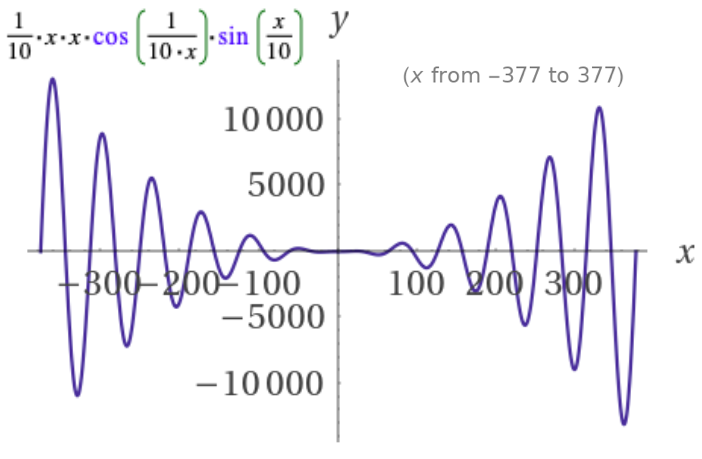

### Remarque :

l’étude d’une fonction à une variable n’a pour but uniquement la démonstration pédagogique et illustratif, puisque vous constaterez que le nombre total d'abscisses testées avant d'atteindre le maximum global (égal au nombre de générations multiplié par la taille de la  population) est généralement tel qu'on aurait un aussi bon résultat en répartissant simplement ce nombre d'abscisses uniformément sur l'intervalle puis en cherchant Max(f(Xi)). L'intérêt des algorithmes génétiques pour la recherche de maximum de fonction n'est en pratique réel que dans le cas d'une fonction à beaucoup de variables, car alors toute exploration systématique de l'espace des n-uplets possibles devient prohibitive, tandis qu'un algorithme génétique peut rester efficace. Malheureusement, la visualisation de la recherche du maximum d'une fonction à n variables est problématique pour n=2, et devient carrément impossible (ou en tout cas incompréhensible) pour n>=3...


### Codage du Chromosome

Une des premières questions qui se posent est celle du codage : à quelle séquence de gènes faire correspondre une abscisse de l'intervalle ? On peut faire le choix de prendre chaque gène égal à un bit (donc le génome original est 01), et de faire correspondre à chaque chromosome  (du type 10011100...) l'abscisse 
$x = xMin + N*(xMax - xMin)/Nmax $
où N est l'entier dont la représentation binaire est donnée par le chromosome, et Nmax est le plus grand entier représentable avec le nombre de bits correspondant à taille du chromosome. Il ne reste donc plus qu'à choisir le nombre de bits constituant le génome de chaque individu. 
 Nous nous intéressons à optimiser la fonction g(x) dans l’intervalle $I=[-255, 255]$.
 

### 2.1) Que représentent  xMin, et xMax.
 

In [2]:
xMin, xMax =  -255, 255


### 2.2)  Taille du chromosome 
Si la taille du chromosome est n bits,  donner Nmax:le nombre maximum du chromosone representables en fonction de n (noté bien que pour  8 bits =>  Nmax=256), puis déduire le nombre minimal de bits (n_min) constituant le chromosome de chaque individu pour pouvoir representer 8 individus entre chaque deux entiers de l’interval I (Le nombre total d'individus representable est donc (xMax - xMin + 1)*8.


In [3]:
#retourne l'entier maximum à représenter par n bits ()

def n_max(n) :
    return  2**n - 1

#retourne le nombre minimum de bits pour représenter N chromosomes (ce n'est pas pour représenter le nombre N)
def n_bits(N):
    return N.bit_length()
    
    
#Donner Nmax en fonction de xMin et xMax si nous choisisions à representer 8 individus (ou 8 réels)
#entre chaque deux entiers dans l'interval xMin et xMax

Nmax =  n_max(n_bits((xMax - xMin + 1)*8))

#déduire le nombre minimal de bits (n_min) constituant le chromosone d'un individu parmi les Nmax.
n_min =  n_bits((xMax - xMin + 1)*8)

 

print('Nmax=', Nmax)
print('n_min=', n_min) 

Nmax= 4095
n_min= 12


# Question 3 (3pts)
#### MAXIMIZING g(x) =x^2/10 cos(1/(10x))sin(x/10) USING GENETIC ALGORITHM 

##### 3.1) Ecrire la fonction genome_gx que retourne un genome composé de deux gènes 0 et 1

In [4]:
def genome_gx() -> Genome:
    return choices([0,1],k=n_min)

#### 3.2) En utilisant l'opérateur de décalage de bits +| ecrire la fonction qui convertie un chromosome  (liste binaire) en entier.


In [5]:
def chromosome_to_integer(chromosome: Chromosome):
    # using bit shift + | operator converting binary list to integer
    n=0
    for i, b in enumerate(reversed(chromosome)):
        n |= b << i
    return n 

In [6]:
#TEST
Genome = genome_gx()
Chrom= generate_chromosome(Genome, chromosome_length = 11)
print(Genome)
print(chromosome_to_integer(Chrom))

[0, 1, 1, 0, 1, 0, 1, 0, 1, 0, 1, 1]
797


#### 3.3) En utilisant la fonction précedente ecrire une fonction qui transforme un chromosome en un individus x (abscisse) $x = xMin + N*(xMax - xMin)/Nmax $, ou N est l'entier représenté par le chromosome.

In [7]:
def chromosome_to_x(chromosome: Chromosome):
    x=xMin+(chromosome_to_integer(chromosome)*(xMax-xMin))/Nmax
    return x

In [8]:
#TEST
chromosome_to_x(Chrom)

-155.73992673992674

#### 3.4) En utilisant la fonction précedente ecrire la fonction gx qui retourne l'évaluation d'un chromosome par la fonction $g(x) =x^2cos(1/(10x))sin(x/10)/10$  attention! si x=0 return 0 pour eviter l'exception ZeroDivisionError

In [9]:
import numpy as np
def gx(chromosome: Chromosome):
    x= chromosome_to_x(chromosome)
    if x==0: 
        return 0
    gx= x**2*np.cos(1/(10*x))*np.sin(x/10)/10
    return gx



In [10]:
#TEST
gx(Chrom)

-323.973448751708

#### 3.5) En utilisant le moteur de recherche de google  (ecrire dans le champs de recherche l'expression x*x cos(1/(10x))sin(x/10)/10 ) verifier que la valeur minimale de g dans l'intervale $I$ est $-5555$ et mettre le boolean à True si oui.

In [11]:
verified = True

#### 3.6)  Ecrire la fonction fitenss_gx  qui retourne  (gx(chromosone) + 5555)/10

In [12]:
def fitness_gx(chromosome: Chromosome):
    return (gx(chromosome)+5555)/100



#### 3.7)  Expliquer pourquoi nous avons ajouté 5555 à gx et pour quel raison nous avons divisé par 10

votre réponse ici: on sait que la fonction fitness est toujours positive et on a d'après 3.5: min<0 et gx>min => gx-min>0 => gx-(-5555)>0 = gx+5555>0 et on a divisé par 100 pour obtenir un pourcentage

#### 3.8) Quelle est la valeur max du fitness_gx  ( ) si le max de g(x) dans I est 5555

In [13]:
FITNESS_LIMIT =  (5555+5555)/100
FITNESS_LIMIT

111.1

#### 3.9) C'est le temps de tester l'agorithme genetique sur g(x) 

In [14]:
POPULATION_SIZE = 4
MUTATION_RATE = 0.15
GENERATION_LIMIT =  1000


In [15]:
def run_genetic(): 
    start = time.time()
    population, best_f, generations =  run_evolution(
            populate_func=partial(generate_population, size=POPULATION_SIZE, genome=genome_gx(), chromosome_length=n_bits(Nmax)),
            fitness_func=fitness_gx, mutation_func=partial(mutation, genome=genome_gx(), probability=MUTATION_RATE),
            fitness_limit=FITNESS_LIMIT, crossover_func=single_point_crossover,
            printer=print_statistics, maximize=True,
            generation_limit=GENERATION_LIMIT) 
    end = time.time() 
    elapsed_time=(end - start)
    generation_id,  min_fit ,  max_fit ,  avg_fit , stdev_fit  = \
                                    get_statistics(population, generations, fitness_func=fitness_gx )
    
    return generation_id, chromosome_to_x(population[0]), min_fit,  max_fit, avg_fit,  stdev_fit,  elapsed_time


gen_i, x,  min_fit,  max_fit, avg_fit, stdev_fit, t = run_genetic()
print("x qui maximise g {:.2f}".format(x))
print("g( {:.2f} )= {:.2f}".format(x, (x * x * np.cos(1 / (10. * x)) * np.sin(x / 10.) / 10.)))
print("fitness de x : {:.2f}".format(max_fit))
print("nombre de generations:", gen_i)
print("la moyen des fitness de la generation ", gen_i, " est {:.2f}".format(avg_fit))
print("Le temps d'execution est  {:.3f}".format(t))


GENERATION 00
Population: [000010110000, 001001000101, 101001110000, 100000001101]
  Min 55.550472208104466
  Max 108.13504207974047
  Avg 74.81245492984095
  Std 23.502931673586886
GENERATION 01
Population: [000010110000, 001001000101, 101001000101, 000000001101]
  Min 42.45834979097326
  Max 108.13504207974047
  Avg 71.10486248986142
  Std 27.850560435180444
GENERATION 02
Population: [000010110000, 001001000101, 001001000101, 001001000101]
  Min 73.98272932532238
  Max 108.13504207974047
  Avg 82.52080751392691
  Std 17.076156377209045
GENERATION 03
Population: [000010110000, 000010110000, 000010110000, 001001000101]
  Min 73.98272932532238
  Max 108.13504207974047
  Avg 99.59696389113594
  Std 17.076156377209045
GENERATION 04
Population: [000010110000, 000010110000, 000010110000, 000010110000]
  Min 108.13504207974047
  Max 108.13504207974047
  Avg 108.13504207974047
  Std 0.0
GENERATION 05
Population: [000010110000, 000010110000, 000010110000, 000010110000]
  Min 108.13504207974047


# Question 4 (3pts)

L'impact du nombre d'individus de la population sur la convergence:
si celui-ci est trop petit, il faut beaucoup plus de générations pour atteindre le maximum, car il n'y a pas assez de variété dans la population initiale, et seules les mutations finissent par permettre à l'algorithme de converger.

En suivant le schema suivant (Même principe utilié en devoir pour collecter et plotter des résultats) :

Initialisez un Tableau des resultats  (Results)

Pour POPULATION_SIZE allons de 2 jusqu'à 20 faire

    pour i alons de 1 jusqu'à 100 faire
        executez la fonction run_genetic() 
        les resultats sont collecter dans une liste 
    
    calculez les moyennes sur les 100 executions uiliser le module statistic vois plus haut
    et sauvgardez les dans le Tableau Results
    
Tracer les courbes des resultats (fitness, avg_fitness, generations, temps) en fonction de POPULATION_SIZE

Note: fitness et avg_fitness pouvent être tracées sur la même figure.

Commentez les courbes.



In [16]:
from statistics import mean
Results = np.empty([19, 5])
current_population = []
fitnessR= [ ]
avg_fitnessR=  [ ]
generationsR= [ ]
timeR= [ ]
for j in range(2, 21):
    POPULATION_SIZE=j
    for i in range(1,10):
        gen_i, x,  min_fit,  fitness, avg_fit, stdev_fit, t = run_genetic()
        fitnessR.append(fitness)
        avg_fitnessR.append(avg_fit)
        generationsR.append(gen_i)
        timeR.append(t)
        
    current_population.append(POPULATION_SIZE)    
    current_population.append(mean(fitnessR))    
    current_population.append(mean(avg_fitnessR))
    current_population.append(mean(generationsR))
    current_population.append(mean(timeR))
    
    Results[j-2] = current_population
    
    current_population.clear()
    fitnessR.clear()
    avg_fitnessR.clear()
    generationsR.clear()
    timeR.clear()

GENERATION 00
Population: [101001001101, 100100010110]
  Min 55.16368610363186
  Max 60.24834981761966
  Avg 57.70601796062576
  Std 3.5954001922139502
GENERATION 01
Population: [101001001101, 100100010110]
  Min 55.16368610363186
  Max 60.24834981761966
  Avg 57.70601796062576
  Std 3.5954001922139502
GENERATION 02
Population: [101001001101, 100100010110]
  Min 55.16368610363186
  Max 60.24834981761966
  Avg 57.70601796062576
  Std 3.5954001922139502
GENERATION 03
Population: [101001001101, 100100010110]
  Min 55.16368610363186
  Max 60.24834981761966
  Avg 57.70601796062576
  Std 3.5954001922139502
GENERATION 04
Population: [101001001101, 100100010110]
  Min 55.16368610363186
  Max 60.24834981761966
  Avg 57.70601796062576
  Std 3.5954001922139502
GENERATION 05
Population: [101001001101, 100100010110]
  Min 55.16368610363186
  Max 60.24834981761966
  Avg 57.70601796062576
  Std 3.5954001922139502
GENERATION 06
Population: [101001001101, 100100010110]
  Min 55.16368610363186
  Max 60.

  Min 55.621411569580076
  Max 57.79485910691069
  Avg 56.708135338245384
  Std 1.536859492199681
GENERATION 751
Population: [011010000011, 100001001011]
  Min 55.621411569580076
  Max 57.79485910691069
  Avg 56.708135338245384
  Std 1.536859492199681
GENERATION 752
Population: [011010000011, 100001001011]
  Min 55.621411569580076
  Max 57.79485910691069
  Avg 56.708135338245384
  Std 1.536859492199681
GENERATION 753
Population: [011010000011, 100001001011]
  Min 55.621411569580076
  Max 57.79485910691069
  Avg 56.708135338245384
  Std 1.536859492199681
GENERATION 754
Population: [011010000011, 100001001011]
  Min 55.621411569580076
  Max 57.79485910691069
  Avg 56.708135338245384
  Std 1.536859492199681
GENERATION 755
Population: [011010000011, 100001001011]
  Min 55.621411569580076
  Max 57.79485910691069
  Avg 56.708135338245384
  Std 1.536859492199681
GENERATION 756
Population: [011010000011, 100001001011]
  Min 55.621411569580076
  Max 57.79485910691069
  Avg 56.708135338245384
  

  Std 1.536859492199681
GENERATION 822
Population: [011010000011, 100001001011]
  Min 55.621411569580076
  Max 57.79485910691069
  Avg 56.708135338245384
  Std 1.536859492199681
GENERATION 823
Population: [011010000011, 100001001011]
  Min 55.621411569580076
  Max 57.79485910691069
  Avg 56.708135338245384
  Std 1.536859492199681
GENERATION 824
Population: [011010000011, 100001001011]
  Min 55.621411569580076
  Max 57.79485910691069
  Avg 56.708135338245384
  Std 1.536859492199681
GENERATION 825
Population: [011010000011, 100001001011]
  Min 55.621411569580076
  Max 57.79485910691069
  Avg 56.708135338245384
  Std 1.536859492199681
GENERATION 826
Population: [011010000011, 100001001011]
  Min 55.621411569580076
  Max 57.79485910691069
  Avg 56.708135338245384
  Std 1.536859492199681
GENERATION 827
Population: [011010000011, 100001001011]
  Min 55.621411569580076
  Max 57.79485910691069
  Avg 56.708135338245384
  Std 1.536859492199681
GENERATION 828
Population: [011010000011, 1000010010

  Avg 63.25059202418228
  Std 2.8012509538583745
GENERATION 777
Population: [000000101010, 001100000000]
  Min 61.26980847890374
  Max 65.23137556946082
  Avg 63.25059202418228
  Std 2.8012509538583745
GENERATION 778
Population: [000000101010, 001100000000]
  Min 61.26980847890374
  Max 65.23137556946082
  Avg 63.25059202418228
  Std 2.8012509538583745
GENERATION 779
Population: [000000101010, 001100000000]
  Min 61.26980847890374
  Max 65.23137556946082
  Avg 63.25059202418228
  Std 2.8012509538583745
GENERATION 780
Population: [000000101010, 001100000000]
  Min 61.26980847890374
  Max 65.23137556946082
  Avg 63.25059202418228
  Std 2.8012509538583745
GENERATION 781
Population: [000000101010, 001100000000]
  Min 61.26980847890374
  Max 65.23137556946082
  Avg 63.25059202418228
  Std 2.8012509538583745
GENERATION 782
Population: [000000101010, 001100000000]
  Min 61.26980847890374
  Max 65.23137556946082
  Avg 63.25059202418228
  Std 2.8012509538583745
GENERATION 783
Population: [00000

  Std 35.26239128043021
GENERATION 19
Population: [000010111011, 011100011010]
  Min 55.321601735943105
  Max 105.19015372643427
  Avg 80.25587773118869
  Std 35.26239128043021
GENERATION 20
Population: [000010111011, 011100011010]
  Min 55.321601735943105
  Max 105.19015372643427
  Avg 80.25587773118869
  Std 35.26239128043021
GENERATION 21
Population: [000010111011, 011100011010]
  Min 55.321601735943105
  Max 105.19015372643427
  Avg 80.25587773118869
  Std 35.26239128043021
GENERATION 22
Population: [000010111011, 011100011010]
  Min 55.321601735943105
  Max 105.19015372643427
  Avg 80.25587773118869
  Std 35.26239128043021
GENERATION 23
Population: [000010111011, 011100011010]
  Min 55.321601735943105
  Max 105.19015372643427
  Avg 80.25587773118869
  Std 35.26239128043021
GENERATION 24
Population: [000010111011, 011100011010]
  Min 55.321601735943105
  Max 105.19015372643427
  Avg 80.25587773118869
  Std 35.26239128043021
GENERATION 25
Population: [000010111011, 011100011010]
  M

  Std 35.26239128043021
GENERATION 651
Population: [000010111011, 011100011010]
  Min 55.321601735943105
  Max 105.19015372643427
  Avg 80.25587773118869
  Std 35.26239128043021
GENERATION 652
Population: [000010111011, 011100011010]
  Min 55.321601735943105
  Max 105.19015372643427
  Avg 80.25587773118869
  Std 35.26239128043021
GENERATION 653
Population: [000010111011, 011100011010]
  Min 55.321601735943105
  Max 105.19015372643427
  Avg 80.25587773118869
  Std 35.26239128043021
GENERATION 654
Population: [000010111011, 011100011010]
  Min 55.321601735943105
  Max 105.19015372643427
  Avg 80.25587773118869
  Std 35.26239128043021
GENERATION 655
Population: [000010111011, 011100011010]
  Min 55.321601735943105
  Max 105.19015372643427
  Avg 80.25587773118869
  Std 35.26239128043021
GENERATION 656
Population: [000010111011, 011100011010]
  Min 55.321601735943105
  Max 105.19015372643427
  Avg 80.25587773118869
  Std 35.26239128043021
GENERATION 657
Population: [000010111011, 0111000110

Population: [000000111011, 101000001011]
  Min 56.54634892033408
  Max 77.5876765392903
  Avg 67.06701272981219
  Std 14.878465444531733
GENERATION 221
Population: [000000111011, 101000001011]
  Min 56.54634892033408
  Max 77.5876765392903
  Avg 67.06701272981219
  Std 14.878465444531733
GENERATION 222
Population: [000000111011, 101000001011]
  Min 56.54634892033408
  Max 77.5876765392903
  Avg 67.06701272981219
  Std 14.878465444531733
GENERATION 223
Population: [000000111011, 101000001011]
  Min 56.54634892033408
  Max 77.5876765392903
  Avg 67.06701272981219
  Std 14.878465444531733
GENERATION 224
Population: [000000111011, 101000001011]
  Min 56.54634892033408
  Max 77.5876765392903
  Avg 67.06701272981219
  Std 14.878465444531733
GENERATION 225
Population: [000000111011, 101000001011]
  Min 56.54634892033408
  Max 77.5876765392903
  Avg 67.06701272981219
  Std 14.878465444531733
GENERATION 226
Population: [000000111011, 101000001011]
  Min 56.54634892033408
  Max 77.5876765392903


  Std 14.878465444531733
GENERATION 475
Population: [000000111011, 101000001011]
  Min 56.54634892033408
  Max 77.5876765392903
  Avg 67.06701272981219
  Std 14.878465444531733
GENERATION 476
Population: [000000111011, 101000001011]
  Min 56.54634892033408
  Max 77.5876765392903
  Avg 67.06701272981219
  Std 14.878465444531733
GENERATION 477
Population: [000000111011, 101000001011]
  Min 56.54634892033408
  Max 77.5876765392903
  Avg 67.06701272981219
  Std 14.878465444531733
GENERATION 478
Population: [000000111011, 101000001011]
  Min 56.54634892033408
  Max 77.5876765392903
  Avg 67.06701272981219
  Std 14.878465444531733
GENERATION 479
Population: [000000111011, 101000001011]
  Min 56.54634892033408
  Max 77.5876765392903
  Avg 67.06701272981219
  Std 14.878465444531733
GENERATION 480
Population: [000000111011, 101000001011]
  Min 56.54634892033408
  Max 77.5876765392903
  Avg 67.06701272981219
  Std 14.878465444531733
GENERATION 481
Population: [000000111011, 101000001011]
  Min 5

GENERATION 989
Population: [111000101100, 011110010001]
  Min 55.36418981537194
  Max 84.25440665066006
  Avg 69.809298233016
  Std 20.42846823418199
GENERATION 990
Population: [111000101100, 011110010001]
  Min 55.36418981537194
  Max 84.25440665066006
  Avg 69.809298233016
  Std 20.42846823418199
GENERATION 991
Population: [111000101100, 011110010001]
  Min 55.36418981537194
  Max 84.25440665066006
  Avg 69.809298233016
  Std 20.42846823418199
GENERATION 992
Population: [111000101100, 011110010001]
  Min 55.36418981537194
  Max 84.25440665066006
  Avg 69.809298233016
  Std 20.42846823418199
GENERATION 993
Population: [111000101100, 011110010001]
  Min 55.36418981537194
  Max 84.25440665066006
  Avg 69.809298233016
  Std 20.42846823418199
GENERATION 994
Population: [111000101100, 011110010001]
  Min 55.36418981537194
  Max 84.25440665066006
  Avg 69.809298233016
  Std 20.42846823418199
GENERATION 995
Population: [111000101100, 011110010001]
  Min 55.36418981537194
  Max 84.25440665066

GENERATION 118
Population: [000100000000, 000100000000, 000100000000, 010100000000]
  Min 56.769117839434905
  Max 71.23660406568673
  Avg 67.61973250912378
  Std 7.2337431131259144
GENERATION 119
Population: [000100000000, 000100000000, 000100000000, 000100000000]
  Min 71.23660406568673
  Max 71.23660406568673
  Avg 71.23660406568673
  Std 0.0
GENERATION 120
Population: [000100000000, 000100000000, 000100000000, 000100000000]
  Min 71.23660406568673
  Max 71.23660406568673
  Avg 71.23660406568673
  Std 0.0
GENERATION 121
Population: [000100000000, 000100000000, 000100000000, 000100010000]
  Min 61.466831457433315
  Max 71.23660406568673
  Avg 68.79416091362339
  Std 4.884886304126709
GENERATION 122
Population: [000100000000, 000100000000, 000100000000, 000100010000]
  Min 61.466831457433315
  Max 71.23660406568673
  Avg 68.79416091362339
  Std 4.884886304126709
GENERATION 123
Population: [000100000000, 000100000000, 000100000000, 000100000000]
  Min 71.23660406568673
  Max 71.2366040

GENERATION 189
Population: [111111111111, 111111111111, 111111111111, 111111111111]
  Min 78.89776767499974
  Max 78.89776767499974
  Avg 78.89776767499974
  Std 0.0
GENERATION 190
Population: [111111111111, 111111111111, 111111111111, 111111111111]
  Min 78.89776767499974
  Max 78.89776767499974
  Avg 78.89776767499974
  Std 0.0
GENERATION 191
Population: [111111111111, 111111111111, 111111111111, 111111111111]
  Min 78.89776767499974
  Max 78.89776767499974
  Avg 78.89776767499974
  Std 0.0
GENERATION 192
Population: [111111111111, 111111111111, 111111111111, 111111111111]
  Min 78.89776767499974
  Max 78.89776767499974
  Avg 78.89776767499974
  Std 0.0
GENERATION 193
Population: [111111111111, 111111111111, 111111111111, 111011111111]
  Min 39.86339593431326
  Max 78.89776767499974
  Avg 69.13917473982812
  Std 19.51718587034324
GENERATION 194
Population: [111111111111, 111111111111, 111111111111, 111111111111]
  Min 78.89776767499974
  Max 78.89776767499974
  Avg 78.89776767499974


  Avg 75.53369227184186
  Std 6.7281508063157744
GENERATION 356
Population: [111111111111, 111111111111, 111111111111, 111101111111]
  Min 1.7475452691433748
  Max 78.89776767499974
  Avg 59.61021207353565
  Std 38.575111202928184
GENERATION 357
Population: [111111111111, 111111111111, 111111111111, 111111111111]
  Min 78.89776767499974
  Max 78.89776767499974
  Avg 78.89776767499974
  Std 0.0
GENERATION 358
Population: [111111111111, 111111111111, 111111111111, 111111111111]
  Min 78.89776767499974
  Max 78.89776767499974
  Avg 78.89776767499974
  Std 0.0
GENERATION 359
Population: [111111111111, 111111111111, 111111111111, 111111111111]
  Min 78.89776767499974
  Max 78.89776767499974
  Avg 78.89776767499974
  Std 0.0
GENERATION 360
Population: [111111111111, 111111111111, 111111111111, 111111111111]
  Min 78.89776767499974
  Max 78.89776767499974
  Avg 78.89776767499974
  Std 0.0
GENERATION 361
Population: [111111111111, 111111111111, 111111111111, 111111111111]
  Min 78.897767674999

  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 343
Population: [111010000000, 111010000000, 111010000000, 111010001000]
  Min 95.35337464585592
  Max 96.47918207677446
  Avg 96.19773021904483
  Std 0.5629037154592709
GENERATION 344
Population: [111010000000, 111010000000, 111010000000, 111010001000]
  Min 95.35337464585592
  Max 96.47918207677446
  Avg 96.19773021904483
  Std 0.5629037154592709
GENERATION 345
Population: [111010000000, 111010000000, 111010000000, 111010000010]
  Min 96.23790857678254
  Max 96.47918207677446
  Avg 96.41886370177649
  Std 0.12063674999595975
GENERATION 346
Population: [111010000000, 111010000000, 111010000000, 111010000000]
  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 347
Population: [111010000000, 111010000000, 111010000000, 111010000000]
  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 348
Population: [111010000000, 

  Avg 86.07564480118494
  Std 12.01297009317184
GENERATION 391
Population: [111010000000, 111010000000, 111010000000, 111010000000]
  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 392
Population: [111010000000, 111010000000, 111010000000, 111010000000]
  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 393
Population: [111010000000, 111010000000, 111010000000, 111010000000]
  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 394
Population: [111010000000, 111010000000, 111010000000, 111010000000]
  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 395
Population: [111010000000, 111010000000, 111010000000, 111010000000]
  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 396
Population: [111010000000, 111010000000, 111010000000, 111010100000]
  Min 89.4562902182664
  Max 96.479182

  Min 61.86509767549767
  Max 96.47918207677446
  Avg 87.82566097645527
  Std 17.307042200638396
GENERATION 519
Population: [111010000000, 111010000000, 111010000000, 111010000000]
  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 520
Population: [111010000000, 111010000000, 111010000000, 111010000000]
  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 521
Population: [111010000000, 111010000000, 111010000000, 111010000000]
  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 522
Population: [111010000000, 111010000000, 111010000000, 111010000000]
  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 523
Population: [111010000000, 111010000000, 111010000000, 101010000000]
  Min 61.86509767549767
  Max 96.47918207677446
  Avg 87.82566097645527
  Std 17.307042200638396
GENERATION 524
Population: [111010000000, 111010000000, 11

  Avg 90.60920343741029
  Std 11.73995727872834
GENERATION 566
Population: [111010000000, 111010000000, 111010000000, 111000010000]
  Min 72.99926751931778
  Max 96.47918207677446
  Avg 90.60920343741029
  Std 11.73995727872834
GENERATION 567
Population: [111010000000, 111010000000, 111010000000, 111110000000]
  Min 1.9358764564178728
  Max 96.47918207677446
  Avg 72.84335567168532
  Std 47.271652810178296
GENERATION 568
Population: [111010000000, 111010000000, 111010000000, 111110000000]
  Min 1.9358764564178728
  Max 96.47918207677446
  Avg 72.84335567168532
  Std 47.271652810178296
GENERATION 569
Population: [111010000000, 111010000000, 111010000000, 111010000000]
  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 570
Population: [111010000000, 111010000000, 111010000000, 111010000000]
  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 571
Population: [111010000000, 111010000000, 111010000000, 111010

GENERATION 781
Population: [111111111111, 111111111111, 111111011011, 111110111111]
  Min 30.1215898566944
  Max 78.89776767499974
  Avg 59.595858411537826
  Std 23.785209633758953
GENERATION 782
Population: [111111111111, 111111111111, 111111111111, 111111111111]
  Min 78.89776767499974
  Max 78.89776767499974
  Avg 78.89776767499974
  Std 0.0
GENERATION 783
Population: [111111111111, 111111111111, 111111111111, 101111111111]
  Min 58.46717297032358
  Max 78.89776767499974
  Avg 73.7901189988307
  Std 10.21529735233808
GENERATION 784
Population: [111111111111, 111111111111, 111111111111, 101111111111]
  Min 58.46717297032358
  Max 78.89776767499974
  Avg 73.7901189988307
  Std 10.21529735233808
GENERATION 785
Population: [111111111111, 111111111111, 111111111111, 111011111111]
  Min 39.86339593431326
  Max 78.89776767499974
  Avg 69.13917473982812
  Std 19.51718587034324
GENERATION 786
Population: [111111111111, 111111111111, 111111111111, 111111111111]
  Min 78.89776767499974
  Max 7

  Max 88.80080173966066
  Avg 88.80080173966066
  Std 0.0
GENERATION 52
Population: [111010100010, 111010100010, 111010100010, 111010100010]
  Min 88.80080173966066
  Max 88.80080173966066
  Avg 88.80080173966066
  Std 0.0
GENERATION 53
Population: [111010100010, 111010100010, 111010100010, 101010100010]
  Min 61.57922885886333
  Max 88.80080173966066
  Avg 81.99540851946132
  Std 13.610786440398662
GENERATION 54
Population: [111010100010, 111010100010, 111010100010, 111010100010]
  Min 88.80080173966066
  Max 88.80080173966066
  Avg 88.80080173966066
  Std 0.0
GENERATION 55
Population: [111010100010, 111010100010, 111010100010, 111010100010]
  Min 88.80080173966066
  Max 88.80080173966066
  Avg 88.80080173966066
  Std 0.0
GENERATION 56
Population: [111010100010, 111010100010, 111010100010, 111010100010]
  Min 88.80080173966066
  Max 88.80080173966066
  Avg 88.80080173966066
  Std 0.0
GENERATION 57
Population: [111010100010, 111010100010, 111010100010, 111011100010]
  Min 57.5056363532

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



GENERATION 25
Population: [100111111011, 100111111011, 100111111011, 100111111011]
  Min 55.699084430492945
  Max 55.699084430492945
  Avg 55.699084430492945
  Std 0.0
GENERATION 26
Population: [100111111011, 100111111011, 100111111011, 100111111010]
  Min 55.64896452270643
  Max 55.699084430492945
  Avg 55.686554453546314
  Std 0.025059953893258324
GENERATION 27
Population: [100111111011, 100111111011, 100111111011, 100111111011]
  Min 55.699084430492945
  Max 55.699084430492945
  Avg 55.699084430492945
  Std 0.0
GENERATION 28
Population: [100111111011, 100111111011, 100111111011, 100111111011]
  Min 55.699084430492945
  Max 55.699084430492945
  Avg 55.699084430492945
  Std 0.0
GENERATION 29
Population: [100111111011, 100111111011, 100111111011, 100111111011]
  Min 55.699084430492945
  Max 55.699084430492945
  Avg 55.699084430492945
  Std 0.0
GENERATION 30
Population: [100111111011, 100111111011, 100111111011, 100111111011]
  Min 55.699084430492945
  Max 55.699084430492945
  Avg 55.69

  Min 76.65341447890987
  Max 76.65341447890987
  Avg 76.65341447890987
  Std 0.0
GENERATION 26
Population: [001011001100, 001011001100, 001011001100, 001011001110]
  Min 76.14575427966176
  Max 76.65341447890987
  Avg 76.52649942909784
  Std 0.2538300996240537
GENERATION 27
Population: [001011001100, 001011001100, 001011001100, 001011001100]
  Min 76.65341447890987
  Max 76.65341447890987
  Avg 76.65341447890987
  Std 0.0
GENERATION 28
Population: [001011001100, 001011001100, 001011001100, 001011001100]
  Min 76.65341447890987
  Max 76.65341447890987
  Avg 76.65341447890987
  Std 0.0
GENERATION 29
Population: [001011001100, 001011001100, 001011001100, 001011001100]
  Min 76.65341447890987
  Max 76.65341447890987
  Avg 76.65341447890987
  Std 0.0
GENERATION 30
Population: [001011001100, 001011001100, 001011001100, 001011001100]
  Min 76.65341447890987
  Max 76.65341447890987
  Avg 76.65341447890987
  Std 0.0
GENERATION 31
Population: [001011001100, 001011001100, 001011001100, 001011001

GENERATION 61
Population: [111001101111, 111001101111, 111001101111, 111001101111, 110001101111, 101001101111]
  Min 61.55608266838298
  Max 97.44827041895205
  Avg 87.81631352871432
  Std 15.56400994466749
GENERATION 62
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 95.42675546430458
  Std 4.951680146291796
GENERATION 63
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111000101111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 93.40524050965709
  Std 6.263435002767135
GENERATION 64
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 95.42675546430458
  Std 4.951680146291796
GENERATION 65
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 95.4267

  Avg 91.7500389136524
  Std 9.369659217680969
GENERATION 619
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GENERATION 620
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GENERATION 621
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GENERATION 622
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 93.79834482047583
  Std 8.940455315389238
GENERATION 623
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  A

GENERATION 803
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GENERATION 804
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 93.79834482047583
  Std 8.940455315389238
GENERATION 805
Population: [111001101111, 111001101111, 111001101111, 110001101111, 110001101111, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 82.1792355759354
  Std 19.21772261316742
GENERATION 806
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 93.79629074343376
  Std 8.939450386559656
GENERATION 807
Population: [111001101111, 111001101111, 111001101111, 111001101111, 110001101111, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 90.14841922199962

GENERATION 591
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010100000, 110010000000]
  Min 75.67210752559541
  Max 96.47918207677446
  Avg 91.84085434182661
  Std 8.404413797212785
GENERATION 592
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010100000, 111011000000]
  Min 76.29096485536316
  Max 96.47918207677446
  Avg 91.94399723012124
  Std 8.166733925815246
GENERATION 593
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000]
  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 594
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000100, 111010010000]
  Min 93.80172064132461
  Max 96.47918207677446
  Avg 95.94804454138944
  Std 1.071037693690499
GENERATION 595
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000100, 111010000100]
  Min 95.96981829991415
  Max 96.47918207677446
  Avg 96.3093941511543

  Min 76.29096485536316
  Max 96.47918207677446
  Avg 93.11447920653924
  Std 8.241805168154285
GENERATION 669
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111110000000]
  Min 1.9358764564178728
  Max 96.47918207677446
  Avg 80.7219644733817
  Std 38.59714289431311
GENERATION 670
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000]
  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 671
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000]
  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 672
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000]
  Min 96.47918207677446
  Max 96.47918207677446
  Avg 96.47918207677446
  Std 0.0
GENERATION 673
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000]
  

GENERATION 546
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110]
  Min 97.44539616233163
  Max 97.44827041895205
  Avg 97.44779137618198
  Std 0.001173410351639211
GENERATION 547
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110]
  Min 97.44539616233163
  Max 97.44827041895205
  Avg 97.44779137618198
  Std 0.001173410351639211
GENERATION 548
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001111111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 95.28366939513836
  Std 4.893646544411032
GENERATION 549
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111111]
  Min 96.58975400395478
  Max 97.44827041895205
  Avg 97.30518434978583
  Std 0.3504878587577992
GENERATION 550
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
 

GENERATION 91
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001100000]
  Min 96.72393368249999
  Max 97.44455239211823
  Avg 97.32444927384851
  Std 0.2941913562779198
GENERATION 92
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001100000]
  Min 96.72393368249999
  Max 97.44455239211823
  Avg 97.32444927384851
  Std 0.2941913562779198
GENERATION 93
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 110001110000]
  Min 75.58125763146214
  Max 97.44455239211823
  Avg 93.80066993200887
  Std 8.925652709945382
GENERATION 94
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001010000, 110001110000]
  Min 75.58125763146214
  Max 97.44455239211823
  Avg 93.2949149580871
  Std 8.762363655534228
GENERATION 95
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001000000, 110001110000]
  Min 75.58125763146214
  Max 97.44455239211823
  Avg 92.669

GENERATION 148
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001010000, 101001110000]
  Min 61.58157610619648
  Max 97.44455239211823
  Avg 90.96163470387617
  Std 14.444321437442003
GENERATION 149
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239211823
  Std 0.0
GENERATION 150
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239211823
  Std 0.0
GENERATION 151
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239211823
  Std 0.0
GENERATION 152
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239211823
  Std 0.0
GENERATION 153


GENERATION 991
Population: [111001110000, 111001110000, 111001110000, 111001101000, 111001100000, 111001100000]
  Min 96.72393368249999
  Max 97.44455239211823
  Avg 97.17870375761669
  Std 0.35726764285130536
GENERATION 992
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001100000, 101001100000]
  Min 61.07646625116746
  Max 97.44455239211823
  Avg 91.26310158369006
  Std 14.791179643951077
GENERATION 993
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100]
  Min 97.36346648788809
  Max 97.44455239211823
  Avg 97.43103807474654
  Std 0.03310318178266952
GENERATION 994
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239211823
  Std 0.0
GENERATION 995
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239

GENERATION 821
Population: [000001111111, 000001111111, 000001111111, 000001111011, 001001111111, 001001111011]
  Min 84.9945482291631
  Max 109.16412354358214
  Avg 101.01217535772523
  Std 12.307742004568777
GENERATION 822
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 001001111011]
  Min 84.9945482291631
  Max 109.16412354358214
  Avg 104.99565539980182
  Std 9.80427748248517
GENERATION 823
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101]
  Min 108.76106062903959
  Max 109.16412354358214
  Avg 109.09694639115838
  Std 0.16454974581137613
GENERATION 824
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111100]
  Min 108.54635608973123
  Max 109.16412354358214
  Avg 109.06116230127365
  Std 0.2522025069388443
GENERATION 825
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111100]
  Min 108.54635608973123
  Max 109.1641235435

  Avg 92.19014584630085
  Std 5.667088825208851
GENERATION 57
Population: [111001110100, 111001110100, 111001110100, 111001110100, 111001110100, 111001110100]
  Min 97.36346648788809
  Max 97.36346648788809
  Avg 97.36346648788809
  Std 0.0
GENERATION 58
Population: [111001110100, 111001110100, 111001110100, 111001110100, 111001110100, 111001110100]
  Min 97.36346648788809
  Max 97.36346648788809
  Avg 97.36346648788809
  Std 0.0
GENERATION 59
Population: [111001110100, 111001110100, 111001110100, 111001110100, 111001110100, 111001110100]
  Min 97.36346648788809
  Max 97.36346648788809
  Avg 97.36346648788809
  Std 0.0
GENERATION 60
Population: [111001110100, 111001110100, 111001110100, 111001110100, 111001110100, 111001110100]
  Min 97.36346648788809
  Max 97.36346648788809
  Avg 97.36346648788809
  Std 0.0
GENERATION 61
Population: [111001110100, 111001110100, 111001110100, 111001110100, 111001110100, 111001110100]
  Min 97.36346648788809
  Max 97.36346648788809
  Avg 97.363466487888

GENERATION 781
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239211823
  Std 0.0
GENERATION 782
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 89.37409510553634
  Std 19.768502343052074
GENERATION 783
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239211823
  Std 0.0
GENERATION 784
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239211823
  Std 0.0
GENERATION 785
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239211823
  Std 0.0
GENERATION 786

GENERATION 29
Population: [000001111110, 000001111100, 000001111100, 000000111110, 000000111100, 000000111100]
  Min 78.27589677814008
  Max 108.96698788235086
  Avg 93.70815241886682
  Std 16.416279420093876
GENERATION 30
Population: [000001111110, 000001111100, 000000111110, 000000111100, 000000111100, 000000111100]
  Min 78.27589677814008
  Max 108.96698788235086
  Avg 88.66307586693495
  Std 15.573930727254186
GENERATION 31
Population: [000001111110, 000001111110, 000001111100, 000000111110, 000000111100, 100000111100]
  Min 55.58883970486445
  Max 108.96698788235086
  Avg 89.99708153875748
  Std 22.32678269111159
GENERATION 32
Population: [000001111110, 000001111110, 000001111110, 000001111100, 000001101110, 000000111100]
  Min 78.27589677814008
  Max 108.96698788235086
  Avg 103.05891599488027
  Std 12.259650596132285
GENERATION 33
Population: [000001111110, 000001111110, 000001111110, 000001101110, 000001101110, 010001101110]
  Min 67.5636219210456
  Max 108.96698788235086
  Avg

  Min 67.83725011652812
  Max 109.16412354358214
  Avg 102.24345536220126
  Std 16.855713816175246
GENERATION 585
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 010001111110]
  Min 67.83745458105956
  Max 109.16412354358214
  Avg 102.27634538316171
  Std 16.87154195451583
GENERATION 586
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011]
  Min 108.32288999531924
  Max 109.16412354358214
  Avg 109.02391795220498
  Std 0.3434321579591752
GENERATION 587
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011]
  Min 108.32288999531924
  Max 109.16412354358214
  Avg 109.02391795220498
  Std 0.3434321579591752
GENERATION 588
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000000111111]
  Min 80.31053035680824
  Max 109.16412354358214
  Avg 104.21498575440934
  Std 11.71557701979086
GENERATION 589
Population: [000001111111, 000001111111, 0

  Std 0.9410569647032782
GENERATION 904
Population: [000001111111, 000001111111, 000001111110, 000001110111, 000001110111, 000001110111]
  Min 107.34177456751799
  Max 109.16412354358214
  Avg 108.22009311201151
  Std 0.9648387540129989
GENERATION 905
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001100111]
  Min 102.05046888613933
  Max 109.16412354358214
  Avg 107.94565849046978
  Std 2.889117600249267
GENERATION 906
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111]
  Min 109.16412354358214
  Max 109.16412354358214
  Avg 109.16412354358214
  Std 0.0
GENERATION 907
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 100.27045371106503
  Std 21.784953030450826
GENERATION 908
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 100001111111]
  Min 55.80210454847953
  Max 10

GENERATION 353
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 011001110000]
  Min 57.94034673084869
  Max 97.44455239211823
  Avg 90.86051811523997
  Std 16.12752442734615
GENERATION 354
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 011001110000]
  Min 57.94034673084869
  Max 97.44455239211823
  Avg 90.85879717742966
  Std 16.126681872348477
GENERATION 355
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 001001110000]
  Min 83.8538219963048
  Max 97.44455239211823
  Avg 95.17943065948265
  Std 5.548392450246091
GENERATION 356
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 001001110000]
  Min 83.8538219963048
  Max 97.44455239211823
  Avg 95.17943065948265
  Std 5.548392450246091
GENERATION 357
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 001001110000]
  Min 83.8538219963048
  Max 97.44455239211823
  Avg 95.1

  Std 19.71177172237467
GENERATION 799
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001100000]
  Min 96.72393368249999
  Max 97.44455239211823
  Avg 97.32444927384851
  Std 0.2941913562779198
GENERATION 800
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001100000]
  Min 96.72393368249999
  Max 97.44455239211823
  Avg 97.32444927384851
  Std 0.2941913562779198
GENERATION 801
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239211823
  Std 0.0
GENERATION 802
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239211823
  Std 0.0
GENERATION 803
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111101110000]
  Min -0.016468267660584388
  Max 97.44455239211823
  Avg 

GENERATION 133
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GENERATION 134
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 101001101111]
  Min 61.55608266838298
  Max 97.44827041895205
  Avg 91.46623912719053
  Std 14.652924290177829
GENERATION 135
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111111]
  Min 96.58975400395478
  Max 97.44827041895205
  Avg 97.30518434978583
  Std 0.3504878587577992
GENERATION 136
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GENERATION 137
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011]
  Min 97.39738809524208
  Max 97.44827041895205
  Avg 97.43979003166706
  Std 0.02

  Std 0.08413137579474124
GENERATION 670
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100111]
  Min 97.2421914768966
  Max 97.44827041895205
  Avg 97.37957743826689
  Std 0.10641870807797639
GENERATION 671
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100111]
  Min 97.2421914768966
  Max 97.44827041895205
  Avg 97.37957743826689
  Std 0.10641870807797639
GENERATION 672
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111]
  Min 97.2421914768966
  Max 97.44827041895205
  Avg 97.41392392860948
  Std 0.08413137579474124
GENERATION 673
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GENERATION 674
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 101001101111]
  Min 61.55608266838298
  Max 97.44827041

GENERATION 950
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 93.79834482047583
  Std 8.940455315389238
GENERATION 951
Population: [111001101111, 111001101111, 111001101111, 111001101111, 110001101111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 87.2143138841481
  Std 16.80338019971003
GENERATION 952
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GENERATION 953
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GENERATION 954
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 90.85575909533932
  Std 16.12

Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239211823
  Std 0.0
GENERATION 604
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 011001110000]
  Min 57.94034673084869
  Max 97.44455239211823
  Avg 90.86051811523997
  Std 16.12752442734615
GENERATION 605
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 011001110000]
  Min 57.94034673084869
  Max 97.44455239211823
  Avg 90.86051811523997
  Std 16.12752442734615
GENERATION 606
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 011001110000]
  Min 57.94034673084869
  Max 97.44455239211823
  Avg 90.81573670197346
  Std 16.10594470190118
GENERATION 607
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000]
  Min 97.17586391251923
  Max 97.44455239211823
  Avg 97.39977097885173
  Std 0.10969

Population: [111001101011, 111001101001, 111001101001, 111001101001, 111001101001, 111001101000]
  Min 97.29069800434547
  Max 97.39738809524208
  Avg 97.3365127985457
  Std 0.03423887205893521
GENERATION 42
Population: [111001101011, 111001101001, 111001101001, 111001101001, 111001101001, 111001101001]
  Min 97.33274767292166
  Max 97.39738809524208
  Avg 97.34352107664172
  Std 0.026389341907174776
GENERATION 43
Population: [111001101011, 111001101011, 111001101001, 111001101001, 111001101001, 111011101011]
  Min 52.07317560666621
  Max 97.39738809524208
  Avg 89.81103246931923
  Std 18.487725780984213
GENERATION 44
Population: [111001101011, 111001101011, 111001101001, 111001101001, 111001101001, 111011101011]
  Min 52.07317560666621
  Max 97.39738809524208
  Avg 89.81103246931923
  Std 18.487725780984213
GENERATION 45
Population: [111001101011, 111001101011, 111001101011, 111001101011, 111001101001, 111001101001]
  Min 97.33274767292166
  Max 97.39738809524208
  Avg 97.375841287801

GENERATION 464
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001001111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 94.88799334366294
  Std 4.8628023161250145
GENERATION 465
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111]
  Min 94.21569769510222
  Max 97.44827041895205
  Avg 96.90950829831041
  Std 1.3196922883118052
GENERATION 466
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001001111, 111001001111]
  Min 94.21569769510222
  Max 97.44827041895205
  Avg 96.37074617766878
  Std 1.6692933766499638
GENERATION 467
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001001111, 111001001111]
  Min 94.21569769510222
  Max 97.44827041895205
  Avg 96.37074617766878
  Std 1.6692933766499638
GENERATION 468
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111111]
  Min 96.58975400395478
  Max 97.44827041895205
  Av

GENERATION 822
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 90.86423948262431
  Std 16.127516244701912
GENERATION 823
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 90.82989299228174
  Std 16.110900851894957
GENERATION 824
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 101001101111]
  Min 61.55608266838298
  Max 97.44827041895205
  Avg 91.43189263684796
  Std 14.636330143519482
GENERATION 825
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 101001101111]
  Min 61.55608266838298
  Max 97.44827041895205
  Avg 91.46623912719053
  Std 14.652924290177829
GENERATION 826
Population: [111001101111, 111001101111, 111001101111, 111001101111, 101001101111, 101001101111]
  Min 61.55608266838298
  Max 97.44827041895205
  

  Avg 71.12417368086568
  Std 12.042812125768343
GENERATION 419
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 011011111111]
  Min 55.60397138434806
  Max 78.89776767499974
  Avg 75.01546829322446
  Std 9.509652514072023
GENERATION 420
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111110, 011011111111]
  Min 55.60397138434806
  Max 78.89776767499974
  Avg 74.88552109789391
  Std 9.451138724048732
GENERATION 421
Population: [111111111111, 111111111111, 111111111111, 111111111110, 111111111110, 111111011111]
  Min 53.579670374518436
  Max 78.89776767499974
  Avg 74.4181904009251
  Std 10.215891417664446
GENERATION 422
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111110]
  Min 78.11808450301646
  Max 78.89776767499974
  Avg 78.7678204796692
  Std 0.318304322065616
GENERATION 423
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111110]
  Min 7

Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111000101110]
  Min 84.96797500300504
  Max 97.44827041895205
  Avg 95.36822118296088
  Std 5.095059268044354
GENERATION 697
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111000100110]
  Min 82.02923269939842
  Max 97.44827041895205
  Avg 94.87843079902645
  Std 6.2947957896055895
GENERATION 698
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GENERATION 699
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 95.42675546430458
  Std 4.951680146291796
GENERATION 700
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GE

  Avg 95.12106552853669
  Std 2.8114611530742017
GENERATION 302
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 011010001000]
  Min 57.73560947423725
  Max 96.47918207677446
  Avg 90.0219199763516
  Std 15.816997281448378
GENERATION 303
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010001000, 011010000000]
  Min 57.82655317078417
  Max 96.47918207677446
  Avg 89.84944268728965
  Std 15.694409816751882
GENERATION 304
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000100, 011010001000]
  Min 57.73560947423725
  Max 96.47918207677446
  Avg 89.93702601354154
  Std 15.776723574501
GENERATION 305
Population: [111010000000, 111010000000, 111010000000, 111010001000, 111010001000, 011010000000]
  Min 57.82655317078417
  Max 96.47918207677446
  Avg 89.6618081154699
  Std 15.605775083074716
GENERATION 306
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010001001]
  Min 95

  Min 76.29096485536316
  Max 96.47918207677446
  Avg 93.11447920653924
  Std 8.241805168154285
GENERATION 624
Population: [111010000000, 111010000000, 111010000000, 111011000000, 111011000000, 111011000000]
  Min 76.29096485536316
  Max 96.47918207677446
  Avg 86.3850734660688
  Std 11.057541967981239
GENERATION 625
Population: [111010000000, 111010000000, 111001000000, 111011000000, 111011000000, 011011000000]
  Min 56.72640392212521
  Max 96.47918207677446
  Avg 82.15376612194271
  Std 15.479127707507786
GENERATION 626
Population: [111010000000, 111010000000, 111010000000, 111001000000, 111011000000, 011011000000]
  Min 56.72640392212521
  Max 96.47918207677446
  Avg 85.51846899217793
  Std 16.130311367635795
GENERATION 627
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111001000000, 111011000000]
  Min 76.29096485536316
  Max 96.47918207677446
  Avg 92.1439320179528
  Std 8.108124105779813
GENERATION 628
Population: [111010000000, 111010000000, 111001000000, 1

GENERATION 165
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111000101110, 011000101111, 111100101110]
  Min 14.289827852056542
  Max 97.44827041895205
  Avg 80.45568075467057
  Std 30.201980526169923
GENERATION 166
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111000101110, 110001101111, 011000101111]
  Min 57.14916534416311
  Max 97.44827041895205
  Avg 88.10704086828915
  Std 14.93462000971693
GENERATION 167
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001101011, 111000101111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 90.98139041979314
  Std 14.005796665255565
GENERATION 168
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001101011, 111001100111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 95.89365375428201
  Std 4.273302509879796
GENERATION 169
Population: [111001101111, 1110011011

  Min 56.89394045556486
  Max 97.44827041895205
  Avg 90.75965249704244
  Std 14.287381292827638
GENERATION 326
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111111]
  Min 96.58975400395478
  Max 97.44827041895205
  Avg 97.34095586707738
  Std 0.3035313894022663
GENERATION 327
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111111, 111001001111, 111101101111]
  Min -0.06333224539643197
  Max 97.44827041895205
  Avg 84.7479339435526
  Std 34.28725472973611
GENERATION 328
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111]
  Min 94.21569769510222
  Max 97.44827041895205
  Avg 97.04419882847083
  Std 1.142887046856441
GENERATION 329
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111, 101001101111, 111101101111]
  Min -0.06333224539643197
  Max 97.44827041895205
 

  Std 1.12512239920099
GENERATION 732
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001011111, 111001111111, 111001111111, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 94.39324986829067
  Std 7.625873481821285
GENERATION 733
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001011111, 111001111111, 111001111111]
  Min 96.58975400395478
  Max 97.44827041895205
  Avg 97.13069406714783
  Std 0.4384296086668349
GENERATION 734
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101011, 111001011111]
  Min 96.62469243451282
  Max 97.44827041895205
  Avg 97.33860359835585
  Std 0.28900407222854835
GENERATION 735
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110]
  Min 97.44539616233163
  Max 97.44827041895205
  Avg 97.4479111368745
  Std 0.0010162031735831878
GENERATION 736
Population: 

Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111]
  Min 94.21569769510222
  Max 97.44827041895205
  Avg 97.04419882847083
  Std 1.142887046856441
GENERATION 805
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GENERATION 806
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GENERATION 807
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GENERATION 808
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 1

GENERATION 317
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 101001110000]
  Min 61.58157610619648
  Max 97.44455239211823
  Avg 92.96038965302027
  Std 12.678955854584062
GENERATION 318
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239211823
  Std 0.0
GENERATION 319
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239211823
  Std 0.0
GENERATION 320
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239211823
  Std 0.0
GENERATION 321
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000,

  Std 17.11950408224291
GENERATION 995
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 110001110001]
  Min 75.6107075253773
  Max 97.44455239211823
  Avg 94.71403108041788
  Std 7.7189092050837
GENERATION 996
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111000110000]
  Min 85.66658014626108
  Max 97.44455239211823
  Avg 95.96217012335731
  Std 4.16014332895518
GENERATION 997
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111100, 111101110000]
  Min -0.016468267660584388
  Max 97.44455239211823
  Avg 85.19150519085004
  Std 34.42978484926617
GENERATION 998
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111100]
  Min 96.88119544175153
  Max 97.44455239211823
  Avg 97.37413277332239
  Std 0.19917675991643208
GENERATION 999
Population: [11

GENERATION 627
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001011111, 001001111111, 000000111111]
  Min 80.31053035680824
  Max 109.16412354358214
  Avg 101.25145072622828
  Std 12.03646886560946
GENERATION 628
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001011111, 001001111111, 000000111111]
  Min 80.31053035680824
  Max 109.16412354358214
  Avg 101.25145072622828
  Std 12.03646886560946
GENERATION 629
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001011111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 102.67990072775072
  Std 14.554265916650998
GENERATION 630
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001011111]
  Min 98.61721444398478
  Max 109.16412354358214
  Avg 107.84575990613247
  Std 3.728895472441698
GENERATION 631
Population: [000001111111, 00000

GENERATION 686
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110011, 000001101111]
  Min 104.96556628258473
  Max 109.16412354358214
  Avg 108.27155134765265
  Std 1.6864961800727278
GENERATION 687
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111, 000001101111, 000001101111]
  Min 104.96556628258473
  Max 109.16412354358214
  Avg 107.58966457070811
  Std 2.172959823555807
GENERATION 688
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101110, 000001100111]
  Min 102.05046888613933
  Max 109.16412354358214
  Avg 107.70818620024873
  Std 2.7826451041372002
GENERATION 689
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001100111, 001001111111]
  Min 85.26324329112258
  Max 109.16412354358214
  Avg 105.28730667984433
  Std 8.465210211448426
GENERATION 690
Population: [000001111111, 0

GENERATION 323
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 111001111000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 91.32453730728207
  Std 17.09331456285382
GENERATION 324
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 111001111000]
  Min 97.17586391251923
  Max 97.44455239211823
  Avg 97.37738027221847
  Std 0.12437859749503723
GENERATION 325
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000]
  Min 97.17586391251923
  Max 97.44455239211823
  Avg 97.41096633216836
  Std 0.09499572297557549
GENERATION 326
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001]
  Min 97.43422676525638
  Max 97.44455239211823
  Avg 97.4432616887605
  Std 0.003650660387005349
GENERATION 327
Population: [111001110000, 1110011

GENERATION 357
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001100001]
  Min 96.81693145560837
  Max 97.44455239211823
  Avg 97.3660997750545
  Std 0.2218975101103856
GENERATION 358
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001100001, 111001010000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 90.93394057967676
  Std 16.967447233521423
GENERATION 359
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001010000, 111001010000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 90.63307696629917
  Std 16.869284311407913
GENERATION 360
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001010000, 111011110000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 84.95955023180409
  Std 22.205952736256336
GENERATION 361
Population: [111001110000, 11100111

  Avg 97.40967562881062
  Std 0.09454326952609807
GENERATION 875
Population: [111001110000, 111001110000, 111001110000, 111001110001, 111001111000, 111001111000, 111001111000, 110001110000]
  Min 75.58125763146214
  Max 97.44455239211823
  Avg 94.60959166382887
  Std 7.689736445971958
GENERATION 876
Population: [111001110000, 111001110000, 111001110000, 111001110100, 111001111000, 111001111000, 110001110001, 110001110000]
  Min 75.58125763146214
  Max 97.44455239211823
  Avg 91.90510208076509
  Std 10.066829003944738
GENERATION 877
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110100, 111001110100]
  Min 97.36346648788809
  Max 97.44455239211823
  Avg 97.42299021270296
  Std 0.03691117842806506
GENERATION 878
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001110100]
  Min 97.36346648788809
  Max 97.44455239211823
  Avg 97.4242809160607
  Std 0.03753547997224601
GE

GENERATION 384
Population: [111010000000, 111010000000, 111010000010, 111010000100, 110010000000, 110010000000, 110010000000, 110010000100]
  Min 75.56516613124083
  Max 96.47918207677446
  Avg 85.96844746728408
  Std 11.03703146693549
GENERATION 385
Population: [111010000000, 111010000000, 111010000000, 111010000000, 110010000000, 110010000000, 110010000000, 110010000000]
  Min 75.67210752559541
  Max 96.47918207677446
  Avg 86.07564480118494
  Std 11.12184917022503
GENERATION 386
Population: [111010000000, 111010000000, 111010000000, 111010000000, 110010000000, 110010000000, 110010000000, 011010000000]
  Min 57.82655317078417
  Max 96.47918207677446
  Avg 83.84495050683353
  Std 14.715581230091887
GENERATION 387
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 110010000000, 110010000000, 110110000000]
  Min 25.836756708877417
  Max 96.47918207677446
  Avg 82.44711026799257
  Std 24.730053002776827
GENERATION 388
Population: [111010000000, 11101000000

GENERATION 26
Population: [000010001010, 000010001010, 000010001010, 000010001010, 000010001010, 000010001010, 000010001010, 000010001010]
  Min 110.7497024865943
  Max 110.7497024865943
  Avg 110.7497024865943
  Std 0.0
GENERATION 27
Population: [000010001010, 000010001010, 000010001010, 000010001010, 000010001010, 000010001010, 000010001010, 000010001010]
  Min 110.7497024865943
  Max 110.7497024865943
  Avg 110.7497024865943
  Std 0.0
GENERATION 28
Population: [000010001010, 000010001010, 000010001010, 000010001010, 000010001010, 000010001010, 000010001010, 000010101010]
  Min 109.35029324258466
  Max 110.7497024865943
  Avg 110.57477633109309
  Std 0.49476588304718055
GENERATION 29
Population: [000010001010, 000010001010, 000010001010, 000010001010, 000010001010, 000010001010, 000010001000, 000000001010]
  Min 40.074141422708
  Max 110.7497024865943
  Avg 101.88917785049878
  Std 24.977153234995587
GENERATION 30
Population: [000010001010, 000010001010, 000010001010, 000010001010, 0

GENERATION 130
Population: [000001111111, 000001111111, 000001111111, 000001110101, 000001110101, 000001110101, 100001111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 94.9367579439012
  Std 24.179229063729277
GENERATION 131
Population: [000001111111, 000001111111, 000001111111, 000001110111, 000001110101, 000001011111, 100001111111, 100001111101]
  Min 55.794285627688915
  Max 109.16412354358214
  Avg 93.98086388661487
  Std 23.819994523794488
GENERATION 132
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001011111, 000001011111, 100001110101]
  Min 55.76290571874106
  Max 109.16412354358214
  Avg 99.85224404057766
  Std 18.440932147413903
GENERATION 133
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110101, 000001011111, 100001011111]
  Min 55.68129137085088
  Max 109.16412354358214
  Avg 100.86478560090596
  Std 18.617240830600036
GENERATION 134
Population: [000001111111, 00000

  Avg 103.61636420234682
  Std 14.07186600267134
GENERATION 709
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001101111, 000001100111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 102.47908368186249
  Std 14.23944242074233
GENERATION 710
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111, 000001100011]
  Min 100.39709333672137
  Max 109.16412354358214
  Avg 107.54342511009986
  Std 3.239827914820434
GENERATION 711
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001110011, 000001101111]
  Min 104.96556628258473
  Max 109.16412354358214
  Avg 108.17078561901701
  Std 1.635085149573681
GENERATION 712
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 000001110011]
  Min 106.22210323714366
  Max 109.16412354358214
  Avg 108.64522241232388
  Std 0.999199361672

GENERATION 890
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 104.49885143273224
  Std 13.195382182649746
GENERATION 891
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 104.49885143273224
  Std 13.195382182649746
GENERATION 892
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 104.49885143273224
  Std 13.195382182649746
GENERATION 893
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 104.49885143273224
  Std 13.195382182649746
GENERATION 894
Population: [000001111111, 00

  Std 8.933408360829016
GENERATION 318
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111000110000, 111000010001]
  Min 73.43269013775058
  Max 97.44455239211823
  Avg 92.97082307959013
  Std 8.905665351358584
GENERATION 319
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111000010001]
  Min 73.43269013775058
  Max 97.44455239211823
  Avg 94.44306961032227
  Std 8.489475314490331
GENERATION 320
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001111000, 111000110000, 111000110000]
  Min 85.66658014626108
  Max 97.44455239211823
  Avg 94.46518256734633
  Std 5.431395560520747
GENERATION 321
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111000110001, 101001110000]
  Min 61.58157610619648
  Max 97.44455239211823
  Avg 91.53108416617528
  Std 12.745569707670837
GENERATION 322
Population: [111

  Std 12.734323782568527
GENERATION 487
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 111001111000, 111000010000, 011000110000]
  Min 57.178618102586555
  Max 97.44455239211823
  Avg 89.28847787692696
  Std 15.523665766180395
GENERATION 488
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 111001111000]
  Min 97.17586391251923
  Max 97.44455239211823
  Avg 97.37738027221847
  Std 0.12437859749503723
GENERATION 489
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000]
  Min 97.17586391251923
  Max 97.44455239211823
  Avg 97.41096633216836
  Std 0.09499572297557549
GENERATION 490
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 111101110000]
  Min -0.016468267660584388
  Max 97.44455239211823
  Avg 85.22833874969601
  Std 34.44423181128441
GENERATION 491
Popula

GENERATION 999
Population: [111001110000, 111001110000, 111001110000, 111001110001, 111001110001, 111001100100, 111001100001, 111101110000]
  Min -0.016468267660584388
  Max 97.44455239211823
  Avg 85.13259282527456
  Std 34.406226958565014
GENERATION 999
Population: [111001110000, 111001110000, 111001110001, 111001110001, 111001110100, 111001110100, 111001100001, 111001100000]
  Min 96.72393368249999
  Max 97.44455239211823
  Avg 97.25316955357923
  Std 0.300842465270257
GENERATION 00
Population: [001010010101, 111010110000, 110010001111, 001011111101, 110100000101, 101101000010, 101101011001, 110110101101]
  Min 33.276833909065196
  Max 85.36576578421032
  Avg 59.83845828314984
  Std 19.639233036928506
GENERATION 01
Population: [001010010101, 001010010101, 001010010101, 111010110000, 110010001101, 001100000101, 110011111101, 110100000111]
  Min 47.29539795000066
  Max 85.36576578421032
  Avg 71.52899074931955
  Std 16.489294658599995
GENERATION 02
Population: [001010001101, 001010010

GENERATION 191
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010]
  Min 96.23790857678254
  Max 96.47918207677446
  Avg 96.44902288927547
  Std 0.08530306398244934
GENERATION 192
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 101010000000]
  Min 61.86509767549767
  Max 96.47918207677446
  Avg 92.15242152661486
  Std 12.237926902353157
GENERATION 193
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111000000000, 101010000000]
  Min 61.86509767549767
  Max 96.47918207677446
  Avg 88.32910220170147
  Std 15.129355313592715
GENERATION 194
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010010000, 111000000000, 101010000000]
  Min 61.86509767549767
  Max 96.47918207677446
  Avg 87.99441952227023
  Std 14.951881850422211
GENERATION 195
Population: [111010000000, 111010000

GENERATION 606
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010010000]
  Min 93.80172064132461
  Max 96.47918207677446
  Avg 96.14449939734322
  Std 0.9466255686860306
GENERATION 607
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010010000, 111010100000]
  Min 89.4562902182664
  Max 96.47918207677446
  Avg 95.26663791502972
  Std 2.5277800266289554
GENERATION 608
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010100000, 111010100000, 101010010000]
  Min 61.890982229857
  Max 96.47918207677446
  Avg 90.39993413128276
  Std 11.948266724871965
GENERATION 609
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010100000, 111010100000]
  Min 89.4562902182664
  Max 96.47918207677446
  Avg 94.72345911214745
  Std 3.250967220567886
GENERATION 610
Population: [111010000000, 111010000000, 1

  Std 29.98141352603668
GENERATION 925
Population: [111010000000, 111010000000, 111010000000, 111010000010, 111001000000, 111000000000, 111000000000, 101010000000]
  Min 61.86509767549767
  Max 96.47918207677446
  Avg 83.74771329784926
  Std 16.064405838610842
GENERATION 926
Population: [111010000000, 111010000000, 111001000000, 111001000000, 111011000000, 110010000010, 111000000000, 101010000000]
  Min 61.86509767549767
  Max 96.47918207677446
  Avg 81.74301026692241
  Std 13.662810657907814
GENERATION 927
Population: [111010000000, 111010000000, 111010000010, 111001000000, 111011000000, 111011000000, 111011000000, 110010000010]
  Min 75.62523008299054
  Max 96.47918207677446
  Avg 85.54378704058341
  Std 10.246153146055224
GENERATION 928
Population: [111010000000, 111010000000, 111010000000, 111011000000, 111011000000, 111011000000, 111011000010, 011010000000]
  Min 57.82655317078417
  Max 96.47918207677446
  Avg 81.42937770914467
  Std 13.904708727260543
GENERATION 929
Population: [

GENERATION 238
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 92.51024721670625
  Std 13.966838767858068
GENERATION 239
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 011001101111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 87.57222401446045
  Std 18.28688453512953
GENERATION 240
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 92.51024721670625
  Std 13.966838767858068
GENERATION 241
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111, 011001101111, 111101101111]
  Min -0.06333224539643197
  Max 97.44827041895205
  Avg 79.91722529318146
  Std 35.09343144950767
GENERATION 242
Population: [111001101111, 111001

  Min 85.31918069106719
  Max 97.44827041895205
  Avg 95.81482561768554
  Std 4.251270819693863
GENERATION 545
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111010, 111001111111]
  Min 96.58975400395478
  Max 97.44827041895205
  Avg 97.29016415550285
  Std 0.31671906889765516
GENERATION 546
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001111111, 111001111111, 111001111111, 101001101111]
  Min 61.55608266838298
  Max 97.44827041895205
  Avg 92.63980329450693
  Std 12.566903494790276
GENERATION 547
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001111111, 111001111111, 111001111111, 111001001111]
  Min 94.21569769510222
  Max 97.44827041895205
  Avg 96.72225517284684
  Std 1.0983034071316917
GENERATION 548
Population: [111001101111, 111001101111, 111001101111, 111001111111, 111001111111, 111001111111, 111001111111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  A

GENERATION 812
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GENERATION 813
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 101001101111]
  Min 61.55608266838298
  Max 97.44827041895205
  Avg 92.96174695013092
  Std 12.689804675024062
GENERATION 814
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 110001101111, 101001101111]
  Min 61.55608266838298
  Max 97.44827041895205
  Avg 90.22430275127375
  Std 13.88912173553533
GENERATION 815
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111111, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 94.60351166822024
  Std 7.705158560663181
GENERATION 816
Population: [111001101111, 111001101111, 111001101111,

  Min 85.2033712872645
  Max 109.16412354358214
  Avg 106.0704616809268
  Std 8.432142151153034
GENERATION 240
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110, 000001111110]
  Min 108.96698788235086
  Max 109.16412354358214
  Avg 109.0655557129665
  Std 0.10537344329179335
GENERATION 241
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110]
  Min 108.96698788235086
  Max 109.16412354358214
  Avg 109.09019767062041
  Std 0.10202739775041182
GENERATION 242
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001101110]
  Min 104.63027945435772
  Max 109.16412354358214
  Avg 108.57275107477517
  Std 1.5944920158121811
GENERATION 243
Population: [000001111111, 000001111111, 000001111111, 000001111110, 000001101111, 100001111111, 000101111110, 000101111111]
  Min 14.620817923225527
  Max 109.16412354

GENERATION 465
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111]
  Min 104.96556628258473
  Max 109.16412354358214
  Avg 108.63930388595746
  Std 1.484414155225641
GENERATION 466
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111]
  Min 109.16412354358214
  Max 109.16412354358214
  Avg 109.16412354358214
  Std 0.0
GENERATION 467
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001110111]
  Min 107.34177456751799
  Max 109.16412354358214
  Avg 108.9116879639202
  Std 0.6380806581859509
GENERATION 468
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111]
  Min 109.16412354358214
  Max 109.16412354358214
  Avg 109.16412354358214
  Std 0.0
GENERATION 469
Population: [000001111111, 000001111111, 000001111111, 00

GENERATION 938
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110]
  Min 108.96698788235086
  Max 109.16412354358214
  Avg 109.13948158592822
  Std 0.06969798143516313
GENERATION 939
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110]
  Min 108.96698788235086
  Max 109.16412354358214
  Avg 109.13948158592822
  Std 0.06969798143516313
GENERATION 940
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111]
  Min 109.16412354358214
  Max 109.16412354358214
  Avg 109.16412354358214
  Std 0.0
GENERATION 941
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 104.49885143273224
  Std 13.195382182649746
GENERATION 942
Population: [000001111111, 000001111111

  Std 0.0
GENERATION 87
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 95.25831505986632
  Std 6.925246908802819
GENERATION 88
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GENERATION 89
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 96.14950980466384
  Std 3.8149425032748794
GENERATION 90
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205

GENERATION 459
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001100111, 111001111111, 111000111111, 111000111111, 111101101111]
  Min -0.06333224539643197
  Max 97.44827041895205
  Avg 86.17534023308997
  Std 30.438432570134943
GENERATION 460
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111, 111000111101, 011001100111, 011001100111]
  Min 57.95829090366573
  Max 97.44827041895205
  Avg 88.46294558131913
  Std 16.26306796520842
GENERATION 461
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001001111, 111000101111, 011001100111, 011001100111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 84.04308181471913
  Std 18.379075188304252
GENERATION 462
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100111, 111001001111, 011001101111, 011001101111]
  Min 57.944084800985635
  Max 97.

  Std 1.5414027622520903
GENERATION 533
Population: [111001101111, 111001101111, 111001101111, 111001101011, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 95.1501873564676
  Std 6.887940520461269
GENERATION 534
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001101011, 111001100111, 111001100111, 111011100111]
  Min 54.49993765043411
  Max 97.44827041895205
  Avg 93.10204488894718
  Std 13.563646834671054
GENERATION 535
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001101011, 111001101011, 111001100111, 111001100111]
  Min 97.2421914768966
  Max 97.44827041895205
  Avg 97.39178993342797
  Std 0.0821946476125826
GENERATION 536
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001101011, 111001100111]
  Min 97.242191

  Std 12.531975627716895
GENERATION 905
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111000101111, 111000101111, 111000001111, 101001101111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 84.99440947470968
  Std 15.674782322442068
GENERATION 906
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111]
  Min 94.21569769510222
  Max 97.44827041895205
  Avg 97.12501314656707
  Std 1.0222292509499957
GENERATION 907
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001001111]
  Min 94.21569769510222
  Max 97.44827041895205
  Avg 97.10440525236152
  Std 1.017052517894139
GENERATION 908
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111, 111101101111]
  Min -0.063

GENERATION 13
Population: [000010001000, 000011000000, 000011000000, 000011001000, 000011001000, 000011001000, 000011001000, 000011001000, 000011001000, 100011001000]
  Min 55.924627971501785
  Max 110.54106646171647
  Avg 97.72322970257179
  Std 15.016660714586063
GENERATION 14
Population: [000010001000, 000010001000, 000011000000, 000011000000, 000011000000, 000011001000, 000011001000, 000011001000, 000011001000, 000011001000]
  Min 100.6071538532928
  Max 110.54106646171647
  Avg 103.48034213990113
  Std 3.958165064824261
GENERATION 15
Population: [000010001000, 000010001000, 000011000000, 000011000000, 000011000000, 000011001000, 000011001000, 000011001000, 000011001000, 000001001000]
  Min 86.12203750095082
  Max 110.54106646171647
  Avg 102.03183050466693
  Std 6.774767774271503
GENERATION 16
Population: [000010001000, 000010001000, 000010001000, 000011000000, 000011000000, 000011001000, 000011001000, 000000001000, 000101001000, 000111000000]
  Min 20.722119268531593
  Max 110.54

  Avg 96.46745380914626
  Std 0.03708803871315154
GENERATION 338
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010001000]
  Min 95.35337464585592
  Max 96.47918207677446
  Avg 96.36660133368261
  Std 0.35601156884452606
GENERATION 339
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010001000, 111010001000, 111011000000]
  Min 76.29096485536316
  Max 96.47918207677446
  Avg 94.23519886844963
  Std 6.3223096424001435
GENERATION 340
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010001000, 111011000000]
  Min 76.29096485536316
  Max 96.47918207677446
  Avg 94.34777961154148
  Std 6.354375502687429
GENERATION 341
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 1

GENERATION 428
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010001000, 111010001100, 111011000000, 111011000000]
  Min 76.29096485536316
  Max 96.47918207677446
  Avg 92.14407963927344
  Std 8.379091284792784
GENERATION 429
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111011000000, 111011000000, 111000000000]
  Min 65.8926274774673
  Max 96.47918207677446
  Avg 89.38288317256149
  Std 11.771391733232033
GENERATION 430
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010100000, 111011000000, 111000000000]
  Min 65.8926274774673
  Max 96.47918207677446
  Avg 90.69941570885182
  Std 10.844176390087021
GENERATION 431
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010100000, 111010100000, 111010100000]
  Min 89.4562902182664
  Max 96.47918207

GENERATION 826
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010100000, 110010000000]
  Min 75.67210752559541
  Max 96.47918207677446
  Avg 93.69618543580575
  Std 6.706585970341149
GENERATION 827
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010100000, 110010000000, 110010000000]
  Min 75.67210752559541
  Max 96.47918207677446
  Avg 91.61547798068784
  Std 8.683531907326698
GENERATION 828
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 110010000000, 110010000000]
  Min 75.67210752559541
  Max 96.47918207677446
  Avg 92.30603889891044
  Std 8.766927867802522
GENERATION 829
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 110010000011]
  Min 75.59684981487419
  Max 96.4791820

GENERATION 897
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010000010, 111010010000]
  Min 93.80172064132461
  Max 96.47918207677446
  Avg 96.1631812332311
  Std 0.8357737739309269
GENERATION 898
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010000010, 111010000010, 111010000010, 111010010000, 111011000010]
  Min 75.29802770596034
  Max 96.47918207677446
  Avg 93.9968110961513
  Std 6.62001422431648
GENERATION 899
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010000010, 111010000010, 111010000011, 111011000000, 111011000000]
  Min 76.29096485536316
  Max 96.47918207677446
  Avg 92.33195970363349
  Std 8.455417031045581
GENERATION 900
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000011, 111011000000]
  Min 76.29096485536316
  Max 96.479182076

  Min 93.34807727449788
  Max 96.47918207677446
  Avg 96.1543433289186
  Std 0.9867100434108007
GENERATION 442
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111011000001, 111000000000]
  Min 65.8926274774673
  Max 96.47918207677446
  Avg 91.35227449783314
  Std 11.057688083689536
GENERATION 443
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111011000000, 110010000000]
  Min 75.67210752559541
  Max 96.47918207677446
  Avg 92.36792463188722
  Std 8.637694158627955
GENERATION 444
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111011000000, 111011000000, 111011000000]
  Min 76.29096485536316
  Max 96.47918207677446
  Avg 90.41098864272287
  Std 9.743809336258078
GENERATION 445
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 

GENERATION 884
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111011000000, 110010000000]
  Min 75.67210752559541
  Max 96.47918207677446
  Avg 92.35552554951623
  Std 8.63141064376061
GENERATION 885
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010000010]
  Min 96.23790857678254
  Max 96.47918207677446
  Avg 96.43092737677608
  Std 0.10172983986867769
GENERATION 886
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000010, 011010000000]
  Min 57.82655317078417
  Max 96.47918207677446
  Avg 92.57806356854803
  Std 12.210698557321146
GENERATION 887
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 110010000001, 011010000000, 011010010000]
  Min 57.62562585162326
  Max 96.47918

  Min 65.8926274774673
  Max 96.47918207677446
  Avg 92.6857655521245
  Std 9.69320847686817
GENERATION 922
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111000000000, 111110000000]
  Min 1.9358764564178728
  Max 96.47918207677446
  Avg 83.9661960548081
  Std 30.38315645957164
GENERATION 923
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010001000, 111000000000]
  Min 65.8926274774673
  Max 96.47918207677446
  Avg 93.30794587375189
  Std 9.639256391757264
GENERATION 924
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010001000, 110010000000]
  Min 75.67210752559541
  Max 96.47918207677446
  Avg 94.26176652856552
  Std 6.5412425723867615
GENERATION 925
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111

GENERATION 301
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 010001111111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 100.8790352920482
  Std 17.41465833276783
GENERATION 302
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 001001111111, 010001111111, 010001111111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 94.37597349021998
  Std 19.743042821325098
GENERATION 303
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000000111111, 010001111111, 101001111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 92.07892195684151
  Std 22.869426215799955
GENERATION 304
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000000111111]
  Min 80.31053035680824
  Max 109.1

  Std 14.57687569216856
GENERATION 353
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001110111, 000001101111, 001001111011, 000000111111]
  Min 80.31053035680824
  Max 109.16412354358214
  Avg 103.1755927149304
  Std 10.953080279878934
GENERATION 354
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000001101111, 001001101111, 000000111111]
  Min 80.31053035680824
  Max 109.16412354358214
  Avg 103.13235860492316
  Std 11.239862968357698
GENERATION 355
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001101111, 001001101111]
  Min 83.72097358082782
  Max 109.16412354358214
  Avg 106.18023925508383
  Std 7.999895631947944
GENERATION 356
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001101111, 001001101110]
  Min 83.

GENERATION 705
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000011011111, 000000111111]
  Min 80.31053035680824
  Max 109.16412354358214
  Avg 104.36654912853757
  Std 10.371002815470076
GENERATION 706
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000000111111]
  Min 80.31053035680824
  Max 109.16412354358214
  Avg 106.27876422490475
  Std 9.124307315012164
GENERATION 707
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 99.70979298154647
  Std 29.897218328172528
GENERATION 708
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000101111111]
  Min 14.620817923225527
  Max 1

GENERATION 755
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111101]
  Min 108.76106062903959
  Max 109.16412354358214
  Avg 109.08439011988163
  Std 0.14008349192442493
GENERATION 756
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001111101, 000001101111, 000001011111]
  Min 98.61721444398478
  Max 109.16412354358214
  Avg 107.58925075849102
  Std 3.4063129893368633
GENERATION 757
Population: [000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111101, 000001101111, 000001101111, 000001101111, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 104.09260525290249
  Std 11.49331082613371
GENERATION 758
Population: [000001111111, 000001111111, 000001111111, 000001101111, 000001101111, 000001101111, 000001101111, 000001101111, 000011111111, 100001111111]
  Min 55.80210454847953
  Max 

GENERATION 97
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101011, 000001101011, 000001001011]
  Min 87.95360259659734
  Max 109.16412354358214
  Avg 105.92509012063891
  Std 6.728603422935405
GENERATION 98
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111011, 000001101011, 000001101011, 000011101111]
  Min 81.29635233736292
  Max 109.16412354358214
  Avg 105.13493544843492
  Std 8.677130548826597
GENERATION 99
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001101010, 000011101111]
  Min 81.29635233736292
  Max 109.16412354358214
  Avg 105.70088049584228
  Std 8.771805769570992
GENERATION 100
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 000001101111, 000011101010]
  Min 84.12401165604814
  Max 109.164

  Std 16.820274076861132
GENERATION 249
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000001110111, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 105.0674360596894
  Std 11.698804857020473
GENERATION 250
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000001101111, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 104.82981523119606
  Std 11.6715772568605
GENERATION 251
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000001110111, 000001101111, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 104.64758033358966
  Std 11.61045054416843
GENERATION 252
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000001110111, 000001101111, 000000111111]
  Min 80.3

  Min 66.82113940210556
  Max 109.16412354358214
  Avg 89.70994385225802
  Std 20.891984163485567
GENERATION 609
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 010101111111]
  Min 49.23490232450233
  Max 109.16412354358214
  Avg 103.17120142167416
  Std 18.951283745238488
GENERATION 610
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111]
  Min 109.16412354358214
  Max 109.16412354358214
  Avg 109.16412354358214
  Std 0.0
GENERATION 611
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001011111, 000000111111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 101.00726261741332
  Std 14.858747781817074
GENERATION 612
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000

GENERATION 813
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101]
  Min 108.76106062903959
  Max 109.16412354358214
  Avg 109.12381725212788
  Std 0.1274596850300247
GENERATION 814
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001011111]
  Min 98.61721444398478
  Max 109.16412354358214
  Avg 108.04941277604502
  Std 3.3168394056280994
GENERATION 815
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001011111, 000001011111]
  Min 98.61721444398478
  Max 109.16412354358214
  Avg 107.05474172366266
  Std 4.446967337264443
GENERATION 816
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001011111, 100001111111]
  Min 55.80210454847953
  Max 1

GENERATION 103
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111011, 111111111011, 111111111011, 111111111011, 111111110111]
  Min 72.61121791167227
  Max 78.89776767499974
  Avg 77.01700617719335
  Std 2.1944966099162153
GENERATION 104
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111011, 111111110111, 111111110111, 110111111111]
  Min 65.44146606236819
  Max 78.89776767499974
  Avg 75.98180093070269
  Std 4.532394701077664
GENERATION 105
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111110111, 111111110111, 111111110111, 111111101111, 111011111111]
  Min 39.86339593431326
  Max 78.89776767499974
  Avg 71.84389613522539
  Std 12.039571603724225
GENERATION 106
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111110111, 111111101111]
  Min 66.2530733079251
  Max 78.897767

  Std 8.369232957237589
GENERATION 291
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111110, 111111110111, 111111110111, 101111110111]
  Min 56.8423234703047
  Max 78.89776767499974
  Avg 75.35694498466641
  Std 6.997759066101741
GENERATION 292
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111110111, 011111111111, 011111110111]
  Min 55.54988211635588
  Max 78.89776767499974
  Avg 73.59954737538733
  Std 9.712828515366697
GENERATION 293
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 011111111111, 011111111111, 011111110111, 111101111111]
  Min 1.7475452691433748
  Max 78.89776767499974
  Avg 64.17840334371918
  Std 24.54229959544973
GENERATION 294
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 011111111111, 111111011111, 111101111111]
  Min 1.74754526

GENERATION 543
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111110111]
  Min 72.61121791167227
  Max 78.89776767499974
  Avg 78.26911269866699
  Std 1.9879815876107276
GENERATION 544
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111110, 111111111101, 111111110111]
  Min 72.61121791167227
  Max 78.89776767499974
  Avg 78.03500706060203
  Std 1.9754870368440125
GENERATION 545
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111110, 111111111101, 111111110111, 101111111111]
  Min 58.46717297032358
  Max 78.89776767499974
  Avg 75.9919475901344
  Std 6.459599199837588
GENERATION 546
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111110, 111111111110, 111111111101, 111111110111, 111111011111]
  Min 53.579670374518436
  Max 78.89776

Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111110, 111110111111]
  Min 30.1215898566944
  Max 78.89776767499974
  Avg 73.94218157597088
  Std 15.3989360836056
GENERATION 774
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111]
  Min 78.89776767499974
  Max 78.89776767499974
  Avg 78.89776767499974
  Std 0.0
GENERATION 775
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111110111111]
  Min 30.1215898566944
  Max 78.89776767499974
  Avg 74.0201498931692
  Std 15.424381746322743
GENERATION 776
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111110111111]
  Min 30.1215898566944
  Max 78.89776767499974
  Avg 74.0201498931692
  

GENERATION 999
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111110, 101111111111, 001111111111, 111110111111]
  Min 30.1215898566944
  Max 78.89776767499974
  Avg 69.25213481197426
  Std 16.889853852160233
GENERATION 00
Population: [000011000000, 000011101000, 011001011100, 101000010011, 100101000000, 101110111110, 110111010101, 101101100100, 110110010011, 000111001000]
  Min 23.113587776577546
  Max 103.56183973637143
  Avg 54.72141696228821
  Std 24.23492339697173
GENERATION 01
Population: [000011000000, 000011100000, 000011101000, 100011101000, 001000010011, 100101001000, 110111011110, 110111010100, 101110110101, 101101100101]
  Min 43.98584976177455
  Max 103.56183973637143
  Avg 62.995524358503374
  Std 21.38365223286016
GENERATION 02
Population: [000011000000, 000011100000, 110011000000, 001000101000, 110011100000, 101000010011, 100001010011, 000101001000, 000111010101, 000111010100]
  Min 27.207824068714526
  Max 103.5618

GENERATION 226
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 111001111000, 111001111010]
  Min 97.04193672635573
  Max 97.44455239211823
  Avg 97.35055312962217
  Std 0.15568049865663441
GENERATION 227
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 111001111110, 111101111000]
  Min 0.6765357121416946
  Max 97.44455239211823
  Avg 87.66578800286034
  Std 30.565853905679035
GENERATION 228
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111110, 111001111110, 111001111110]
  Min 96.69361365911487
  Max 97.44455239211823
  Avg 97.21927077221721
  Std 0.3627378697752578
GENERATION 229
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111110, 111001111110, 111000110000, 111011111110]
  Min 40.46984809907041
  Max 97.44

GENERATION 423
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111000100000, 101001110000]
  Min 61.58157610619648
  Max 97.44455239211823
  Avg 92.08267619907478
  Std 12.08269574797504
GENERATION 424
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111000110100, 111000100000, 101001100000]
  Min 61.07646625116746
  Max 97.44455239211823
  Avg 90.98128390440841
  Std 12.151411839261364
GENERATION 425
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001110100, 111001110100, 111000110101]
  Min 87.34422982910056
  Max 97.44455239211823
  Avg 96.41019436454742
  Std 3.185684565479287
GENERATION 426
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110100, 111001110100, 111001110100, 111001100000]
  Min 96.72393368249999
  Max 97.444552

GENERATION 675
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 111001111000, 111001111000]
  Min 97.17586391251923
  Max 97.44455239211823
  Avg 97.36394584823853
  Std 0.12978886617432786
GENERATION 676
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001111000, 111001111000, 111101110000]
  Min -0.016468267660584388
  Max 97.44455239211823
  Avg 87.64368006753436
  Std 30.80083703486464
GENERATION 677
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001111000, 111001111000]
  Min 97.17586391251923
  Max 97.44455239211823
  Avg 97.38270610577541
  Std 0.11190883723384662
GENERATION 678
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97

  Min 94.41002254858763
  Max 97.44455239211823
  Avg 96.76558455245028
  Std 1.2616594360943811
GENERATION 877
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001010000, 111001010000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 91.99537205146298
  Std 15.151982592006645
GENERATION 878
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001010000, 011001110000, 101011110000]
  Min 56.015135368739955
  Max 97.44455239211823
  Avg 89.04773713930038
  Std 16.934915173151722
GENERATION 879
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001010001, 101001110000, 110011110000]
  Min 54.54859794171296
  Max 97.44455239211823
  Avg 89.28407454457083
  Std 16.56093408076542
GENERATION 880
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110

GENERATION 184
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 96.23536144616357
  Std 3.835554948466806
GENERATION 185
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GENERATION 186
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101]
  Min 97.43594595669961
  Max 97.44827041895205
  Avg 97.4470379727268
  Std 0.0038973371654469277
GENERATION 187
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101]
  Min 97.43594595669961
  Max 97.44827041895205
  A

GENERATION 380
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001011111]
  Min 96.62469243451282
  Max 97.44827041895205
  Avg 97.36591262050813
  Std 0.2604382261598664
GENERATION 381
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001011111, 111001011011, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 96.02476908394742
  Std 3.7884905840734775
GENERATION 382
Population: [111001101111, 111001101111, 111001011111, 111001111111, 111001011011, 111001011001, 111001001111, 111001001111, 111001001011, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 94.73102917111709
  Std 3.5926531181309955
GENERATION 383
Population: [111001101111, 111001101111, 111001101111, 111001111111, 111001001111, 111001001111, 111001001111, 111001001011, 111001001011, 110001011001]
  Min 74.0878150611644
  Max 97.44827

GENERATION 665
Population: [111001101111, 111001101111, 111001101111, 111001101110, 111001001111, 111001001111, 111001001111, 111001001110, 111001001110, 101001001110]
  Min 60.29695020302512
  Max 97.44827041895205
  Avg 92.07658002657217
  Std 11.287075485862161
GENERATION 666
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111, 111001001111, 111001001111, 111001001111, 111001001111]
  Min 94.21569769510222
  Max 97.44827041895205
  Avg 95.83198405702714
  Std 1.7037154182499927
GENERATION 667
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111, 111001001111, 111001001111, 011001001111]
  Min 57.816831485121696
  Max 97.44827041895205
  Avg 92.51535470841407
  Std 12.286681846337762
GENERATION 668
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100111, 111001001111, 111001001011, 011001101111, 011001101111]
  Min 57.944084800985635
  Max 97.44

GENERATION 935
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101100, 111001101100, 111001101011, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 92.65571791935953
  Std 15.116593442145906
GENERATION 936
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101100, 111001101100, 111001101100, 111001101011, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 95.24443942095188
  Std 6.92039451666098
GENERATION 937
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101100, 111001101100, 111001101100, 111001101011, 111001111110]
  Min 96.69361365911487
  Max 97.44827041895205
  Avg 97.35892910405389
  Std 0.23444822086653086
GENERATION 938
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101100, 111001101100, 111001101100, 111001101011, 111001101011, 111101101111]
  Min -0.06333224539643197
  Max 97.44

  Std 1.770267177518644
GENERATION 215
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111, 000001011111]
  Min 98.61721444398478
  Max 109.16412354358214
  Avg 107.68957690752266
  Std 3.449996728016168
GENERATION 216
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101101, 000001011111, 001001111111]
  Min 85.26324329112258
  Max 109.16412354358214
  Avg 105.23159232415826
  Std 7.828946144179391
GENERATION 217
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111]
  Min 109.16412354358214
  Max 109.16412354358214
  Avg 109.16412354358214
  Std 0.0
GENERATION 218
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111]
  Min 109.1641235435821

  Std 0.11809789599093025
GENERATION 44
Population: [111001110010, 111001110010, 111001110010, 111001110010, 111001110010, 111001110010, 111001110010, 111001110010, 111001110010, 111001111010]
  Min 97.04193672635573
  Max 97.41727924452722
  Avg 97.37974499271007
  Std 0.11869372601250566
GENERATION 45
Population: [111001110010, 111001110010, 111001110010, 111001110010, 111001110010, 111001110010, 111001110010, 111001110010, 111001111010, 111001010010]
  Min 94.7817001187743
  Max 97.41727924452722
  Avg 97.11618708013478
  Std 0.8286933771148828
GENERATION 46
Population: [111001110000, 111001110010, 111001110010, 111001110010, 111001110010, 111001110010, 111001110010, 111001110010, 111001010010, 111001010010]
  Min 94.7817001187743
  Max 97.44455239211823
  Avg 96.89289073413573
  Std 1.1127276487424262
GENERATION 47
Population: [111001110000, 111001110000, 111001110010, 111001110010, 111001110010, 111001110010, 111001110010, 111001110010, 111001010010, 101001010010]
  Min 60.4863286

  Min 57.94034673084869
  Max 97.44455239211823
  Avg 88.50541220668778
  Std 16.286761025857654
GENERATION 345
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001100000, 111000110010, 110001110000]
  Min 75.58125763146214
  Max 97.44455239211823
  Avg 94.0766759393359
  Std 7.365028106555115
GENERATION 346
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001100000, 110001110000, 110001110000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 88.15755719707606
  Std 16.461422642393284
GENERATION 347
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001100000, 111001100000, 111011110000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 87.61587990629633
  Std 20.342988890417484
GENERATION 348
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 1110011100

GENERATION 519
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001100000, 111001100000, 111010100000, 111000110000]
  Min 85.66658014626108
  Max 97.44455239211823
  Avg 95.32380520822369
  Std 4.19782826460051
GENERATION 520
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001100000, 111001100000, 111001100000, 111010100000, 011010100000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 87.57881283198694
  Std 18.389531978297654
GENERATION 521
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111000100000, 101001110000, 111011110000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 82.39812745517654
  Std 21.152872609635796
GENERATION 522
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 101001110000]
  Min 61.58157610619648
  Max 97.4445

  Min 47.798129119643
  Max 97.44455239211823
  Avg 75.71140375105003
  Std 23.149999274724664
GENERATION 870
Population: [111001110000, 111001110000, 111001110000, 111001110001, 111001111000, 111001111000, 111001100010, 101001110000, 101001010000, 111011111000]
  Min 44.12636257189969
  Max 97.44455239211823
  Avg 84.7123874062595
  Std 20.76637611394735
GENERATION 871
Population: [111001110000, 111001110000, 111001110000, 111001110001, 111001111000, 111001111000, 111001111000, 111001011000, 111000111000, 101001110000]
  Min 61.58157610619648
  Max 97.44455239211823
  Avg 92.69360168234748
  Std 11.28963419239806
GENERATION 872
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001011000, 111001011000, 111000110000, 101001110000, 101001110000]
  Min 61.58157610619648
  Max 97.44455239211823
  Avg 88.7557965442353
  Std 14.763963991639116
GENERATION 873
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 11

GENERATION 960
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001010000, 110001010000]
  Min 73.1115918291494
  Max 97.44455239211823
  Avg 94.70780335146829
  Std 7.6478274911920066
GENERATION 961
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001010000, 110001010000, 111101110000]
  Min -0.016468267660584388
  Max 97.44455239211823
  Avg 84.9617012854904
  Std 30.80717119199091
GENERATION 962
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111101110000]
  Min -0.016468267660584388
  Max 97.44455239211823
  Avg 87.69845032614035
  Std 30.819880836962742
GENERATION 963
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97

GENERATION 335
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010]
  Min 97.41727924452722
  Max 97.44455239211823
  Avg 97.44182507735913
  Std 0.008624526534950548
GENERATION 336
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001010000, 011001110010]
  Min 57.93161201697211
  Max 97.44455239211823
  Avg 93.18980537025055
  Std 12.425118404355176
GENERATION 337
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001111000, 111001010000, 111001010000]
  Min 94.41002254858763
  Max 97.44455239211823
  Avg 96.80974501276603
  Std 1.267510191560815
GENERATION 338
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001010000]
  Min 94.41002254858763
  Max 97.444

GENERATION 387
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001010000]
  Min 94.41002254858763
  Max 97.44455239211823
  Avg 97.13837209300607
  Std 0.9586826285303764
GENERATION 388
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239211823
  Std 0.0
GENERATION 389
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110010, 111000110000]
  Min 85.66658014626108
  Max 97.44455239211823
  Avg 96.26130053801431
  Std 3.722622557805431
GENERATION 390
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110010, 111001110010, 111001110110, 111001100000, 111000110000]
  Min 85.66658014626108
  Max 97.44455239211823
  Avg

GENERATION 788
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 110001110000]
  Min 75.58125763146214
  Max 97.44455239211823
  Avg 95.25822291605262
  Std 6.913780859929912
GENERATION 789
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001010000]
  Min 94.41002254858763
  Max 97.44455239211823
  Avg 97.14109940776517
  Std 0.9596025933311039
GENERATION 790
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001010000, 111001010000, 110001110000]
  Min 75.58125763146214
  Max 97.44455239211823
  Avg 94.6513169473465
  Std 6.8182659740386296
GENERATION 791
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001010100]
  Min 95.13045961620301
  Max 97.444552

GENERATION 07
Population: [111001110100, 111001110100, 111001110100, 111001110100, 111001100100, 111001100100, 111001100100, 111001100100, 101001110100, 101001100100]
  Min 61.22126480528661
  Max 97.36346648788809
  Avg 90.05825805329876
  Std 15.079985155476543
GENERATION 08
Population: [111001110100, 111001110100, 111001110100, 111001100100, 111001100100, 111001100100, 111001100100, 011001110100, 100001100100, 111011110100]
  Min 46.57381185831739
  Max 97.36346648788809
  Avg 84.05168632890705
  Std 21.34261723564807
GENERATION 09
Population: [111001110100, 111001110100, 111001110100, 111001110100, 111001110100, 111001100100, 011001100100, 011001100100, 011001100100, 100001100100]
  Min 55.6987466473723
  Max 97.36346648788809
  Avg 81.34426652733114
  Std 20.625514818657326
GENERATION 10
Population: [111001110100, 111001110100, 111001110100, 111001110100, 111001110100, 111001100100, 111001100100, 011001100100, 011001110100, 100001100100]
  Min 55.6987466473723
  Max 97.36346648788

  Avg 93.85968476392334
  Std 11.33271922443424
GENERATION 253
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110001, 111001110001, 111001100000, 101001110000]
  Min 61.58157610619648
  Max 97.44455239211823
  Avg 93.78309520450567
  Std 11.316703445682755
GENERATION 254
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110011, 111001100000, 111001100000, 111000110001, 101001100001]
  Min 61.11374270057913
  Max 97.44455239211823
  Avg 92.51609039394738
  Std 11.589357072284935
GENERATION 255
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110010, 111001100000, 101001110000]
  Min 61.58157610619648
  Max 97.44455239211823
  Avg 93.78243301511894
  Std 11.316467973407656
GENERATION 256
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110001, 111001100001, 111

Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001110100, 111001110100, 111001010010]
  Min 94.7817001187743
  Max 97.44455239211823
  Avg 97.1539413935148
  Std 0.8343966200631009
GENERATION 446
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001110100, 111001010000]
  Min 94.41002254858763
  Max 97.44455239211823
  Avg 97.12488222691914
  Std 0.9544999315420105
GENERATION 447
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001110100, 101001110000]
  Min 61.58157610619648
  Max 97.44455239211823
  Avg 93.84203758268002
  Std 11.335220864436945
GENERATION 448
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001110100, 111001110100, 111001110100, 100001110000]
  Min 55.74348310221026
  Max 97.44455239211823
  Avg 

Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110101, 111001010001, 111000110000, 111000110000, 101001110000]
  Min 61.58157610619648
  Max 97.44455239211823
  Avg 91.20524552050014
  Std 11.46210035107724
GENERATION 802
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110101, 111000110000, 110001110000, 101001110000]
  Min 61.58157610619648
  Max 97.44455239211823
  Avg 90.48129804293495
  Std 12.55221215299534
GENERATION 803
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110101, 110000110000, 101001110001]
  Min 61.60620173703117
  Max 97.44455239211823
  Avg 90.92676554904959
  Std 13.795656245768516
GENERATION 804
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110101, 111001100000]
  Min 96.72393368249999
  Max 97.44455239211823
  Avg 

  Std 15.288973490592285
GENERATION 913
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000]
  Min 97.44455239211823
  Max 97.44455239211823
  Avg 97.44455239211823
  Std 0.0
GENERATION 914
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 011001110000]
  Min 57.94034673084869
  Max 97.44455239211823
  Avg 93.49309926330508
  Std 12.491964320466973
GENERATION 915
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110001]
  Min 97.43422676525638
  Max 97.44455239211823
  Avg 97.44248726674586
  Std 0.004353666553658479
GENERATION 916
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110001, 111001110001, 111001110001]
  Min 97.43422676525638
 

  Std 15.175489341574073
GENERATION 231
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001001111, 111001001111, 111001001111, 111001001111, 111001001111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 95.09036811863918
  Std 3.4725680681786506
GENERATION 232
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111, 111001001111, 111001001111, 111000101111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 92.33735429250198
  Std 11.384145731480618
GENERATION 233
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111, 111001001111, 111000101111, 111000101111, 111000101111, 011001101111, 011001001111]
  Min 57.816831485121696
  Max 97.44827041895205
  Avg 87.2826004870228
  Std 14.626827770904411
GENERATION 234
Population: [111001101111, 111001101111, 111001101111, 111001101111, 11100110111

  Avg 97.17580824306812
  Std 0.9322092256686153
GENERATION 630
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101101, 111001101101, 111001001001]
  Min 92.93380793162227
  Max 97.44827041895205
  Avg 97.06898409611146
  Std 1.3022543338481778
GENERATION 631
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101101, 111001101101, 111001101101, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 93.4595704418358
  Std 13.801738510153593
GENERATION 632
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101101, 111001101101, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 96.43443182606521
  Std 3.500400613372315
GENERATION 633
Population: [111001101111, 111001101111, 111001101111, 1110

GENERATION 742
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111110, 111001111111]
  Min 96.58975400395478
  Max 97.44827041895205
  Avg 97.31383932104917
  Std 0.3147432747475967
GENERATION 743
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101011, 111001111111]
  Min 96.58975400395478
  Max 97.44827041895205
  Avg 97.3722476693414
  Std 0.24685185206307397
GENERATION 744
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101011, 111001101011, 111001101011, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 96.42455283931578
  Std 3.497357713354411
GENERATION 745
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 1110011011

  Std 0.8492881079418007
GENERATION 37
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110011, 001001111111, 000000111111]
  Min 80.31053035680824
  Max 109.16412354358214
  Avg 104.52274906477614
  Std 10.242199317634208
GENERATION 38
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 001000111111]
  Min 71.98937975408836
  Max 109.16412354358214
  Avg 106.06622822779099
  Std 10.7314241669598
GENERATION 39
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 001001111111, 000000111111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 101.32401130472485
  Std 14.691011676505532
GENERATION 40
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111

GENERATION 183
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 000001101111, 000001101111]
  Min 104.96556628258473
  Max 109.16412354358214
  Avg 108.36359827144693
  Std 1.5969589495225247
GENERATION 184
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 000001110111, 000001101111]
  Min 104.96556628258473
  Max 109.16412354358214
  Avg 108.5616156285247
  Std 1.2460858189908992
GENERATION 185
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 000001101111, 010001111101]
  Min 67.8356581286046
  Max 109.16412354358214
  Avg 105.26943925861525
  Std 11.848032163479495
GENERATION 186
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000

GENERATION 440
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001111011, 000001111011, 000001111011, 000001101011]
  Min 103.57421690235839
  Max 109.16412354358214
  Avg 108.41788680739252
  Std 1.5781266394402924
GENERATION 441
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001111011, 000001111011, 000001111011, 000001111011, 000001110111, 000000111011]
  Min 77.5876765392903
  Max 109.16412354358214
  Avg 106.03037656677627
  Std 8.975152008048507
GENERATION 442
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001111011, 000001111011, 000001111011, 000001110110, 000001011011, 000000111011]
  Min 77.5876765392903
  Max 109.16412354358214
  Avg 105.04074542464646
  Std 9.318793638012567
GENERATION 443
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001

GENERATION 593
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000001110111, 000001110111, 000001110110, 001001111111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 98.66407606010438
  Std 27.304686485985243
GENERATION 594
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 101.13365232721374
  Std 27.249513720317786
GENERATION 595
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000001101111, 000001011111]
  Min 98.61721444398478
  Max 109.16412354358214
  Avg 107.78347226552722
  Std 3.152369310973887
GENERATION 596
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000

  Std 3.1029011836256486
GENERATION 839
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111010, 000001101111, 000001011111, 000001011011, 000000111111]
  Min 80.31053035680824
  Max 109.16412354358214
  Avg 104.40392997539651
  Std 8.767875153013602
GENERATION 840
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001011011, 000001011010, 000001011010, 000001001111]
  Min 90.30719153447346
  Max 109.16412354358214
  Avg 104.3277363342088
  Std 7.171365190369319
GENERATION 841
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001111011, 000001111010, 000001011111, 000001011111, 000001011010]
  Min 96.219792680608
  Max 109.16412354358214
  Avg 106.09795186021603
  Std 5.043276432980976
GENERATION 842
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111

GENERATION 987
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001111011, 000001111011, 000001101111, 000001101111, 100001111111, 100001001111]
  Min 55.631958827619584
  Max 109.16412354358214
  Avg 99.36629321813551
  Std 20.445271552635212
GENERATION 988
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001111011, 000001101111, 000001001111, 100001110111]
  Min 55.77073859025962
  Max 109.16412354358214
  Avg 102.67326468129336
  Std 15.723171480526924
GENERATION 989
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001011111, 000001001111, 000000001111]
  Min 44.050459286512535
  Max 109.16412354358214
  Avg 101.21756196741225
  Std 18.94860041032081
GENERATION 990
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000

  Avg 92.65261497391218
  Std 12.061652016028155
GENERATION 118
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001110100, 111001110100, 111001110100, 111000100000, 111000100000, 101001110100, 011001110000]
  Min 57.94034673084869
  Max 97.44455239211823
  Avg 88.1853942243924
  Std 14.899167979002126
GENERATION 119
Population: [111001110000, 111001110000, 111001110000, 111001110100, 111001110100, 111001110100, 111001110100, 111001110100, 111001110100, 101001110100, 101001110000, 011001110000]
  Min 57.94034673084869
  Max 97.44455239211823
  Avg 88.14259615727934
  Std 16.754741753571427
GENERATION 120
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001110100, 111001110100, 111001110100, 101001110100, 101001110000, 101001110000, 011001110000]
  Min 57.94034673084869
  Max 97.44455239211823
  Avg 85.16752911749089
  Std 18.099944935787217
GENERATION 121
Population: [111001110000, 111001110000, 111001110000, 111

GENERATION 184
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 110001110000, 011001110000, 011001010000]
  Min 57.82863506003767
  Max 97.44455239211823
  Avg 89.02926757928438
  Std 15.834951580165685
GENERATION 185
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 110001110000]
  Min 75.58125763146214
  Max 97.44455239211823
  Avg 95.62261116206355
  Std 6.3113895577184635
GENERATION 186
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001010000, 011001110000, 111011110000, 110101110000]
  Min 25.534865283089598
  Max 97.44455239211823
  Avg 83.87109472876973
  Std 24.999438024765663
GENERATION 187
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 11100111

  Std 18.806147620387065
GENERATION 487
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001111000, 111001111010, 111001111010, 110001110000, 111011110010]
  Min 47.798129119643
  Max 97.44455239211823
  Avg 91.3950554361918
  Std 15.08765461431726
GENERATION 488
Population: [111001110000, 111001110000, 111001110001, 111001101010, 111001111010, 111001111010, 111001111010, 111001111010, 111000110010, 111011110010, 111011111010, 111101111010]
  Min 0.9383077371822037
  Max 97.44455239211823
  Avg 79.65419353296743
  Std 31.735549554383347
GENERATION 489
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001111010, 111001111010, 111001111010, 111001100000, 111000110010, 111000110010, 011001110000]
  Min 57.94034673084869
  Max 97.44455239211823
  Avg 92.14182746627365
  Std 11.561506276914086
GENERATION 490
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 1

GENERATION 531
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110001, 111001110001, 111001100000, 011001110000]
  Min 57.94034673084869
  Max 97.44455239211823
  Avg 94.08990228782878
  Std 11.386027115571133
GENERATION 532
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001100000, 111001100000, 111000110000, 011001110001]
  Min 57.936187585127506
  Max 97.44455239211823
  Avg 93.05058785277787
  Std 11.55613575756494
GENERATION 533
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001100000, 111001100000, 111000110000]
  Min 85.66658014626108
  Max 97.44455239211823
  Avg 96.3406788243945
  Std 3.3728530471698894
GENERATION 534
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 1110011100

GENERATION 881
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001110100, 111001110100, 111001010000, 111001010000, 110001110100, 110001011000, 011001111000]
  Min 57.895680829820485
  Max 97.44455239211823
  Avg 89.85451339773782
  Std 13.194580701325453
GENERATION 882
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001110100, 111001110100, 111001010000, 110001110100, 110001110100]
  Min 75.6803587313657
  Max 97.44455239211823
  Avg 93.54403781897439
  Std 8.388412897479819
GENERATION 883
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110100, 111000110000, 110001110100, 110001110100, 110001110000]
  Min 75.58125763146214
  Max 97.44455239211823
  Avg 91.00471794379827
  Std 9.846246379888855
GENERATION 884
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001110100, 11100011000

GENERATION 305
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 104.6837000511117
  Std 15.394146452125002
GENERATION 306
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001011111, 101001111111]
  Min 61.854593285106446
  Max 109.16412354358214
  Avg 104.34275359707605
  Std 13.719533675152013
GENERATION 307
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001101111, 000000111111]
  Min 80.31053035680824
  Max 109.16412354358214
  Avg 106.39334970116525
  Std 8.301535088605265
GENERATION 308
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 0000

GENERATION 701
Population: [000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110, 000001111110, 000001111110, 000001111110, 000001111010, 001001101111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 103.41193342700758
  Std 13.347105612558053
GENERATION 702
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110, 000001111010, 001001111110, 001001101111, 000000111110, 010001111110]
  Min 67.83745458105956
  Max 109.16412354358214
  Avg 99.00394647229366
  Std 15.26645091107658
GENERATION 703
Population: [000001111111, 000001111111, 000001111111, 000001111110, 000001111010, 000001110111, 000001101111, 000001011111, 000001011110, 001001111111, 001001111010, 000101111010]
  Min 15.274270538175479
  Max 109.16412354358214
  Avg 94.92334845441384
  Std 26.62124193717626
GENERATION 704
Population: [000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111010, 000001

GENERATION 86
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100111, 111001100111, 111001100111, 011001100111, 011001100111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 87.50589871755531
  Std 17.820974514499454
GENERATION 87
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001100111, 111001100111, 011001100111, 011001100111]
  Min 57.95829090366573
  Max 97.44827041895205
  Avg 90.83123363754072
  Std 15.355129270318018
GENERATION 88
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001001111, 011001100111, 111101101111]
  Min -0.06333224539643197
  Max 97.44827041895205
  Avg 85.76106380514062
  Std 29.293702757027436
GENERATION 89
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101

  Max 97.44827041895205
  Avg 95.62022650415084
  Std 6.320888663806684
GENERATION 273
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 110001101111, 110001101101, 101001101111]
  Min 61.55608266838298
  Max 97.44827041895205
  Avg 90.80011130957337
  Std 12.505683453105451
GENERATION 274
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 110001101111, 101001101101, 110011101111]
  Min 54.85838850643803
  Max 97.44827041895205
  Avg 89.07764554073347
  Std 15.796364460991612
GENERATION 275
Population: [111001101111, 111001101111, 111001101111, 111001101101, 111001101101, 111001101101, 110001101111, 110001101111, 101001101111, 101001101111, 100001101111, 110011101111]
  Min 54.85838850643803
  Max 97.44827041895205
  Avg 80.78835624338372
  Std 18.4847720734133
GENERATION 276
Population: [111001101111, 111001101

  Min 85.31918069106719
  Max 97.44827041895205
  Avg 96.43412479730688
  Std 3.50031006666544
GENERATION 506
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101101, 111001101011]
  Min 97.39738809524208
  Max 97.44827041895205
  Avg 97.44252414401845
  Std 0.014651062111133747
GENERATION 507
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011]
  Min 97.39738809524208
  Max 97.44827041895205
  Avg 97.44403022530955
  Std 0.014688461645472566
GENERATION 508
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001001111, 111001001111, 101001101111]
  Min 61.55608266838298
  Max 97.44827041895205
  Avg 93.91425245878716
  Std 10.265916192783088
GENERATION 509
Populat

GENERATION 631
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 011001101110, 011001101111, 101011101111, 111101101110]
  Min -0.10138898360104577
  Max 97.44827041895205
  Avg 79.2911092784507
  Std 30.73115082531973
GENERATION 632
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 011001101110, 111101101111]
  Min -0.06333224539643197
  Max 97.44827041895205
  Avg 86.03032457370203
  Std 29.39449206265036
GENERATION 633
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111, 111000101110, 110001101111, 101001101110, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 88.02867487719618
  Std 14.868436739081435
GENERATION 634
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 11100

GENERATION 889
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001001111, 111001001111, 110001101111, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 93.2424094546629
  Std 8.354918088422806
GENERATION 890
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001001111, 111001001111, 111001001111]
  Min 94.21569769510222
  Max 97.44827041895205
  Avg 96.63910019946856
  Std 1.4613708946215198
GENERATION 891
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111, 111001001111, 101001101111, 111101001111]
  Min 2.9649579202595215
  Max 97.44827041895205
  Avg 86.04488327753862
  Std 28.083961251792818
GENERATION 892
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 1110011011

GENERATION 943
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 96.43751294162831
  Std 3.5013666097097245
GENERATION 944
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111000101111, 101001101111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 90.1373085824124
  Std 14.63055691885438
GENERATION 945
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100111, 011001101111, 011001101111, 011001101111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 84.245862055954
  Std 19.42529892929079
GENERATION 946
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111

GENERATION 231
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001111101, 111001111111, 101001111111, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 90.370176276402
  Std 16.385055110076348
GENERATION 232
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001111111, 101001111101, 111101101111]
  Min -0.06333224539643197
  Max 97.44827041895205
  Avg 86.26544704347913
  Std 29.04110725243415
GENERATION 233
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001100111, 111001100111]
  Min 97.2421914768966
  Max 97.44827041895205
  Avg 97.41289689008843
  Std 0.07981428133544297
GENERATION 234
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101

GENERATION 271
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101101, 111001111111, 111000101111, 101001101111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 90.08167223309451
  Std 14.602243367790233
GENERATION 272
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001100111, 111001111111, 111000101110, 101001101111, 011001101101]
  Min 57.950279375969494
  Max 97.44827041895205
  Avg 90.0359875832184
  Std 14.602536020212213
GENERATION 273
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001111111, 111001111111, 101001101111, 011001111111]
  Min 57.83644289429064
  Max 97.44827041895205
  Avg 91.01215603832892
  Std 14.652761000396255
GENERATION 274
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 11100110

  Avg 90.80732917459508
  Std 12.49801740330966
GENERATION 598
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 95.62330761971394
  Std 6.321856580407044
GENERATION 599
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 110001101111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 92.33129215155007
  Std 12.526225324743884
GENERATION 600
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001111111, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 95.5515250637458
  Std 6.304080863471356
GENERATION 601
Population: [111001101111, 111001101111, 111001101111, 11100

GENERATION 639
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100111]
  Min 97.2421914768966
  Max 97.44827041895205
  Avg 97.41392392860948
  Std 0.08021611940204794
GENERATION 640
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 101001100111]
  Min 61.3220961728484
  Max 97.44827041895205
  Avg 94.42058265327212
  Std 10.423488404528873
GENERATION 641
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111]
  Min 97.2421914768966
  Max 97.44827041895205
  Avg 97.43109717378076
  Std 0.059489866335015296
GENERATION 642
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101

GENERATION 05
Population: [111010001001, 001010001010, 001010001010, 001010001001, 001010000010, 001001010010, 001001010010, 001001010010, 001001010000, 101001010000, 010111110010, 000111110010]
  Min 39.41049351399942
  Max 95.18259064789383
  Avg 75.1991121813403
  Std 15.909076557570083
GENERATION 06
Population: [111010001001, 001010001010, 001010001010, 001010001001, 001010001001, 001010010010, 001010000000, 001001010010, 001001001001, 101001010010, 110111110010, 001101010000]
  Min 40.02830993914299
  Max 95.18259064789383
  Avg 76.79377986399575
  Std 15.708585507797206
GENERATION 07
Population: [111010001001, 001010001010, 001010001010, 001010001000, 001010010010, 001010010010, 001010000010, 001001010010, 001001010010, 101001010011, 101001010000, 110111110010]
  Min 59.56780943754333
  Max 95.18259064789383
  Avg 78.70808514553279
  Std 12.001266876137624
GENERATION 08
Population: [111010001000, 111010001001, 111001010000, 001010001010, 001010010010, 001010000010, 001001010011, 

Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010010000, 110010010000, 110000010000, 110000010000, 011010000000]
  Min 57.82655317078417
  Max 96.47918207677446
  Avg 85.4871897610066
  Std 16.230613589149357
GENERATION 63
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000100, 111010010000, 111011000000, 110000010000, 110000010000]
  Min 61.96906696980022
  Max 96.47918207677446
  Avg 88.77957602280196
  Std 13.769139586676404
GENERATION 64
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000100, 111010010000, 111010100000, 111000010000]
  Min 72.99926751931778
  Max 96.47918207677446
  Avg 93.67171277441822
  Std 6.832230051702084
GENERATION 65
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 1

GENERATION 450
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010100100, 011010100000, 011010100000, 011110100000]
  Min 55.41870862914912
  Max 96.47918207677446
  Avg 85.84112223942827
  Std 17.731367526447663
GENERATION 451
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010100000, 011010000000, 011010100000, 011010100000]
  Min 57.36001881300315
  Max 96.47918207677446
  Avg 86.13292201077172
  Std 17.3715589005214
GENERATION 452
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010000010, 111010100000, 111010100000, 011010000010]
  Min 57.80575592885075
  Max 96.47918207677446
  Avg 92.04570233803082
  Std 11.11315119703146
GENERATION 453
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010000010

  Min 61.85382340626543
  Max 96.47918207677446
  Avg 88.08880113003116
  Std 12.546389699360963
GENERATION 479
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000100, 111010000100, 111010000100, 111010000100, 111010100000, 111010100100, 111010100100, 110010100000]
  Min 73.32668973694595
  Max 96.47918207677446
  Avg 92.40179245579526
  Std 6.919045079969174
GENERATION 480
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000100, 111010000100, 111010000100, 111010000100, 111010100000, 111010100100, 101010000000]
  Min 61.86509767549767
  Max 96.47918207677446
  Avg 92.14315295675677
  Std 9.966921048159874
GENERATION 481
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000100, 111010000100, 111010100000, 111010100000, 111010100100, 111010100100]
  Min 88.12126400378813
  Max 96.47918207677446
  Avg 93.83081979204869
  Std 3.750207734398431
GENERATION 482
Population: 

GENERATION 886
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001]
  Min 96.3618994004924
  Max 96.47918207677446
  Avg 96.46940852041763
  Std 0.03385659236136329
GENERATION 887
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000010, 111010000100]
  Min 95.96981829991415
  Max 96.47918207677446
  Avg 96.40685541401328
  Std 0.1562765123332771
GENERATION 888
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000010, 111011000010]
  Min 75.29802770596034
  Max 96.47918207677446
  Avg 94.68420619785046
  Std 6.105511725535635
GENERATION 889
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 1110100000

GENERATION 228
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110010, 111001110010, 111001110010, 111001110100, 111001100010, 111001100010]
  Min 96.90365576425887
  Max 97.44455239211823
  Avg 97.33996703965292
  Std 0.20511508716930754
GENERATION 229
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110011, 111001110100, 111001111000, 111001100011, 111001100010, 110001110001]
  Min 75.6107075253773
  Max 97.44455239211823
  Avg 95.50823184660683
  Std 6.269048757644805
GENERATION 230
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110001, 111001110011, 111001111100, 111001010100, 110001110111, 110001110011, 111101110001]
  Min 0.039213969021129745
  Max 97.44455239211823
  Avg 85.45609684041007
  Std 28.147722685956687
GENERATION 231
Population: [111001110000, 111001110000, 111001110000, 111001110001, 111001110001, 111001110010, 1110011

GENERATION 405
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 110001110000, 110001110000]
  Min 75.58125763146214
  Max 97.44455239211823
  Avg 93.79391277332303
  Std 8.507151296466688
GENERATION 406
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 110001100000]
  Min 74.70162177190136
  Max 97.44455239211823
  Avg 95.52691746713357
  Std 6.558722174803262
GENERATION 407
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000]
  Min 97.17586391251923
  Max 97.44455239211823
  Avg 97.42216168548498
  Std 0.07756368301231481
GENERATION 408
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 1110011100

GENERATION 625
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001010010, 111001010000, 111001010000, 111000010000, 111000010000]
  Min 72.99926751931778
  Max 97.44455239211823
  Avg 92.64040615431847
  Std 9.262310338784685
GENERATION 626
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001010000, 111001010000, 111001010000]
  Min 94.41002254858763
  Max 97.44455239211823
  Avg 96.68364716893633
  Std 1.3710691526365635
GENERATION 627
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001010000, 111001010000]
  Min 94.41002254858763
  Max 97.44455239211823
  Avg 96.93652465589722
  Std 1.1801533181558512
GENERATION 628
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 1110011100

GENERATION 835
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110100, 111001110100, 111001111000, 011001110000, 011001110100, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 86.78551866559009
  Std 19.31589885839907
GENERATION 836
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001110100, 111001110100, 111001111000, 011001110000, 111011110100]
  Min 46.57381185831739
  Max 97.44455239211823
  Avg 89.87064469317158
  Std 17.73578173603211
GENERATION 837
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001111000, 111001111000, 011001110100]
  Min 57.921230490191654
  Max 97.44455239211823
  Avg 94.099403661672
  Std 11.393633372672493
GENERATION 838
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 11100111000

GENERATION 15
Population: [000010100000, 000010100000, 000010100000, 000010100000, 000010100010, 000010100100, 000010000100, 000010100110, 000010101000, 000010110000, 000000110000, 100010100000]
  Min 55.91349734192024
  Max 110.72702746757588
  Avg 102.26496020549675
  Std 18.673946959316986
GENERATION 16
Population: [000010100000, 000010100000, 000010100000, 000010100000, 000010100000, 000010100000, 000010100010, 000010100010, 000010100010, 000010100010, 000010100100, 000010100110]
  Min 110.00000401201024
  Max 110.72702746757588
  Avg 110.55918739373047
  Std 0.22740520121075497
GENERATION 17
Population: [000010100000, 000010100000, 000010100000, 000010100000, 000010100000, 000010100000, 000010100000, 000010100000, 000010100000, 000010100100, 010010100010, 100010100000]
  Min 55.91349734192024
  Max 110.72702746757588
  Avg 102.44904283369307
  Std 19.364148417218498
GENERATION 18
Population: [000010100000, 000010100000, 000010100000, 000010100000, 000010100000, 000010100000, 00001

GENERATION 116
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100111, 111001001111]
  Min 94.21569769510222
  Max 97.44827041895205
  Avg 97.18793251838342
  Std 0.8586931914288121
GENERATION 117
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100111]
  Min 97.2421914768966
  Max 97.44827041895205
  Avg 97.41883057008698
  Std 0.07483478978113231
GENERATION 118
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111]
  Min 97.44827041895205
  Max 97.44827041895205
  Avg 97.44827041895205
  Std 0.0
GENERATION 119
Population: [111001101111, 1110011011

GENERATION 155
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101011, 111001100111, 111001100110, 111001001111, 111001000111, 111001000111, 110001101111, 110001100111, 110001001111]
  Min 72.99087192821655
  Max 97.44827041895205
  Avg 91.56619263048333
  Std 9.403536608967027
GENERATION 156
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001100111, 111001001111, 111001001111, 111001001111, 111001000111, 110101101110]
  Min 25.582736615365533
  Max 97.44827041895205
  Avg 91.25134254955363
  Std 18.980287904369174
GENERATION 157
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101101, 111001100111, 111001001111, 111001001111, 111001001111, 111001000111]
  Min 92.46348542118598
  Max 97.44827041895205
  Avg 96.3837146453632
  Std 1.7622839959689571
GENERATION 158
Population: [1110011011

  Min 49.63316854256668
  Max 97.44827041895205
  Avg 93.07801626981028
  Std 12.583921913279443
GENERATION 390
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001111111, 111001111111, 111001111111, 111001111111, 111001111111, 111001001111, 111001001111, 111001000111, 111001000111]
  Min 92.46348542118598
  Max 97.44827041895205
  Avg 95.96686884891844
  Std 1.8304457481624743
GENERATION 391
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001111111, 111001111111, 111001111111, 111001001111, 111001000111]
  Min 92.46348542118598
  Max 97.44827041895205
  Avg 96.67646817403347
  Std 1.4979321441985283
GENERATION 392
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111111, 111001111111, 111001111111, 111001001111, 111011111111]
  Min 39.86339593431326
  Max 97.4482

  Std 8.035036248787716
GENERATION 535
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101011, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001000111, 110001100011]
  Min 74.92340221235257
  Max 97.44827041895205
  Avg 95.40518079748024
  Std 6.038299811234043
GENERATION 536
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101101, 111001100111, 111001100111, 111001100111, 111001100101, 111001011111, 111001001111, 111001000111, 111001000110]
  Min 92.2204793175904
  Max 97.44827041895205
  Avg 96.3601289249348
  Std 1.9006191777536716
GENERATION 537
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101101, 111001101101, 111001100111, 111001100111, 111001100101, 111001000111, 011001101101]
  Min 57.950279375969494
  Max 97.44827041895205
  Avg 94.2158221568256
  Std 10.52048034607922
GENERATION 538
Po

GENERATION 734
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111111, 111001111111, 111001111111]
  Min 96.58975400395478
  Max 97.44827041895205
  Avg 97.26430261573834
  Std 0.3655694365054058
GENERATION 735
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111110, 111001111111, 111001111111, 111001111111, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 93.79503414172245
  Std 12.716490600237309
GENERATION 736
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111101, 111001111111, 111001111111, 111001111111, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 93.80197320863084
  Std 12.71822033715386
GENERATION 737
Population: [1110011011

GENERATION 818
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101101, 111001101011, 111001101011, 111001001110, 111011101110]
  Min 50.24408058607549
  Max 97.44827041895205
  Avg 93.82300978759345
  Std 12.576007979902405
GENERATION 819
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001101011, 111001001011, 101001101111, 111011101011, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 87.93044590328348
  Std 18.359066459667194
GENERATION 820
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 110001101111, 101001101111, 111011101011, 111011101111, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 83.2448474025097
  Std 20.708579022598876
GENERATION 821
Population: [1110011011

GENERATION 84
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 001001111111]
  Min 85.26324329112258
  Max 109.16412354358214
  Avg 107.4569178112636
  Std 6.38777893907248
GENERATION 85
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111]
  Min 104.96556628258473
  Max 109.16412354358214
  Avg 108.86422659636804
  Std 1.122111627814593
GENERATION 86
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111]
  Min 109.16412354358214
  Max 109.16412354358214
  Avg 109.16412354358214
  Std 0.0
GENERATION 87
Population: [000001111111, 0000011111

GENERATION 218
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111, 000001101111, 001001111111, 010001111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 100.09363160096707
  Std 17.563269899565892
GENERATION 219
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111, 001001111111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 104.20510133354564
  Std 12.255309082682789
GENERATION 220
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111]
  Min 104.96556628258473
  Max 109.16412354358214
  Avg 108.86422659636804
  Std 1.122111627814593
GENERATION 221
Population: [000

Population: [001010001011, 001010001011, 001010001011, 001010001011, 001010001011, 001010001011, 001010000011, 001010000011, 001010000011, 001010000011, 001001101011, 001001001011, 101010001111, 101011000011]
  Min 60.019493851570495
  Max 85.6044368647388
  Avg 81.16724628194333
  Std 8.95489800604075
GENERATION 13
Population: [001010001011, 001010001011, 001010001011, 001010001011, 001010001011, 001010001011, 001010001011, 001010001011, 001010000011, 001010000010, 001001000011, 101011000011, 101011000011, 101011011011]
  Min 58.11759926725917
  Max 85.6044368647388
  Avg 79.08520951905118
  Std 11.164325215805132
GENERATION 14
Population: [001010001011, 001010001011, 001010001011, 001010001011, 001010001011, 001010001011, 001010001011, 001010001011, 001010001011, 001010001011, 001010001010, 001010001001, 001010000010, 101010001011]
  Min 61.912395396943595
  Max 85.6044368647388
  Avg 83.89775120394981
  Std 6.328023292574344
GENERATION 15
Population: [001010001011, 001010001011, 001

GENERATION 65
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001110100, 111001110110, 111001100110, 111001010000, 110001110000, 111101000000, 111101010000]
  Min 2.7427139275508123
  Max 97.44455239211823
  Avg 82.41408270287278
  Std 33.32505328029322
GENERATION 66
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001110100, 111001110110, 110001110110, 110001100110, 110000110100, 011001110000]
  Min 57.94034673084869
  Max 97.44455239211823
  Avg 89.41675312373319
  Std 13.704414993268488
GENERATION 67
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001110100, 111001110100, 111001110100, 111001110100, 111001111110, 111000110000, 110001100100, 110000110110, 110000110000]
  Min 68.23333481591682
  Max 97.44455239211823
  Avg 90.81913241054028
  Std 11.35117475355187
GENERATION 68
Population: [111001110000, 

  Std 13.762629693950167
GENERATION 334
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001100000, 111001100000, 110001110000]
  Min 75.58125763146214
  Max 97.44455239211823
  Avg 95.77994295069733
  Std 5.819392620607077
GENERATION 335
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 111001100000, 111001100000, 111001100000, 111001100000, 111001100000]
  Min 96.72393368249999
  Max 97.44455239211823
  Avg 97.1679965329975
  Std 0.35059138140844165
GENERATION 336
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001111000, 111001111000, 111001100000, 111001100000, 111001100000, 011001110000]
  Min 57.94034673084869
  Max 97.44455239211823
  Avg 94.42422920257877
  Std 10.50486396665872
GENERATION 337

Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001100111, 111001111111]
  Min 96.58975400395478
  Max 97.44827041895205
  Avg 97.37134757471597
  Std 0.2315219082561017
GENERATION 664
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001100111, 111001100101, 111101101111]
  Min -0.06333224539643197
  Max 97.44827041895205
  Avg 90.44452938846563
  Std 26.050137690528146
GENERATION 665
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001100111, 101001101111]
  Min 61.55608266838298
  Max 97.44827041895205
  Avg 94.86894247931798
  Std 9.58825686115915
GENERATION 666
Population: [111001101111, 111001101

GENERATION 903
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111000101111, 101001101111, 101001101111, 101001101011, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 85.46383537468297
  Std 18.17715443417409
GENERATION 904
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111000101111, 111000101111, 101001101111, 101000101111]
  Min 58.62173095151966
  Max 97.44827041895205
  Avg 90.37828606678121
  Std 13.559536665826283
GENERATION 905
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111000111111, 111000101111, 111000101110, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 91.76918462109825
  Std 12.972215586752382
GENERATION 906
Population: [1110011011

GENERATION 24
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001110111, 000001101100, 100001110111]
  Min 55.77073859025962
  Max 109.16412354358214
  Avg 104.80373147175614
  Std 14.184340850324965
GENERATION 25
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110110, 000001101111, 000011111111, 100001111111, 100001111111, 100001111111, 100001110111]
  Min 55.77073859025962
  Max 109.16412354358214
  Avg 90.8005868944999
  Std 24.941831057559856
GENERATION 26
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000011111101, 100001111111, 100001111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 95.14974706112906
  Std 23.365302027047765
GENERATION 27
Population: [0000011111

  Std 18.45844223095206
GENERATION 232
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001101111, 000001101111, 000001101111, 000001101111, 000001011111, 101001111111, 101001111111]
  Min 61.854593285106446
  Max 109.16412354358214
  Avg 100.39259267152491
  Std 16.598617297687777
GENERATION 233
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111, 000001101011, 000011101111, 010001111111, 101001111111]
  Min 61.854593285106446
  Max 109.16412354358214
  Avg 100.14322077258427
  Std 16.715529666966
GENERATION 234
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001101011, 000001101011, 101001111111]
  Min 61.854593285106446
  Max 109.16412354358214
  Avg 104.95752308247744
  Std 12.567085829979021
GENERAT

GENERATION 353
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001011111, 000001011111, 000001011101, 000000111111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 98.02312835053996
  Std 25.40078809917556
GENERATION 354
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001011111, 000001011111, 000001011101, 000001011101, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 102.20539007309445
  Std 14.293012113541394
GENERATION 355
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001011111, 000001011111, 000001011101, 000001011101, 000001011101]
  Min 97.68090784731694
  Max 109.16412354358214
  Avg 105.19673316586855
  Std 5.531064034250631
GENERATION 356
Population: [00000

GENERATION 118
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001110110, 000001011111, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 105.56750252146904
  Std 10.105313432094349
GENERATION 119
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000011111111, 000011111111, 000101011111]
  Min 21.643709781733588
  Max 109.16412354358214
  Avg 97.55276362516004
  Std 25.657895496393614
GENERATION 120
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001011111, 000001011111, 000101011111]
  Min 21.643709781733588
  Max 109.16412354358214
  Avg 101.40596411779333
  Std 23.27040193479878
GENERATION 121
Population: [000

  Avg 103.4714977721726
  Std 11.125003570154362
GENERATION 266
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110, 000001111110, 000001111101]
  Min 108.76106062903959
  Max 109.16412354358214
  Avg 109.07900886076303
  Std 0.12904574607965447
GENERATION 267
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001110111, 000011111111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 99.58683048603339
  Std 26.38565550501271
GENERATION 268
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000001110111, 000001110111, 001001111111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 100.31332120065295
  Std

GENERATION 464
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001001111, 000000111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 101.8845679907787
  Std 15.919121214273416
GENERATION 465
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001001111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 103.97683683509972
  Std 14.745377915179287
GENERATION 466
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 100001111111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 98.58537638096139
  Std 28.03739548133416
GENERATION 467
Population: [00000

GENERATION 641
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000000111110]
  Min 79.63742089510738
  Max 109.16412354358214
  Avg 107.01220202756438
  Std 7.879851445876436
GENERATION 642
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 105.33846963955828
  Std 14.257643414607749
GENERATION 643
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110, 000000111111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 104.10898971518773
  Std 12.9579070073025
GENERATION 644
Population: [000001

  Avg 98.84891780278174
  Std 19.233250853749542
GENERATION 788
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 001001111111, 000000111111, 010001111111, 010001111111, 010001111101]
  Min 67.8356581286046
  Max 109.16412354358214
  Avg 96.5400745644165
  Std 18.179685044029675
GENERATION 789
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 001001111111, 001001111111, 001001111111, 010001111111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 98.10987707743719
  Std 16.217252246798793
GENERATION 790
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001111011, 000001110111, 001001111111, 001001111111, 001001111101, 010001111111, 010001111011]
  Min 67.82602907352135
  Max 109.16412354358214
  Avg 97.87862107957386
  Std 16.072

  Avg 97.5035982688415
  Std 15.952779487359743
GENERATION 949
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001110111, 000001101111, 000000111111, 000000111111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 97.7989355593515
  Std 26.04258030922317
GENERATION 950
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001110111, 000001101111, 000001101111]
  Min 104.96556628258473
  Max 109.16412354358214
  Avg 108.37407375455915
  Std 1.5328679619272572
GENERATION 951
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001110111, 000001011111, 000000111111]
  Min 80.31053035680824
  Max 109.16412354358214
  Avg 106.15954605710368
  Std 7.9

GENERATION 140
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001101111, 000001011111, 000001011111, 000001011111, 000011111111, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 101.25835397253792
  Std 13.191639835665958
GENERATION 141
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001011111, 000001011111, 000011111111, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 102.28281136154165
  Std 13.432541650718145
GENERATION 142
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001011111, 000001011111, 000011111111, 100001111110]
  Min 55.798199055039404
  Max 109.16412354358214
  Avg 101.16561959817015
  Std 16.56621983378976
GENERATION 143
Population: [000

  Min 14.620817923225527
  Max 109.16412354358214
  Avg 98.52779596459817
  Std 28.01437129761542
GENERATION 201
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111101]
  Min 108.76106062903959
  Max 109.16412354358214
  Avg 109.10717109808178
  Std 0.12240365638678581
GENERATION 202
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110]
  Min 108.96698788235086
  Max 109.16412354358214
  Avg 109.13596130626338
  Std 0.07158715790882131
GENERATION 203
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110, 000001111110]
  Min 108.96698788235086
  M

GENERATION 449
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 000001111101, 010001111101, 100001111101]
  Min 55.794285627688915
  Max 109.16412354358214
  Avg 102.28479818722207
  Std 17.308245808455233
GENERATION 450
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 010001111101]
  Min 67.8356581286046
  Max 109.16412354358214
  Avg 106.12571967511033
  Std 11.021946148637381
GENERATION 451
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 000000111111, 010011111111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 96.52948460378391
  Std 28.106467081214795
GENERATION 452
Population: [000

  Min 67.82602907352135
  Max 109.16412354358214
  Avg 103.5173704950591
  Std 14.29216888059545
GENERATION 642
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001111011, 000001011111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 104.49624067081523
  Std 14.289866047871408
GENERATION 643
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111011, 000001111011, 000001011111, 000011111110, 000101111011, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 92.16991374488353
  Std 34.192351270097674
GENERATION 644
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111011, 000001101111, 000001011111, 000000111110]
  Min 79.63742089510738
  Max 109

GENERATION 729
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001011111, 000001011111]
  Min 98.61721444398478
  Max 109.16412354358214
  Avg 107.65742224363966
  Std 3.8299678629788696
GENERATION 730
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001011111, 000001011111]
  Min 98.61721444398478
  Max 109.16412354358214
  Avg 107.64334112498028
  Std 3.824360552613982
GENERATION 731
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001011111, 000001011111]
  Min 98.61721444398478
  Max 109.16412354358214
  Avg 107.65742224363966
  Std 3.8299678629788696
GENERATION 732
Population: [0000

  Min 71.84194665678301
  Max 109.16412354358214
  Avg 104.43106297583078
  Std 11.330375948126523
GENERATION 951
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001101111, 000010111111, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 105.7623566977631
  Std 9.911023100382264
GENERATION 952
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111, 000001101111, 000001101111, 000010111111, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 105.22265091392511
  Std 9.829439198647325
GENERATION 953
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001111011, 000001101111, 000001101111, 000001101111, 000001101111, 000011111111, 000011111111]
  Min 71.84194665678301
  Max 109.

  Min 45.207372522532694
  Max 109.16412354358214
  Avg 103.89130276704853
  Std 16.936212156893003
GENERATION 983
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000001110111, 000001101111, 000011111111, 000011111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 99.46057868773738
  Std 18.270282053854686
GENERATION 984
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000011111011, 000011111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 100.1928331865142
  Std 18.25598217262617
GENERATION 985
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000000111111]
  Min 80.31053035680824
  Max 109

GENERATION 321
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001011111, 010001111110, 010001111111, 010001111111, 010000011111]
  Min 58.66873954207154
  Max 109.16412354358214
  Avg 95.93413464508428
  Std 20.256656976017037
GENERATION 322
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110, 000001111110, 000001011111, 000001011111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 104.6491782384983
  Std 11.24945901171463
GENERATION 323
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001011111, 001001111110, 100001111111, 100001011111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 92.27155092073362
  Std 29.530799008499628
GENERATION 324
Population: [000001

GENERATION 654
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111011, 000001111011, 000001111011, 000001111011, 100001111011]
  Min 55.78644221874152
  Max 109.16412354358214
  Avg 105.09699845935903
  Std 14.197684890654164
GENERATION 655
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111011, 000001111011, 000001111011, 001001111111, 100101111111]
  Min 53.27344682921583
  Max 109.16412354358214
  Avg 103.27038116695029
  Std 15.715927530129902
GENERATION 656
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111011, 000001110111]
  Min 107.34177456751799
  Max 109.16412354358214
  Avg 108.95978653032797
  Std 0.5176085194590195
GENERATION 657
Population: [00

  Std 35.029613510113606
GENERATION 722
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001101011, 000001011111, 000101011111]
  Min 21.643709781733588
  Max 109.16412354358214
  Avg 101.73124551378126
  Std 23.252794987151486
GENERATION 723
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101011]
  Min 103.57421690235839
  Max 109.16412354358214
  Avg 108.76484449778044
  Std 1.493965391107968
GENERATION 724
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001101111, 000001011011]
  Min 96.71430431442182
  Max 109.16412354358214
  Avg 107.91486568369496
  Std 3.4135986311370323
GENER

GENERATION 06
Population: [000010101011, 111001101011, 111001101011, 111001101011, 111001101011, 111001101011, 111001101001, 111001111011, 110010101011, 110010101011, 101001101011, 110011101011, 100110111011, 110011111011]
  Min 51.09723628920824
  Max 109.1676161449043
  Avg 82.57264377099446
  Std 20.47965701620652
GENERATION 07
Population: [000010101011, 000010101011, 111001101011, 111001101011, 111001101011, 111001101011, 111001101001, 111001101001, 111001111011, 111001111011, 110010101011, 110010101011, 110010101011, 101001101011]
  Min 61.44562922830332
  Max 109.1676161449043
  Avg 90.94234845724755
  Std 15.09248735470638
GENERATION 08
Population: [000010101011, 000010101011, 111001101011, 111001101011, 111001101011, 111001101011, 111001101001, 111001101001, 111001111011, 111000101011, 110010101001, 110010101011, 110011101011, 100010101011]
  Min 55.9352772844993
  Max 109.1676161449043
  Avg 88.5194631632162
  Std 17.719974094446357
GENERATION 09
Population: [000010101011, 000

GENERATION 281
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 000001111101, 000001111101, 000001111101, 000001110111, 000001110100, 000001101101]
  Min 104.2866007014002
  Max 109.16412354358214
  Avg 108.32359151612697
  Std 1.3926532965211529
GENERATION 282
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001111101, 000001111101, 000001110111, 000001110111, 000001110101, 000001101101, 000001101101, 000001101101]
  Min 104.2866007014002
  Max 109.16412354358214
  Avg 107.589226889824
  Std 1.94951067571065
GENERATION 283
Population: [000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111101, 000001111001, 000001110101, 000001110101, 000001101101, 000001101101, 000001101101, 000001101101, 010001101101]
  Min 67.52888079357989
  Max 109.16412354358214
  Avg 104.30791116882206
  Std 10.783352724610673
GENERATION 284
Population: [0000011

  Std 18.948974654272035
GENERATION 588
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111001, 000001111000, 000001111000, 000000111111, 010001111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 100.02234419278602
  Std 18.02680800878113
GENERATION 589
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111000, 000000111111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 104.03951718011334
  Std 12.93541414405845
GENERATION 590
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 106.0820362290737
  Std 11.018312561182132
GENERATIO

GENERATION 923
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110]
  Min 108.96698788235086
  Max 109.16412354358214
  Avg 109.13596130626338
  Std 0.07158715790882131
GENERATION 924
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111]
  Min 107.34177456751799
  Max 109.16412354358214
  Avg 109.03395575957755
  Std 0.48704325054073927
GENERATION 925
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001101111, 001001111111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 104.17631112536402
  Std 12.243230684795316
GENERATION 926
Population: 

GENERATION 157
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111000110000, 111100110000]
  Min 13.40548399035365
  Max 97.44455239211823
  Avg 91.455341999963
  Std 21.01960275034587
GENERATION 158
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001100000, 111001010000, 111000110000, 111000110000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 92.71054224266722
  Std 12.310855658224874
GENERATION 159
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110001, 111001100000, 111001010000, 111000110000, 111101110000]
  Min -0.016468267660584388
  Max 97.44455239211823


GENERATION 183
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 110001110000, 110001110000, 101001110000, 101001110000, 101001110000, 101001110000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 82.71947499308757
  Std 18.21379555305162
GENERATION 184
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 110001110010, 110001010000, 101001110000, 101001110000, 111011110000, 111101110000]
  Min -0.016468267660584388
  Max 97.44455239211823
  Avg 80.9601662090201
  Std 27.24655216836039
GENERATION 185
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001010000, 110001110000, 110001110000, 101001010000, 011001110010, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823

GENERATION 403
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110001, 111001111000, 111001111100, 111001010000, 110001110000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 92.80872332915777
  Std 12.880241557414095
GENERATION 404
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001111000, 111001111000, 111001111100, 110001110000, 110001110000, 111011110001]
  Min 48.410096825601634
  Max 97.44455239211823
  Avg 91.57754585310227
  Std 13.687217300084273
GENERATION 405
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 110001111100, 110001110000, 011001110000, 011001111000]
  Min 57.895680829820485
  Max 97.44455239211823

GENERATION 483
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001110100, 101001110000, 011001110100]
  Min 57.921230490191654
  Max 97.44455239211823
  Avg 92.72277301734894
  Std 12.88807196511999
GENERATION 484
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001110100, 111001110100, 111001110101, 111001100000, 111001010000, 110001110000, 101001110000, 101001110000]
  Min 61.58157610619648
  Max 97.44455239211823
  Avg 91.33795063143855
  Std 12.815151809248338
GENERATION 485
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110100, 111001110100, 111001110101, 111001100100, 111001100000, 111001010000, 110001110000, 101001010000]
  Min 60.39266785359038
  Max 97.44455239211823
  

GENERATION 670
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001010000, 111001010000, 111001010000, 111001010000, 111101010000]
  Min 2.7427139275508123
  Max 97.44455239211823
  Avg 90.76705502720012
  Std 23.511483941708594
GENERATION 671
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001010000, 111001010000, 111001010000]
  Min 94.41002254858763
  Max 97.44455239211823
  Avg 96.87557804645624
  Std 1.223258087172385
GENERATION 672
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001010000, 111001010000, 110001110000, 011001110000]
  Min 57.94034673084869
  Max 97.44455239211823
  

GENERATION 812
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110010, 111001111000, 111001111000, 111001111000, 111001111000, 111001111010, 111001100000, 111001011000, 110001110100, 011001110010]
  Min 57.93161201697211
  Max 97.44455239211823
  Avg 93.3685322269938
  Std 10.871816747065154
GENERATION 813
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110010, 111001110010, 111001110010, 111001111000, 111001111010, 111001111010, 111001100000, 111001100000, 111001010000]
  Min 94.41002254858763
  Max 97.44455239211823
  Avg 97.09087866310229
  Std 0.7591644468785795
GENERATION 814
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110010, 111001110010, 111001110010, 111001110100, 111001111000, 111101110010]
  Min 0.10372410435350503
  Max 97.44455239211823
 

  Std 12.909268586988423
GENERATION 959
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 111001111000, 111001111000, 111001100000, 111001100000, 111001100000, 111000110010, 111000100010, 111000100010, 111000100000, 101001100000, 111100110000]
  Min 13.40548399035365
  Max 97.44455239211823
  Avg 85.80997785551612
  Std 21.962186523238735
GENERATION 960
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 111001111000, 111001111000, 111001100000, 111001100000, 111001100000, 111001100000, 111001100000, 111000100011, 111000100000, 111000100000, 110001111000]
  Min 75.72906522008526
  Max 97.44455239211823
  Avg 92.5565343425659
  Std 8.153777404218319
GENERATION 961
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 111001111000, 111001111000, 111001111000, 111001100000, 111001100000, 111001100000, 111000100000, 110001111000]
  Min 75.72906522008526
  M

GENERATION 104
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001101001, 000001101001, 000001101001, 001001111111, 001001111111, 010001111111, 010001111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 96.47532047684703
  Std 18.166249227730646
GENERATION 105
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001111101, 000001101001, 000001101001, 001001111111, 001001111110, 010001111111, 010001111011, 000101101001]
  Min 18.73699435911486
  Max 109.16412354358214
  Avg 94.49988714052321
  Std 25.005579284144005
GENERATION 106
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111001, 000001101111, 000001101001, 000001101000, 001001111111, 010001111111, 000101111111]
  Min 14.620817923225527
  Max 109.1641235435821

GENERATION 198
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001101111, 000001101111, 000000111111]
  Min 80.31053035680824
  Max 109.16412354358214
  Avg 106.81076287962519
  Std 7.20802868572776
GENERATION 199
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111, 000001101111, 000001101111, 000001101111, 000001011111, 001001111111, 000000111111]
  Min 80.31053035680824
  Max 109.16412354358214
  Avg 104.15814781965585
  Std 8.88659684882912
GENERATION 200
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111011, 000001111011, 000001101111, 000001101111, 000001101111, 001001111111, 100001101111]
  Min 55.739638294256174
  Max 109.16412354358214


  Min 67.83725011652812
  Max 109.16412354358214
  Avg 104.94296837258963
  Std 10.575771159224647
GENERATION 334
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101101, 001001111111, 000000111111, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 103.22948772056873
  Std 12.266481689675274
GENERATION 335
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001011111, 100001111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 101.83468935046947
  Std 18.159878385356087
GENERATION 336
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000

GENERATION 378
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 000001011111, 001001111111, 010001111111, 010011111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 97.750078035816
  Std 19.810745032270706
GENERATION 379
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001011111, 010001111111, 100001111101]
  Min 55.794285627688915
  Max 109.16412354358214
  Avg 102.56120583376419
  Std 16.268729639343213
GENERATION 380
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 010001111111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214

GENERATION 638
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001101111, 001001111111, 010001111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 101.47753194377933
  Std 16.731199028800663
GENERATION 639
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101101, 000001011111, 001001111111, 001001111111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 102.62955692647262
  Std 12.388793773935824
GENERATION 640
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000001101111, 000001101101, 001001111111, 001001111111, 001001111111, 001001111111, 000000111111]
  Min 80.31053035680824
  Max 109.164123543582

GENERATION 936
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001101111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 106.29359269342001
  Std 10.308125119713338
GENERATION 937
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001101101, 000001001111, 100001101111]
  Min 55.739638294256174
  Max 109.16412354358214
  Avg 104.28911269052718
  Std 13.793732196984408
GENERATION 938
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001101111, 000001011111, 100001111111, 000101111111]
  Min 14.620817923225527
  Max 109.1641235435

GENERATION 186
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001100111, 111001100111, 111001111111, 111000101111, 111000101100, 111000100111, 110001101111, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 90.48883750819421
  Std 13.010622889484388
GENERATION 187
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100110, 111001111111, 111000101111, 111000101101, 111000100111, 110001101111, 110001101111, 101001101111]
  Min 61.55608266838298
  Max 97.44827041895205
  Avg 89.8844572874572
  Std 11.168259456634509
GENERATION 188
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100110, 111001111111, 111001111111, 111000101101, 110001101101, 101001101111]
  Min 61.55608266838298
  Max 97.44827041895205
  A

GENERATION 274
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001111011, 111001111011, 111001111011, 111001111011, 110001111011, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 94.59826494708022
  Std 7.403434079773112
GENERATION 275
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001110011, 111001100111, 111001111011, 111001111011, 111001111011]
  Min 96.96491989598685
  Max 97.44827041895205
  Avg 97.34135139605412
  Std 0.1938080116828119
GENERATION 276
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001110011, 111001100111, 111001100011, 111001111111, 111011111011]
  Min 42.29487941821444
  Max 97.44827041895205
  A

GENERATION 507
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001111111, 111000101111, 111000101111, 111000101111, 111000101111, 101000101111, 100000101111, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 86.32904553833393
  Std 16.65055814971535
GENERATION 508
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001111111, 111000101111, 111000101111, 111000101111, 111000101111, 110001111111]
  Min 75.69061957625367
  Max 97.44827041895205
  Avg 93.00171725448408
  Std 7.053332462116751
GENERATION 509
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101101, 111001111111, 111000101111, 101001101111]
  Min 61.55608266838298
  Max 97.44827041895205
  Av

  Std 11.792142749324277
GENERATION 593
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001111111, 111001001111, 011001101111, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 91.73494223833835
  Std 14.912583794698778
GENERATION 594
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001111111, 111001111111, 111001001111, 111101101111]
  Min -0.06333224539643197
  Max 97.44827041895205
  Avg 91.04426526427622
  Std 24.30947109993402
GENERATION 595
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101101, 111001101101, 111001111111, 111001111111, 111001001111, 101001101111]
  Min 61.55608266838298

GENERATION 785
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101011, 111001111101, 111000101111, 111000001111, 110000101111, 011001100111, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 87.79611544815432
  Std 16.301289439029876
GENERATION 786
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111101, 111001111111, 111010001111, 111000101111, 111000101111, 110001101111, 110001101111, 110000101101, 101001100111, 011001101111, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 83.31020890796093
  Std 16.544583025461797
GENERATION 787
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001100111, 111001111111, 111010001111, 111010001111, 111000101111, 111000100111, 110001101111, 110001101111, 110010001111, 101001100111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
 

  Max 97.44827041895205
  Avg 84.75225403974785
  Std 26.672511744275862
GENERATION 890
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101101, 111001101101, 111001111111, 111001111111, 011001101111, 011001101111, 011001101111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 87.46318926376546
  Std 17.60410483847467
GENERATION 891
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111111, 111001111111, 111001111111, 011001101111, 011001101111, 111011101101]
  Min 50.85444923740293
  Max 97.44827041895205
  Avg 89.43716156504743
  Std 16.86714922598438
GENERATION 892
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001100111, 111001111111, 111001001111, 110001

GENERATION 16
Population: [111010000010, 111010000010, 111010000010, 111010000010, 111010000010, 111010000011, 111010000011, 111010000011, 111010000011, 111010000011, 111010000011, 111010000011, 111010000011, 111010000011, 111010010011, 111010010011]
  Min 93.11149875828882
  Max 96.23790857678254
  Avg 95.77359124962233
  Std 1.0409341557061402
GENERATION 17
Population: [111010000010, 111010000010, 111010000010, 111010000011, 111010000011, 111010000011, 111010000011, 111010000011, 111010000011, 111010001010, 111010010011, 111010010011, 111010100010, 111010100011, 011010000011, 111110000011]
  Min 2.5536439102688293
  Max 96.23790857678254
  Avg 86.51240534819374
  Std 24.32852624267705
GENERATION 18
Population: [111010000010, 111010000010, 111010000010, 111010000010, 111010000011, 111010000011, 111010000011, 111010000011, 111010000011, 111010000011, 111010000011, 111010001010, 111010001011, 111010010011, 111010100011, 101010000011]
  Min 61.89052356740116
  Max 96.23790857678254
  Avg

GENERATION 105
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010000100, 111010000101, 111010001000, 111010001110, 111011000000]
  Min 76.29096485536316
  Max 96.47918207677446
  Avg 94.91867669110364
  Std 5.00450304566163
GENERATION 106
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000010, 111010000010, 111010000100, 111010000100, 111010000101, 111010001000, 111011000001]
  Min 75.79666088666836
  Max 96.47918207677446
  Avg 94.97416092265189
  Std 5.124248176562676
GENERATION 107
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010000100, 101010001000]
  Min 61.91216237521229
  Max 96.47918207677446
  Avg

GENERATION 295
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000001, 111010000001, 111010000001, 111010000001, 111010000001, 111010001010, 111011000001, 111011001010, 101010000001, 011010000001]
  Min 57.81632240462273
  Max 96.47918207677446
  Avg 88.88885125884143
  Std 13.763447629388462
GENERATION 296
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000001, 111010000001, 111010000001, 111011000000, 111011000001, 111011001010, 111011001010, 111011001011, 101010000001]
  Min 61.87459265460904
  Max 96.47918207677446
  Avg 86.95220366389957
  Std 12.989579870450818
GENERATION 297
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000001, 111010000001, 111010000001, 111011000001, 111011000001, 111011000001, 111011001010, 111011001011, 111011101010]
  Min 52.6813437430663
  Max 96.47918207677446
  A

  Std 9.061229622521802
GENERATION 378
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010000010, 111010000010, 111010000010, 111010001000, 001010000010, 001010000000, 001010000000, 101010000010, 011010000000]
  Min 57.82655317078417
  Max 96.47918207677446
  Avg 89.68374636544374
  Std 12.450293541658539
GENERATION 379
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010000010, 111010000010, 111010000010, 111010000010, 111010001000, 001010001000, 110010000000, 011010001000]
  Min 57.73560947423725
  Max 96.47918207677446
  Avg 91.93056066335055
  Std 10.718276041203925
GENERATION 380
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010000010, 111010000010, 111010000010, 111010001000, 111010001000, 111010001000, 001010000000, 011010000010]
  Min 57.80575592885075
  

GENERATION 554
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111, 000001101111, 000001101111, 000001101111, 000001101101, 000001001111, 000001001111, 000000111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 100.31404678819055
  Std 14.679515670403148
GENERATION 555
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001101111, 000001101111, 000001101111, 000001101101, 000001001111, 000001001111]
  Min 90.30719153447346
  Max 109.16412354358214
  Avg 105.68974094621126
  Std 6.297421465310942
GENERATION 556
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111, 000001101111, 000001101111, 000001101111, 000011101111, 010001001111, 000101111111]
  Min 14.620817923225527
  Max 109.164123543582

GENERATION 670
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111011, 000001101111, 000001011111]
  Min 98.61721444398478
  Max 109.16412354358214
  Avg 108.17763382045158
  Std 2.757306891385389
GENERATION 671
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001101111, 000101011111, 000101111110]
  Min 14.738100599507607
  Max 109.16412354358214
  Avg 97.51774044182265
  Std 31.009193851690373
GENERATION 672
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111, 000001101111, 000000111111]
  Min 80.31053035680824
  Max 109.1641235435821

Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111011, 000001101101, 000001011111, 010000111111]
  Min 63.67814965327856
  Max 109.16412354358214
  Avg 105.2542632179927
  Std 11.432240405798403
GENERATION 825
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111011, 000001111001, 000001011111, 010001111101, 010000111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 99.55880434795253
  Std 18.730232097720002
GENERATION 826
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 000001111101, 000001111001, 000001011111, 001001111011, 000011111101, 110000111111, 010001111001]
  Min 67.80829925748199
  Max 109.16412354358214
  Avg 99.56921

GENERATION 11
Population: [000001111101, 000001111101, 000001111101, 001001111111, 001001111101, 001001111101, 001001111101, 001001111011, 001001111011, 001001111010, 001001111010, 001001111010, 001001101101, 001001100101, 001001011001, 011001111111]
  Min 57.83644289429064
  Max 108.76106062903959
  Avg 87.168790484829
  Std 12.639545544445916
GENERATION 12
Population: [000001111101, 000001111101, 000001111101, 000001111101, 000001111010, 001001111111, 001001111101, 001001111101, 001001111101, 001001111011, 001001110101, 001001101101, 000000111011, 001000111101, 101001111101, 011001111111]
  Min 57.83644289429064
  Max 108.76106062903959
  Avg 87.82785507743814
  Std 16.701028055081544
GENERATION 13
Population: [000001111101, 000001111101, 000001111101, 000001111101, 000001111101, 000001101011, 001001111111, 001001111101, 001001111101, 001001111101, 001001111010, 001001110101, 001001110100, 001001101101, 000000111101, 101001111101]
  Min 61.830587934678206
  Max 108.76106062903959
  A

GENERATION 242
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111, 000001101111, 000001101111, 000001101111, 000001011111, 000000111111, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 103.31931678000964
  Std 11.13743026480821
GENERATION 243
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111, 000001011111, 000000111111, 010000111111]
  Min 63.67814965327856
  Max 109.16412354358214
  Avg 103.59630895372761
  Std 12.998358579077893
GENERATION 244
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001101110, 000000111111, 000011111111, 010000111111]
  Min 63.67814965327856
  Max 109.1641235435821

GENERATION 308
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111011, 001001111111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 101.68359339760579
  Std 23.96556633703808
GENERATION 309
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 000001111101, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 103.1544012136742
  Std 23.609628370299788
GENERATION 310
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000000111111]
  Min 80.31053035680824
  Max 109.164123543582

  Std 6.2779627719073865
GENERATION 505
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001110111, 000001110101, 000001011111, 000001011111, 000001011111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 104.28936444862877
  Std 10.55471963432291
GENERATION 506
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000001110101, 000001101111, 000001101011, 000001011111, 000001011111, 001001111111, 010001111101, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 96.98648325393498
  Std 24.664786673049367
GENERATION 507
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000001011111, 000001011111, 000001001111, 001001111111, 001001111111, 000011101011, 001001011111, 000101111111]
  Min 14.6208179232255

  Std 13.062046198259212
GENERATION 605
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001111100, 000001110111, 000001011111, 001001111111, 001001111111, 001001101110, 010001111111, 100001111110]
  Min 55.798199055039404
  Max 109.16412354358214
  Avg 97.81021020057658
  Std 17.137240277877513
GENERATION 606
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001011111, 000001011111, 000001010111, 001001111111, 001001111111, 001001111101, 001001101110]
  Min 83.5832925812952
  Max 109.16412354358214
  Avg 100.82806671334747
  Std 10.628088649481832
GENERATION 607
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001011111, 001001111111, 001001111111, 001001111101, 001001111101, 001001101110, 000000111101, 000101111111]
  Min 14.6208179232255

GENERATION 772
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001111101, 000001101111, 000001101110, 000001101100, 001001111101, 000000111111, 010001111111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 96.4319684437935
  Std 25.20353468340587
GENERATION 773
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001101111, 000001011101, 001001111110, 000000111111, 010001111110]
  Min 67.83745458105956
  Max 109.16412354358214
  Avg 102.24981646908452
  Std 12.908487709292215
GENERATION 774
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001110111, 010001111110, 010001111101]
  Min 67.8356581286046
  Max 109.16412354358214


  Min 67.45309427049858
  Max 109.16412354358214
  Avg 96.27521456907706
  Std 16.33829331184498
GENERATION 819
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001101111, 000001101011, 000001101011, 000011100111, 000011101001, 000011101011, 000011101011, 000011101011, 010001101011]
  Min 67.45309427049858
  Max 109.16412354358214
  Avg 97.75193961043965
  Std 13.78165736128497
GENERATION 820
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101011, 000001101011, 000001101011, 000001101010, 000011101111, 010001101010, 010011101011, 000101101111]
  Min 17.29827935867538
  Max 109.16412354358214
  Avg 94.5320056989982
  Std 26.016468117784697
GENERATION 821
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001101

  Min 85.66658014626108
  Max 97.44455239211823
  Avg 92.50624422174
  Std 5.68328347092638
GENERATION 62
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110100, 111001110100, 111001100101, 111000110101, 111000110100, 111000110001, 111000110000, 110001110000, 011000110100]
  Min 57.29091808147642
  Max 97.44455239211823
  Avg 90.80401847155703
  Std 11.150805340783203
GENERATION 63
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001100101, 111001100101, 111000110101, 111000110100, 111000110100, 111000110000, 111000100001, 110001110000, 101001110100]
  Min 61.67477494662369
  Max 97.44455239211823
  Avg 90.04625349438028
  Std 10.460881133703994
GENERATION 64
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110100, 111001110101, 111001100001, 111001010000, 111000110101, 111000110100, 111000110100, 111000110100, 111

GENERATION 355
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001111000, 111001111000, 111001111000, 111001111000, 111001111000, 111001011000, 111000110000, 110001110000, 011001110000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 89.65208997295369
  Std 15.392035770909107
GENERATION 356
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001111000, 111001111000, 111001111000, 111001111100, 111001011000, 111001011000, 111001001000, 110001110000, 101001111000]
  Min 61.7534783892553
  Max 97.44455239211823
  Avg 93.24946120782954
  Std 9.996681307532395
GENERATION 357
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001111000, 111001111000, 111001111000, 111001111100, 111001011000, 111001011000, 111000110000, 110001110000, 101001111000]
  Min 61.7534783892553
  Max 97.44455239211823
  Av

GENERATION 441
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110010, 111001111000, 111001111000, 110001110000, 101001110000]
  Min 61.58157610619648
  Max 97.44455239211823
  Avg 93.79966524830836
  Std 10.171002454250182
GENERATION 442
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001111000, 110001110000, 101001111000, 101001110010, 011001110000]
  Min 57.94034673084869
  Max 97.44455239211823
  Avg 89.12148122829238
  Std 15.246466613925561
GENERATION 443
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001111100, 110001110000, 101001110000, 101001110000]
  Min 61.58157610619648
  Max 97.44455239211823
  

  Avg 85.91119218075072
  Std 25.256379530640213
GENERATION 663
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001101011, 111001100110, 111000101111, 111000101011, 111000100110, 111000100110]
  Min 82.02923269939842
  Max 97.44827041895205
  Avg 93.89289271145364
  Std 6.346641644426188
GENERATION 664
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001101011, 111001101011, 111001101011, 111001101011, 111001101001, 111000101111, 111000101011, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 94.45110340826524
  Std 6.667188772810962
GENERATION 665
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001101011, 111000101111, 111000101111, 110001101111, 011001101111, 111101101011]
  M

GENERATION 697
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111, 111001001111, 111001001111, 111001000111, 111001000011, 111001000011, 111001000011, 111000101111, 111011001110, 111111101111, 111101001111]
  Min 2.9649579202595215
  Max 97.44827041895205
  Avg 85.0171235632898
  Std 23.87148254996844
GENERATION 698
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111, 111001001111, 111001001111, 111001001111, 111001001011, 111001000111, 111001000111, 111001000011, 111001000011, 111001000011, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 93.88220459481005
  Std 3.258018549834217
GENERATION 699
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001001111, 111001001111, 111001001011, 111001001011, 111001000111, 111001000111, 111000101111, 111000101011]
  Min 83.89217593128548
  Max 97.44827041895205
  Av

GENERATION 957
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 110001101111, 110001101111, 110001101111, 111101101111]
  Min -0.06333224539643197
  Max 97.44827041895205
  Avg 87.24444880891265
  Std 24.874885565465448
GENERATION 958
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 110001101111, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 94.70764607486302
  Std 7.478890894786967
GENERATION 959
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001001111, 110001101111, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205


GENERATION 189
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001100111, 111001100111, 111001001111, 111001001111, 111000101111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 93.79058897270741
  Std 10.048620149896644
GENERATION 190
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001100111, 111001100111, 111001001111, 111000101111, 101000101111]
  Min 58.62173095151966
  Max 97.44827041895205
  Avg 94.0349776523564
  Std 9.928882178920663
GENERATION 191
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001100111, 111001100111, 111001001111, 111000101111, 111000101111, 101001101111, 101000101111, 111101101111]
  Min -0.06333224539643197
  Max 97.44827041895205


  Avg 94.57518722734793
  Std 9.829906821378147
GENERATION 452
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111, 111001001111, 111001001111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 94.3731514321073
  Std 9.800093714013247
GENERATION 453
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001001111]
  Min 94.21569769510222
  Max 97.44827041895205
  Avg 97.24605498267266
  Std 0.8080955947417107
GENERATION 454
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011]
  M

Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101101, 111001101011, 111001001111, 111001001111, 111001001111, 111001001111, 111001001111, 111001001011, 111001000111, 111001000111, 011001101011]
  Min 57.954735200704945
  Max 97.44827041895205
  Avg 93.08783953058061
  Std 9.570787918770662
GENERATION 725
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001100111, 111001001111, 111001001111, 111001001101, 111001001011, 111001001011, 111001000111, 111001000111, 111001000111, 111001000111]
  Min 92.46348542118598
  Max 97.44827041895205
  Avg 95.04880490318557
  Std 2.228672787681849
GENERATION 726
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101101, 111001001011, 111001000111, 111001000111, 111001000111, 111001000111, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 94.577724379

  Avg 94.08711989822837
  Std 5.701857058716829
GENERATION 799
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001101001, 111001101000, 111001101000, 111000101111, 111000101111, 111000101001, 111000101000, 101001101111, 111101101111]
  Min -0.06333224539643197
  Max 97.44827041895205
  Avg 85.75461990442132
  Std 24.92984268602403
GENERATION 800
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001101001, 111001101000, 111001101000, 111001101000, 111001111000, 111000101000, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 93.48637022291058
  Std 12.248342380456448
GENERATION 801
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101000, 111001101000, 111001101000, 111001101000, 111000101000, 111000101000, 111011001011, 101001101111, 111011101111]


GENERATION 03
Population: [111010001011, 111010001011, 111010011110, 001010001011, 000011111001, 101001110010, 101001101110, 000100010000, 110111110110, 011010001011, 011000101101, 110011101011, 101111110010, 100100000010, 011110011001, 100100011010, 010111110100, 110101111010]
  Min 25.57942244496137
  Max 94.82109018297793
  Avg 64.42153206360766
  Std 17.503169422573727
GENERATION 04
Population: [111010001011, 111010001011, 001010001101, 000011110110, 111011011001, 110111111001, 101001110110, 101001101110, 011000101011, 100010001011, 101111110010, 100100000010, 100111110110, 011110011001, 011110001011, 001100011010, 110100100010, 000110010000]
  Min 13.651729581047958
  Max 94.82109018297793
  Avg 60.973159115470466
  Std 19.00618151970669
GENERATION 05
Population: [111010001011, 111010001011, 000011101101, 001011010110, 111111110010, 001000101011, 110111111000, 101010001011, 011010001011, 011010001101, 101111110111, 101111110010, 101111110010, 011110101011, 011110001011, 0111001000

GENERATION 54
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000100, 111010010000, 111010010000, 111010010000, 111000000010, 011010000000]
  Min 57.82655317078417
  Max 96.47918207677446
  Avg 92.20806810476695
  Std 11.031152093941062
GENERATION 55
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010001000, 111010010000, 111010010000, 111010010000, 110010000000, 111000000010, 111000000000, 011010000000]
  Min 57.82655317078417
  Max 96.47918207677446
  Avg 89.30521553229272
  Std 12.925543321689208
GENERATION 56
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000010, 111010010000, 111010010000, 111010010000, 111010010000, 110010000000, 11001001000

GENERATION 220
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010100000, 111010100000, 111010100000, 111010100010, 110010000000, 111011010000, 101010000000, 111011100000, 011010100000]
  Min 57.36001881300315
  Max 96.47918207677446
  Avg 85.94329111761442
  Std 14.581048470823195
GENERATION 221
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010100000, 111011000000, 110010000000, 111000000000, 101010000000, 111011100000, 011010100000, 011010100010, 111110000000, 111110000000]
  Min 1.9358764564178728
  Max 96.47918207677446
  Avg 73.2368141959866
  Std 30.35826173907293
GENERATION 222
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010100000, 111010100000, 111000000

GENERATION 242
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000001, 111010001000, 111010001000, 111010001001, 111010001001, 111010100000, 101010001000, 101010000000, 101010000000]
  Min 61.86509767549767
  Max 96.47918207677446
  Avg 90.04043521928634
  Std 13.06130327056743
GENERATION 243
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010001000, 111010001000, 111010001000, 111010001001, 111010100000, 111010100000, 101010000001]
  Min 61.87459265460904
  Max 96.47918207677446
  Avg 93.51020043582447
  Std 8.199531999363678
GENERATION 244
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000001, 111010000001, 111010000100, 111010001000, 111010001000, 1110100011

GENERATION 444
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000010, 111010000010, 111010000010, 111010010000, 111010100000, 111011000000, 111011000000, 111011000000, 111011000000, 010010000000]
  Min 67.83505346820294
  Max 96.47918207677446
  Avg 89.81593463430599
  Std 10.024209427985658
GENERATION 445
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010000010, 111010000010, 111010100000, 111011000000, 111011000000, 111011000000, 111011000010, 110010100000, 111110000010, 111110000000]
  Min 1.9358764564178728
  Max 96.47918207677446
  Avg 79.73870657346718
  Std 29.717598041916062
GENERATION 446
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010000010, 111010000010, 111010000010, 111011000000, 111011000000, 1110110

GENERATION 483
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010010000, 111010011000, 111010011000, 111010100000, 111011000000, 110010000010, 101010000000, 110000000000, 111110000000]
  Min 1.9358764564178728
  Max 96.47918207677446
  Avg 83.86799119430162
  Std 23.819570181562852
GENERATION 484
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010011000, 111010011000, 110010000000, 101011000000, 110000000000]
  Min 58.672105260290316
  Max 96.47918207677446
  Avg 90.67832974339943
  Std 12.402673732513534
GENERATION 485
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010010010, 111010011000, 111010011000, 111010011000, 110010000000, 110010000010, 111000

GENERATION 675
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000001, 111010000100, 111010000100, 111010000100, 111010000100, 111010000100, 111010000100, 111010000100, 111010000101, 111010000101]
  Min 95.82572946182452
  Max 96.47918207677446
  Avg 96.19545890896967
  Std 0.2710211892560625
GENERATION 676
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000100, 111010000100, 111010000100, 111010000100, 111010000100, 111010000101, 111010000101, 101010000100]
  Min 61.896944458238266
  Max 96.47918207677446
  Avg 94.34385086940016
  Std 8.10231959545572
GENERATION 677
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000100, 111010000100, 111010000100, 111010000100, 111010000101, 111010000101, 111010000101, 111010001000, 111011000

  Std 4.847453031393421
GENERATION 744
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000100, 111010000100, 111010000100, 111010000100, 111010000100, 111010000100, 111010000100, 111010000100, 111010011000, 110010000000, 011010010100]
  Min 57.564385861565036
  Max 96.47918207677446
  Avg 92.67673739622495
  Std 10.031460722147857
GENERATION 745
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000100, 111010000100, 111010000100, 111010000100, 111010000100, 111010000100, 111010000100, 111010011000, 111010011100, 110010000100, 011010000100]
  Min 57.783637331222565
  Max 96.47918207677446
  Avg 92.38987176516527
  Std 9.972370682362238
GENERATION 746
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000100, 111010000100, 111010000100, 111010000100, 111010000100, 11101000010

GENERATION 902
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001111000, 111001100000, 111001100000, 111001100000, 111001011000, 111001011000]
  Min 95.75789837498478
  Max 97.44455239211823
  Avg 97.12154248825253
  Std 0.5657759104671499
GENERATION 903
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 111001100000, 111001011000]
  Min 95.75789837498478
  Max 97.44455239211823
  Avg 97.2958878806543
  Std 0.4227686150488112
GENERATION 904
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 111001011000, 111001010

  Min 49.021808672626946
  Max 97.44455239211823
  Avg 85.0524536032643
  Std 20.6835302537762
GENERATION 954
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110010, 111001110010, 101001110000, 111011100000, 111011110100]
  Min 46.57381185831739
  Max 97.44455239211823
  Avg 90.46882061904982
  Std 16.268829457940573
GENERATION 955
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110100, 111001111000, 111001010000, 101001110000, 111011100000, 111011100000, 111011110000, 111011110100]
  Min 46.57381185831739
  Max 97.44455239211823
  Avg 85.44103521324956
  Std 19.75924831402097
GENERATION 956
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000

GENERATION 104
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101101, 111001101011, 111001101001, 111001101001, 111000101111, 101001111011, 101001101111, 101001101011, 011001101011, 011001101011, 111011101011, 111011101101]
  Min 50.85444923740293
  Max 97.44827041895205
  Avg 81.28537536664378
  Std 19.77706851354443
GENERATION 105
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101011, 111001101011, 111001101001, 101001111111, 101001101011, 101001101011, 101001101011, 101001101001, 101000101011, 011001101011]
  Min 57.954735200704945
  Max 97.44827041895205
  Avg 83.09014791832703
  Std 18.519529060020748
GENERATION 106
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101011, 111001101011, 111001101011, 111001111111, 111001001111, 101001101111, 10100110

GENERATION 216
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001100111, 111000101111, 010001001111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 92.7910383204408
  Std 11.725998773874363
GENERATION 217
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111111, 000001001111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 96.33001013965423
  Std 3.2206846801815434
GENERATION 218
Population: [000001101111, 000001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111111, 111001111111, 111001001111, 111001001111, 11100010

GENERATION 334
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111011, 000001111011, 000001101111, 000001011111, 000000111111, 000000111011, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 102.80982986601454
  Std 12.42880726637937
GENERATION 335
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110, 000001111011, 000001101111, 000001011111, 000001011111, 000011101111, 000000111111, 000011111110, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 99.52376567804956
  Std 16.03843167022931
GENERATION 336
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110, 000001111011, 000001111011, 000001111011, 0000010

  Avg 107.99224475473798
  Std 3.410668254229644
GENERATION 457
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000001011111, 000001011111]
  Min 98.61721444398478
  Max 109.16412354358214
  Avg 107.89100314495664
  Std 3.4008692574949917
GENERATION 458
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111, 000001011111, 000001011111]
  Min 98.61721444398478
  Max 109.16412354358214
  Avg 107.75899157357146
  Std 3.4688813320348997
GENERATION 459
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 00000111111

GENERATION 530
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001110101, 000001100101, 000001001111, 010001111111, 010001111111, 101001111111, 100001111101, 000000011101, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 89.06259366889091
  Std 28.188092838327908
GENERATION 531
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 010001111111, 010001111101, 101001111111, 100001111111, 100001111111, 100001001111, 000000011101, 000101111101]
  Min 14.862091423217425
  Max 109.16412354358214
  Avg 84.75701239293903
  Std 30.00116181763355
GENERATION 532
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001011101, 001001111111, 010001111111, 000000011111, 100001111111, 100001111110, 10000

GENERATION 52
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 101001110000, 011101110000, 111101110000]
  Min -0.016468267660584388
  Max 97.44455239211823
  Avg 87.692858103743
  Std 25.26852556532751
GENERATION 53
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 101001110000]
  Min 61.58157610619648
  Max 97.44455239211823
  Avg 95.45216482067814
  Std 8.452984575102537
GENERATION 54
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110010, 11100011000

GENERATION 279
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001110111, 111001110111, 111001110111, 111001110111, 111001111111, 111001111111, 111001111111, 111001000110, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 96.29270820882269
  Std 2.9980943802879505
GENERATION 280
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001110111, 111001110111, 111001111111, 111001111111, 111001001111, 111001000110, 111000101111, 101001110111, 111101110111]
  Min 0.5589335382835179
  Max 97.44827041895205
  Avg 88.81827761971587
  Std 23.650452782299762
GENERATION 281
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101101, 111001110111, 111001110111, 111001111111, 111001111111, 111001111111, 111001111111, 111001000111, 111011001111, 1010011

GENERATION 502
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111000101111, 110001101111, 111011001111, 111011101111, 111011101111, 111101101111, 111101101011]
  Min -0.16284655312460927
  Max 97.44827041895205
  Avg 77.79407970980363
  Std 32.65072781447855
GENERATION 503
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111000101111, 111011101111, 111011101111, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 88.805248454672
  Std 18.248825592871842
GENERATION 504
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 11100110

GENERATION 724
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101110, 111001101110, 111001101101, 111001111110, 111001111110, 111001001111, 111001001101, 110101101111]
  Min 25.556462804624857
  Max 97.44827041895205
  Avg 92.9874100583755
  Std 16.864631643983863
GENERATION 725
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101110, 111001101110, 111001101101, 111001111110, 111001111110, 111001111111, 111001001110, 111001001101, 111000101111, 111000101110]
  Min 84.96797500300504
  Max 97.44827041895205
  Avg 95.55540912168088
  Std 3.9502276229817332
GENERATION 726
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101101, 111001111101, 111001011111, 111001111111, 111001111111, 111001001110, 11100100

GENERATION 996
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111111, 111000101111, 111000101111, 111000101111, 101001101111, 101001101111, 101001101111]
  Min 61.55608266838298
  Max 97.44827041895205
  Avg 89.39702881615432
  Std 13.590706348009833
GENERATION 997
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001111111, 111000101111, 101001101111, 101001101111, 011001101111, 100001101111, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 85.56767133079772
  Std 18.423373833794866
GENERATION 998
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001111111, 111001111111, 111000101111, 101001101111, 101001101111, 011001101111, 01100110

GENERATION 55
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111110, 111111111101, 111111111101, 111111110111, 111111110111, 111111110111, 110111111111, 110111111110, 101111111101, 111111011111]
  Min 53.579670374518436
  Max 78.89776767499974
  Avg 73.54866999939259
  Std 7.891927653868305
GENERATION 56
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111110, 111111111101, 111111110111, 110111111111, 110111111110, 110111111110, 111111011111, 110101111111]
  Min 25.781746374139743
  Max 78.89776767499974
  Avg 71.76811658446087
  Std 13.629203237027898
GENERATION 57
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111110, 111111111110, 111111110111, 110111111111, 110111111111, 110111111110, 110111110011, 1011111111

GENERATION 207
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111101, 111111111101, 111111111101, 111111110111, 111111110111, 111111110110, 101111111101, 111111011111, 111110111111]
  Min 30.1215898566944
  Max 78.89776767499974
  Avg 72.27167535881131
  Std 12.835097397024299
GENERATION 208
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111101, 111111111101, 111111111101, 111111110111, 111111110111, 101111111111, 111111011111]
  Min 53.579670374518436
  Max 78.89776767499974
  Avg 75.39743927734354
  Std 7.373358024996629
GENERATION 209
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111101, 111111111101, 111111110111, 111111100111, 011111110111, 111111011

GENERATION 273
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111101111, 101111111111, 111111011111, 111111011111, 111111011111, 111111011111, 111101101111]
  Min -0.06333224539643197
  Max 78.89776767499974
  Avg 67.04727999755129
  Std 20.070997443558113
GENERATION 274
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111101111, 101111111111, 111111011111, 111111011111, 111111011111, 111110101111]
  Min 20.22074984543731
  Max 78.89776767499974
  Avg 69.5807344081799
  Std 16.052817435749727
GENERATION 275
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111101111, 111111101111, 110111111111, 011111

GENERATION 406
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111110, 111111111110, 111111111011, 111111110110, 011111111111, 011111111111]
  Min 55.55000000084703
  Max 78.89776767499974
  Avg 75.64977313704061
  Std 7.520438530871798
GENERATION 407
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111101, 111111111011, 111111110110, 111111110110, 111111011110, 111111011110]
  Min 52.79824047310288
  Max 78.89776767499974
  Avg 74.9506476032908
  Std 8.38201299526243
GENERATION 408
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111110, 111111111110, 111111111101, 111111110010, 110111111111, 101111111111, 111111011111

  Std 1.476784793825213
GENERATION 487
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111011, 111111111011, 111111110110, 101111111110, 111111011100, 111011111011, 111011111011]
  Min 42.29487941821444
  Max 78.89776767499974
  Avg 71.40684737625845
  Std 13.128062023250008
GENERATION 488
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111101, 111111111011, 111111111011, 111111111011, 101111111111, 101111111110, 111111011100, 111011111010]
  Min 42.90478759759665
  Max 78.89776767499974
  Avg 72.47180825995008
  Std 11.355610009697319
GENERATION 489
Population: [111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111111, 111111111101, 111111111101, 111111111101, 111111111100, 111111111011, 111111111011

GENERATION 609
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010000010, 111010000010, 111010000010, 111010000010, 111010000010, 111010000010, 111010000011, 111010000011, 111010110000, 111010110000, 110010000000, 110010000010, 110010000010]
  Min 75.62523008299054
  Max 96.47918207677446
  Avg 91.43528647832478
  Std 8.329145427817434
GENERATION 610
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010000010, 111010000010, 111010000010, 111010000010, 111010000010, 111010000011, 111010110000, 110010000000, 110010000010, 110010000011, 110010110000]
  Min 70.89634496744421
  Max 96.47918207677446
  Avg 90.76435147772742
  Std 9.511452696467513
GENERATION 611
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000010, 111010000010, 111010010000, 110010000000, 1100101100

  Std 0.7962056371586941
GENERATION 709
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010000011, 111010000100, 111010000100, 111010000101, 111010001001, 111010001001, 111010001010, 110010000000, 110010001001]
  Min 75.35700027087428
  Max 96.47918207677446
  Avg 93.79685511103985
  Std 6.66973248420028
GENERATION 710
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000011, 111010000011, 111010000100, 111010000100, 111010000100, 111010000101, 111010001001, 111010001001, 110010000000, 110010000000]
  Min 75.67210752559541
  Max 96.47918207677446
  Avg 93.86069243883706
  Std 6.630128620714593
GENERATION 711
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000011, 111010000011, 111010000011, 111010000100, 111010000100, 111010000100, 111010000101, 

  Min 57.82655317078417
  Max 96.47918207677446
  Avg 92.04468933428963
  Std 11.200014705177793
GENERATION 809
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000100, 111010100000, 111010110000, 101010000000]
  Min 61.86509767549767
  Max 96.47918207677446
  Avg 93.41987734817803
  Std 8.561896000089162
GENERATION 810
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000100, 111010000100, 111010001000, 111010100000, 101010000100, 101010010000]
  Min 61.890982229857
  Max 96.47918207677446
  Avg 92.12707850407442
  Std 11.120853711310362
GENERATION 811
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000

  Std 25.037868203731083
GENERATION 948
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010001000, 111011000000, 111000000000, 111000000000, 101010100000, 101010100000]
  Min 61.63244709958832
  Max 96.47918207677446
  Avg 88.02470408759021
  Std 14.18758469961942
GENERATION 949
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010001000, 111010010000, 111010100000, 111000000000, 111000000000]
  Min 65.8926274774673
  Max 96.47918207677446
  Avg 92.47922263658053
  Std 9.824452498624481
GENERATION 950
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010010000, 111010010000, 111010100000, 111010100000, 

GENERATION 12
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001110001, 111001110111, 111001111011, 111001111111, 111001111111, 111001111111, 111001111111, 111001111111, 111001111111, 111000101111, 111000011111, 111000011111, 111000001111, 011000101111]
  Min 57.14916534416311
  Max 97.44827041895205
  Avg 90.80961985125408
  Std 11.533362353963405
GENERATION 13
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001110001, 111001110111, 111001111011, 111001011111, 111001111111, 111000111111, 111000101111, 111000101111, 111000011111, 011001101111, 011000001111]
  Min 55.93046134094016
  Max 97.44827041895205
  Avg 90.06464385616047
  Std 13.236931441120786
GENERATION 14
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001110001, 111001110111, 111001011111, 111001011111, 111001111111, 11100011111

GENERATION 111
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001100111, 111001100100, 111001111111, 111001011110, 111001001111, 101001101110]
  Min 61.52973126650215
  Max 97.44827041895205
  Avg 95.14045990512892
  Std 8.424467124162188
GENERATION 112
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100100, 111001001111, 111001001110]
  Min 94.01577477910108
  Max 97.44827041895205
  Avg 97.04486769576721
  Std 1.070925739749604
GENERATION 113
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001100100, 111001100100, 1110010011

  Std 9.290726023990008
GENERATION 246
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101010, 111001101010, 111001001111, 111001001111, 111001001111]
  Min 94.21569769510222
  Max 97.44827041895205
  Avg 96.89994002071306
  Std 1.2354928477424727
GENERATION 247
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101011, 111001101010, 111001101010, 111001001111, 111001001111, 111001001111, 111001001111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 96.044052863689
  Std 3.0042658747528663
GENERATION 248
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101011, 111001101011, 111001001111, 

GENERATION 344
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111111]
  Min 96.58975400395478
  Max 97.44827041895205
  Avg 97.4005750625633
  Std 0.2023542596015109
GENERATION 345
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111111, 101001101111, 011001111111]
  Min 57.83644289429064
  Max 97.44827041895205
  Avg 93.20590754727273
  Std 12.209267219352359
GENERATION 346
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001011111, 111001111111, 111001111111, 111001111111, 101001101111, 101001101

GENERATION 462
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001111011, 111001111011, 111001111011, 111001111111, 111001111111, 111001111111, 111001111111, 111001111111, 111001111111, 111001011011, 110001111011]
  Min 75.73202087543098
  Max 97.44827041895205
  Avg 95.80101333207247
  Std 5.026538236845871
GENERATION 463
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001111011, 111001111011, 111001111011, 111001111011, 111001111011, 111001111011, 111001111011, 111001111111, 111001111111, 111001111111, 111001111111, 111001111111, 111001111111, 101001111011]
  Min 61.8026413171107
  Max 97.44827041895205
  Avg 94.99381590491976
  Std 8.289718385428703
GENERATION 464
Population: [111001101111, 111001101111, 111001110011, 111001111011, 111001111011, 111001111011, 111001111011, 111001111111, 111001111111, 111001111111, 111001111111, 111001111111, 111001111111, 111001111111, 111000111011, 10100111101

GENERATION 582
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101100, 011001101100, 011000101100]
  Min 57.05752228305048
  Max 97.44827041895205
  Avg 93.00856903163636
  Std 12.917189249865118
GENERATION 583
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111000101111, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 95.55779023457748
  Std 5.751597165446257
GENERATION 584
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111111, 111000101111, 111000101111, 110001101111, 110001101111, 110001101

  Avg 94.79482722043703
  Std 7.40364237758885
GENERATION 668
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001100111, 111001100111, 111001100111, 111001100111, 111000101111, 110001101011, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 93.30770292560547
  Std 10.532652158470327
GENERATION 669
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101101, 111001101101, 111001100111, 111001100111, 111001100111, 110001101011]
  Min 75.38797111503905
  Max 97.44827041895205
  Avg 96.18629766801668
  Std 5.191159411541153
GENERATION 670
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101101, 111001101101, 111

GENERATION 840
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101101, 111001101011, 111001101011, 111001001111, 111011101011, 111101101111, 111101101111]
  Min -0.06333224539643197
  Max 97.44827041895205
  Avg 83.90619895024331
  Std 32.345015937398756
GENERATION 841
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101101, 111001101101, 111001101101, 111001101101, 111001101011, 111001001011, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 95.99952306570043
  Std 5.192424262789975
GENERATION 842
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101101, 111001101101, 111001101101, 111001101101, 111001

GENERATION 862
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101101, 111001101101, 111001101101, 111001101011]
  Min 97.39738809524208
  Max 97.44827041895205
  Avg 97.4430701843016
  Std 0.012306016582636184
GENERATION 863
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101101, 111001101101, 111001101101, 111001101011, 111001101011, 111001100111, 111001100101, 111001111111, 101001101110]
  Min 61.52973126650215
  Max 97.44827041895205
  Avg 95.36771545144792
  Std 8.447463189971254
GENERATION 864
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101011, 111001100111, 111001100111, 111001100101, 111001100101, 111001100101, 11100111

  Min 55.80210454847953
  Max 109.16412354358214
  Avg 99.15767170609509
  Std 19.948727884527106
GENERATION 56
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001110111, 000001011101]
  Min 97.68090784731694
  Max 109.16412354358214
  Avg 108.380140737948
  Std 2.7056237209813987
GENERATION 57
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111011, 000001110111, 000001011101]
  Min 97.68090784731694
  Max 109.16412354358214
  Avg 108.33340554082228
  Std 2.698541312116905
GENERATION 58
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 0000011111

GENERATION 123
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010010000, 111010010000, 111010010100, 111010100000, 111010100000, 110010000000, 110010010000, 110010010000, 110010100000, 111000010000, 101010000101]
  Min 61.90232585646204
  Max 96.47918207677446
  Avg 87.13183549107191
  Std 11.371457255591801
GENERATION 124
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010010000, 111010010000, 111011000001, 110010000000, 110010000000, 110010000100, 110010000101, 110010010000, 110010100000, 110010110000, 110011010000, 101010000000]
  Min 61.86509767549767
  Max 96.47918207677446
  Avg 82.7455821579708
  Std 12.62529100892641
GENERATION 125
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000100, 111010010000, 111010010001, 111011000000, 110010000000, 110010000000, 110010000000, 110010000000, 110010100000, 1100101000

  Std 11.236600866890518
GENERATION 352
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000010, 111010000101, 111010000101, 101010000000, 111110000001]
  Min 2.133012117649141
  Max 96.47918207677446
  Avg 89.22219786752024
  Std 23.20282923547728
GENERATION 353
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000001, 111010000001, 111010000101, 111010100101, 101010000000, 101010000000, 101010000000]
  Min 61.86509767549767
  Max 96.47918207677446
  Avg 90.17061762292143
  Std 13.1826848064926
GENERATION 354
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000001, 111010000011, 111011000000, 111000000000, 101010000001, 101010000001, 

  Std 15.365600081902187
GENERATION 561
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010001000, 111011000000, 110010000000, 101010000000, 101010000000, 111110000000, 111110000000]
  Min 1.9358764564178728
  Max 96.47918207677446
  Avg 79.78829989639804
  Std 30.77467350444548
GENERATION 562
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000010, 111010001000, 111011000000, 110010000000]
  Min 75.67210752559541
  Max 96.47918207677446
  Avg 94.12571692657997
  Std 6.607151888821517
GENERATION 563
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000

GENERATION 584
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000001, 111010000001, 111010010000, 111010100001, 111011000001, 101010000000, 011010000000, 011010000001, 011011000000]
  Min 56.72640392212521
  Max 96.47918207677446
  Avg 86.3268602747932
  Std 16.089768938247257
GENERATION 585
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000001, 111010100000, 111010100001, 011010000001, 011011000000, 011011000000]
  Min 56.72640392212521
  Max 96.47918207677446
  Avg 89.10287741901253
  Std 14.910205142217574
GENERATION 586
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000001, 111010000

GENERATION 803
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110010, 111001111000, 111001111100, 111001111100, 111001111100, 110001010000, 111011110010]
  Min 47.798129119643
  Max 97.44455239211823
  Avg 93.2227363109335
  Std 12.688714182753284
GENERATION 804
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110010, 111001111000, 111001111000, 111001111100, 111001111100, 111001111100, 111001111100, 110001110000]
  Min 75.58125763146214
  Max 97.44455239211823
  Avg 96.07184984675696
  Std 5.119176149526589
GENERATION 805
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110010, 111001111100, 111001111100, 110001111100

GENERATION 73
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110, 000001111011, 000001111011, 001001111110, 100001111101, 000101101111]
  Min 17.29827935867538
  Max 109.16412354358214
  Avg 99.6379952970634
  Std 24.530742251774544
GENERATION 74
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111011, 000001111011, 001001111111, 001001111111]
  Min 85.26324329112258
  Max 109.16412354358214
  Avg 106.4040478067668
  Std 7.695812607041862
GENERATION 75
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 00100111111

GENERATION 127
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110, 000001111011, 000001111011, 000001111011, 000001011111, 000001011110, 000001011110, 001001111111, 110001111111, 010001111111, 100001011111]
  Min 55.68129137085088
  Max 109.16412354358214
  Avg 98.72697921938041
  Std 16.54799017731407
GENERATION 128
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111011, 000001110111, 000001011110, 000001011011, 110001111111, 010001111111, 010001111111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 98.94339893422496
  Std 16.528444192066576
GENERATION 129
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111011, 000001011110, 110001111111, 110001111111, 110001111111, 000011111111, 0110011

GENERATION 320
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111011, 000011111111, 000011111111, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 102.88607355081038
  Std 14.287243977941582
GENERATION 321
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111, 000011111111, 000011111111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 102.48802440682383
  Std 14.771121927917346
GENERATION 322
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000001101111, 0010

GENERATION 409
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 000001110101, 000001101111, 000001101111, 000001101101, 000001011111, 000001011111, 000001011111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 101.21785569380248
  Std 21.963469435377405
GENERATION 410
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 000001111011, 000001110101, 000001110101, 000001101111, 000001101111, 000001101111, 000001011111, 100001111101]
  Min 55.794285627688915
  Max 109.16412354358214
  Avg 104.5367476753302
  Std 12.46032468740959
GENERATION 411
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001110111, 000001110101, 000001110101, 000001101111, 000001101111, 000001101111, 0000

GENERATION 583
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000001110111, 000001110111, 000001110111]
  Min 107.34177456751799
  Max 109.16412354358214
  Avg 108.75915710445678
  Std 0.7795874647954889
GENERATION 584
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001110111, 000001110111, 000001110111]
  Min 107.34177456751799
  Max 109.16412354358214
  Avg 108.82705434891734
  Std 0.6910821862182479
GENERATION 585
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111101, 000001111101, 000001110111, 000001110111, 000001110111, 00

GENERATION 605
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001101111, 001001111111, 001001111111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 101.00041874909238
  Std 22.87961045355292
GENERATION 606
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001101111, 000001101111, 000001101111, 001001111111]
  Min 85.26324329112258
  Max 109.16412354358214
  Avg 107.09175255110786
  Std 5.673237782586891
GENERATION 607
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 00000

GENERATION 810
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001110111, 000001101111, 010001110111]
  Min 67.78241001261623
  Max 109.16412354358214
  Avg 106.48390947045489
  Std 9.715962829300336
GENERATION 811
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001101111, 000000111111, 000000111011]
  Min 77.5876765392903
  Max 109.16412354358214
  Avg 105.5269107102307
  Std 9.731119555467266
GENERATION 812
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001111011, 000000111110, 000000111011, 000000111011, 00000011

Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 111010000001, 111010000100, 101010000000, 011010000000, 111110000000]
  Min 1.9358764564178728
  Max 96.47918207677446
  Avg 87.1150738513829
  Std 24.31717711509019
GENERATION 110
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000001, 101010001001, 011010000000, 111110000000]
  Min 1.9358764564178728
  Max 96.47918207677446
  Avg 87.15256633102268
  Std 24.32806599860913
GENERATION 111
Population: [111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000000, 111010000100, 111010001001, 1010100000

GENERATION 189
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111011, 000001111011, 000001111011, 000001111011, 000001111010, 000001111010, 000001110011, 000001011111, 000001010011, 000000111011, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 100.16819116907033
  Std 22.854728918290757
GENERATION 190
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001111011, 000001111011, 000001111011, 000001111011, 000001111010, 000001111010, 000001110011, 000001110011, 000001110011, 000001011111, 000101111010]
  Min 15.274270538175479
  Max 109.16412354358214
  Avg 102.53218777266314
  Std 21.91716829614204
GENERATION 191
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001111011, 000001111011, 000001111011, 000001111011, 000001111010, 000001110011, 000001110011, 000001110011, 000001110010, 000

GENERATION 210
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000000111111, 000011111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 102.4218936522077
  Std 15.826379326627332
GENERATION 211
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000001110111, 000001101111, 000001011111, 000000111111, 000011111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 101.50145946683776
  Std 15.627259951851691
GENERATION 212
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001110111, 000001101111, 000001101111, 000001011111, 000001011111, 000000111111, 00000

  Min 55.73200019930657
  Max 109.16412354358214
  Avg 105.87515286001405
  Std 12.559554692581752
GENERATION 397
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110, 000001101111, 000001101110, 000001101110, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 106.09831655190469
  Std 9.69408951828006
GENERATION 398
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110, 000001111110, 000001111110, 000001101111, 010001111111, 000101101111]
  Min 17.29827935867538
  Max 109.16412354358214
  Avg 101.47651503363133
  Std 23.138048811477045
GENERATION 399
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 00000

GENERATION 451
Population: [000010011111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001101111, 000001101111, 000001101111, 010001111111]
  Min 67.83725011652812
  Max 110.81883460120378
  Avg 106.23845101719952
  Std 9.730297846024996
GENERATION 452
Population: [000010011111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110, 000001101111, 000001101111, 001001111111, 010001111111, 100001111111]
  Min 55.80210454847953
  Max 110.81883460120378
  Avg 102.16836892565529
  Std 15.874225408493427
GENERATION 453
Population: [000010011111, 000010011111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001101111, 000011111111, 10000

  Min 96.81693145560837
  Max 97.44455239211823
  Avg 97.33122436780417
  Std 0.181186287223715
GENERATION 141
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110010, 111001110010, 111001110101, 111001110101, 111001110101, 111001110101, 101001110010, 101001100100, 011001100000]
  Min 57.94664141938191
  Max 97.44455239211823
  Avg 91.21735689980046
  Std 14.260087964586774
GENERATION 142
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110101, 111001110101, 111001111000, 111001100100, 111001100000, 101001110101, 011001110000, 111011110101]
  Min 45.96165574915768
  Max 97.44455239211823
  Avg 90.31262268054797
  Std 16.403463797676665
GENERATION 143
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 1110011100

Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001101000, 111001111000, 111001111000, 111001111000, 111001111000, 111001010000, 001001110000, 101001110000, 011001111000]
  Min 57.895680829820485
  Max 97.44455239211823
  Avg 92.25861893112031
  Std 12.272425688072122
GENERATION 170
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001111000, 111001111000, 111001111000, 001001110000, 110001110000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 92.73544571328557
  Std 12.387219534191514
GENERATION 171
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001111000, 111001111000, 111001111000, 111001111000, 001001110000, 101001111000, 111011110000, 111011110100, 1111011

  Std 9.634283658497944
GENERATION 333
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110100, 111001111000, 111001111100, 111001111100, 111001111100, 111001111100, 111001011100, 111001011100, 111001010010, 110001111100, 110001011000, 111011110000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 89.132254324876
  Std 16.23131706420261
GENERATION 334
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110100, 111001111000, 111001111100, 111001111100, 111001111100, 111001011100, 111001011100, 111001011100, 111001010010, 111001010010, 111001010000, 110001011000, 111011110100]
  Min 46.57381185831739
  Max 97.44455239211823
  Avg 92.54358733696453
  Std 12.681725591663257
GENERATION 335
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001111100, 111001111100, 111001111100, 111001111100, 111001011100, 111001011000, 111001010010, 111001010010, 111001010010, 

  Min 49.63316854256668
  Max 97.44827041895205
  Avg 92.16868091333886
  Std 14.084119696213328
GENERATION 395
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101110, 111001101011, 111001100111, 111001100111, 111001100111, 011001101111, 011001101111, 111011101011]
  Min 52.07317560666621
  Max 97.44827041895205
  Avg 90.50042553184336
  Std 15.924979890894338
GENERATION 396
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101110, 111001101011, 111001101011, 111001100111, 111001100111, 111001100111, 111001100111, 101001100111, 111011101011]
  Min 52.07317560666621
  Max 97.44827041895205
  Avg 92.86849418318025
  Std 13.254602896742455
GENERATION 397
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101110, 111001101110, 111001101

GENERATION 531
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 110001101111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 93.96543179757059
  Std 10.352850023868218
GENERATION 532
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100111, 111001100111, 111001100111]
  Min 97.2421914768966
  Max 97.44827041895205
  Avg 97.40247509849529
  Std 0.08815905301065334
GENERATION 533
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100111, 111001100111, 111001100111, 1110011

GENERATION 603
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101011, 111001111111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 96.72375026766247
  Std 2.8533338111231425
GENERATION 604
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001111111, 111000101111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 96.0527387452083
  Std 3.910104092241164
GENERATION 605
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111000101111, 1010011011

GENERATION 776
Population: [111001101111, 111001101111, 111001101111, 111001101011, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001110111, 111001100110, 111001100011, 101001101111, 111101100111]
  Min -0.1223965998586209
  Max 97.44827041895205
  Avg 89.87554015483225
  Std 23.981324429775142
GENERATION 777
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001110110, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001110111, 111001100110, 111001100011, 111001100011, 111001000111, 111000100111]
  Min 82.40850136597466
  Max 97.44827041895205
  Avg 96.16842337943211
  Std 3.6171867911465574
GENERATION 778
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001110111, 111001100110, 111001100011, 111001100011, 111001

  Std 15.805086366545012
GENERATION 872
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111101, 111001011111, 111001011111, 111001011111, 111001011111, 111001011111, 111001111111, 111001011101, 111000101111, 111000101111, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 93.07338909611802
  Std 11.483094488586087
GENERATION 873
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001011111, 111001111111, 111001111111, 111001111111, 111001011110, 111001011101, 111001001111, 111001001111, 111001001111, 111000111111, 111000101111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 94.87076416042814
  Std 3.9169349516166987
GENERATION 874
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001011111, 111001111111, 111001111111, 111001111111, 11100111111

GENERATION 978
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101110, 111001101110, 111001101110, 110001101111, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 95.01418828201778
  Std 7.081605546502156
GENERATION 979
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101101, 111001101100, 110001101111, 110001101111, 110001101111, 011001101110]
  Min 57.94739719692082
  Max 97.44827041895205
  Avg 91.60127373896866
  Std 11.841399549053339
GENERATION 980
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101110, 111001101110, 111001101110, 111001101100, 111001111111, 110001101111, 110001101110, 110001101110, 011001101

GENERATION 129
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111000110000, 101001110000, 101001110000, 101001110000]
  Min 61.58157610619648
  Max 97.44455239211823
  Avg 90.81154271149526
  Std 13.731110800112091
GENERATION 130
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001111000, 111000110000, 111011110000, 111101110000]
  Min -0.016468267660584388
  Max 97.44455239211823
  Avg 88.67063988630011
  Std 24.966492544086886
GENERATION 131
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001010000, 111000110000, 1100

GENERATION 218
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001100000, 111001100000, 001001110000, 101001110000]
  Min 61.58157610619648
  Max 97.44455239211823
  Avg 94.6170554976198
  Std 8.838399865275083
GENERATION 219
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001100000, 111001100000, 001001110000, 110001110000]
  Min 75.58125763146214
  Max 97.44455239211823
  Avg 95.39424193642002
  Std 5.881588352825007
GENERATION 220
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110100, 111001111000, 11100110001

GENERATION 341
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110001, 111001111000, 111001111000, 111001100010, 111001100001, 111001100001, 111001100001, 111001100000, 111001100000, 111001100000, 110001111000, 011001110000]
  Min 57.94034673084869
  Max 97.44455239211823
  Avg 93.75770035809224
  Std 10.263154007141791
GENERATION 342
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110001, 111001110001, 111001111000, 111001111001, 111001100010, 111001100010, 111001100001, 111001100001, 111001100000, 111001100000, 101001100001]
  Min 61.11374270057913
  Max 97.44455239211823
  Avg 95.181160712931
  Std 8.50712246298719
GENERATION 343
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001111000, 111001111001, 111001111001, 111001111011, 111001111011, 111001100010, 111001100001, 111001100001, 111001100000

GENERATION 422
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001100001, 111001100001, 111001100000, 111001100000, 111001000000, 110001100000, 011001110000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 90.76870026062055
  Std 14.68951518470307
GENERATION 423
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110001, 111001100001, 111001100001, 111001100000, 111001100000, 111001100000, 111011100000]
  Min 58.69691673938255
  Max 97.44455239211823
  Avg 95.10091989721079
  Std 9.090583793738865
GENERATION 424
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110001, 111001110001, 111001111001, 111001100001, 111001100001, 111001100000, 111001100000, 111001100

GENERATION 537
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001101000, 111001111000, 111001111000, 111001111000, 111001010000, 110001110000, 110001110000, 110001110000, 110001110000, 101001111000, 101001110000, 101001110000, 011001111000]
  Min 57.895680829820485
  Max 97.44455239211823
  Avg 84.19935645602217
  Std 15.66919330249126
GENERATION 538
Population: [111001110000, 111001110000, 111001110000, 111001111000, 111001111000, 111001111000, 111001111000, 111001010000, 111001010000, 111001010000, 111001010000, 110001111000, 110001110000, 110001110000, 110001110000, 110001110000, 011001110000, 011001110000]
  Min 57.94034673084869
  Max 97.44455239211823
  Avg 86.25622179046741
  Std 13.908622915486117
GENERATION 539
Population: [111001110000, 111001110000, 111001110000, 111001111000, 111001111000, 111001111000, 111001111000, 111001011000, 111001010000, 111001010000, 111001010000, 110001111000, 110001110000, 110001110000, 110001110000, 11000111

GENERATION 629
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110010, 111001110010, 111001110010, 111001111000, 111001111000, 111000110000, 101001110000, 111011110000]
  Min 49.021808672626946
  Max 97.44455239211823
  Avg 92.07176562540533
  Std 13.827041052182498
GENERATION 630
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110010, 111001110010, 111001111000, 111000110010, 111000110000, 101001100000, 111011110000, 111101111000]
  Min 0.6765357121416946
  Max 97.44455239211823
  Avg 86.06776473844063
  Std 25.39520134677818
GENERATION 631
Population: [111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110000, 111001110010, 111001110010, 111001110010, 111001110110, 111001111000, 111001111000, 1110001

GENERATION 19
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100101, 111001111101, 111010000011, 111010001111, 111010001111, 111001001110, 111010011111, 111010100101, 110001101111, 111000000101, 101010000101, 011010000100, 111110100111]
  Min 15.891335882249683
  Max 97.44827041895205
  Avg 85.54112946851372
  Std 20.750993007461368
GENERATION 20
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001100111, 111001100101, 111001100101, 111001111101, 111010001101, 111010011111, 111010100111, 110001001111, 111000001111, 111000000011, 101001100101, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 88.14103012466346
  Std 14.814735805758914
GENERATION 21
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101101, 111001101100, 111001100111, 111001100101, 1110011001

  Std 13.177341221462358
GENERATION 52
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101011, 111001110011, 110001100111, 011001101110, 111011101110]
  Min 50.24408058607549
  Max 97.44827041895205
  Avg 91.99414375955408
  Std 13.935046180842674
GENERATION 53
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101011, 111001101011, 111001110011, 111001110011, 111001100111, 111000101111, 111101101111]
  Min -0.06333224539643197
  Max 97.44827041895205
  Avg 91.945098808663
  Std 21.824639788475213
GENERATION 54
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111,

GENERATION 201
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001111011, 000001111011, 000001111011, 000001110111, 000001110011, 001001111111, 000000111111, 000011110011, 000000101110, 100001111011]
  Min 55.78644221874152
  Max 109.16412354358214
  Avg 99.89569905110582
  Std 16.440543364358632
GENERATION 202
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001111011, 000001111011, 000001111011, 000001110111, 001001111111, 001001111111, 000000111111, 000000111111, 000011111111, 000000101110, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 97.04877049561655
  Std 17.462017892546832
GENERATION 203
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001

GENERATION 395
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 000001101111, 000001100101, 000001011111, 000001011101, 001001111111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 104.13462601793793
  Std 10.506282272149539
GENERATION 396
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111, 000001101111, 000001011111, 000001011111, 000001011101, 001001111111, 001001110101, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 99.95726718557071
  Std 21.53941057134494
GENERATION 397
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 00000

GENERATION 579
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001110111, 000001110100, 000001110100, 000001011111, 000001011111, 000001011111, 000001011101, 001001111111, 001001111111, 001001111111, 001001111111, 001001101001, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 98.47844274929386
  Std 12.324739489720862
GENERATION 580
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111001, 000001110101, 000001011111, 000001011101, 000001011101, 001001111111, 001001111110, 001001101111, 001001011111, 001101101001]
  Min 36.674428084479835
  Max 109.16412354358214
  Avg 98.60385586682267
  Std 17.76401935893399
GENERATION 581
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001

  Std 5.795306508194399
GENERATION 624
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001110111, 000001110111, 000001110101, 000001101111, 000001101111, 000001101111, 000001101111, 001001110111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 102.04094244680529
  Std 21.284582670966493
GENERATION 625
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001110111, 000001110111, 000001110111, 000001110101, 000001101111, 000001101111, 000001101111, 000001101111, 000001011111, 001001101111, 000000111111, 000000111101]
  Min 78.95917746482873
  Max 109.16412354358214
  Avg 103.15037178633635
  Std 9.911249173536026
GENERATION 626
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001111101, 00000110

GENERATION 732
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111011, 000001111011, 001001111111, 001001111111, 110001110010, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 100.27653647108292
  Std 22.509267701885634
GENERATION 733
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111101, 000001111011, 000001111011, 000001111011, 000001110111, 000001110010, 000001110010, 000001101111, 110001111111, 110001111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 102.3572354003318
  Std 14.878689779786404
GENERATION 734
Population: [000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110, 000001111110, 000001111110, 000001111011, 000001111011, 000001110110, 0000

GENERATION 823
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001101111, 000001101111, 000001101111, 010001111111, 000101101111]
  Min 17.29827935867538
  Max 109.16412354358214
  Avg 101.8747040738345
  Std 21.929809944893936
GENERATION 824
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001110111, 000001101111, 000001101111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 103.92598508766136
  Std 21.061628204534152
GENERATION 825
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 0000

GENERATION 927
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111100, 000001111100, 000001111100, 000001111100, 000001111100, 001001111111, 010001111111, 100001111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 100.39193895090634
  Std 18.406547574814432
GENERATION 928
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111100, 000001111011, 000001110111, 001001111111, 001001111111, 010001111111, 100001111111, 100001111100]
  Min 55.79036608410541
  Max 109.16412354358214
  Avg 99.16652923389137
  Std 18.570456196562606
GENERATION 929
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 00000

GENERATION 07
Population: [000010100100, 000010100100, 000010000101, 000010000100, 000001110101, 000001110101, 000001101100, 000011000100, 000001100111, 000001100111, 000001100111, 000011000101, 000011000111, 000001100100, 000001100100, 000011001111, 000001010101, 000001000110, 001001100000, 000111000100]
  Min 21.881445662511783
  Max 110.27566465826483
  Avg 97.509898103248
  Std 19.403884597346746
GENERATION 08
Population: [000010100100, 000010100100, 000010100100, 000010100110, 000011000100, 000001100111, 000001100110, 000011000111, 000001100100, 000001100100, 000001100000, 000001100000, 000011001111, 000011001111, 000001010101, 000011100111, 001001100110, 000001000000, 001000110101, 000000100100]
  Min 60.63369156054257
  Max 110.27566465826483
  Avg 95.7287558166768
  Std 13.658205346118656
GENERATION 09
Population: [000010100000, 000010100100, 000010100100, 000010100100, 000010100100, 000010100101, 000010101111, 000011000100, 000011000100, 000001100110, 000011000111, 00000110010

GENERATION 81
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101100, 111001111111, 111000101111, 111000101111, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 95.09589756955958
  Std 5.9111170186359985
GENERATION 82
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101100, 111001111111, 111000101111, 111000101111, 111000101110, 110001101111]
  Min 75.54871682809477
  Max 97.44827041895205
  Avg 94.47202651159326
  Std 6.296010239113761
GENERATION 83
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111

GENERATION 290
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001001111, 111001001111, 111001001111, 111001001111, 111001001111, 111001001111, 111001001111, 111101001111]
  Min 2.9649579202595215
  Max 97.44827041895205
  Avg 91.58240039356721
  Std 20.916018629731997
GENERATION 291
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001111111, 111001001111, 111001001111, 111001001111, 111001001111, 111001001111, 111001001111, 011001101111, 111011101111, 111101101111]
  Min -0.06333224539643197
  Max 97.44827041895205
  Avg 87.19402827311222
  Std 24.404294134835716
GENERATION 292
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001011111, 111001011111, 1110

GENERATION 340
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101110, 111001101011, 111001101011, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001111111, 111001111111, 111000101111]
  Min 85.31918069106719
  Max 97.44827041895205
  Avg 96.68862123757738
  Std 2.6882551072298035
GENERATION 341
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001100111, 111001111111, 111001111111, 111000101111, 111000101111, 011001100111]
  Min 57.95829090366573
  Max 97.44827041895205
  Avg 94.10259577351808
  Std 9.266773519620216
GENERATION 342
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101

  Min -0.06333224539643197
  Max 97.44827041895205
  Avg 81.44372609889278
  Std 30.93258108766038
GENERATION 490
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001100111, 111001011111, 111001011111, 111000101111, 111000101111, 111000101110, 110001101111, 110001101111, 101001101111, 101001101111, 101001101111, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 85.96954841441908
  Std 14.869032232026488
GENERATION 491
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101110, 111001100111, 111000101111, 110001101111, 110001101111, 110001101111, 101001101111, 101001101111, 101011101110, 101011101111]
  Min 56.122803488727484
  Max 97.44827041895205
  Avg 85.82973243425332
  Std 16.0088372247516
GENERATION 492
Population: [111001101111, 111001101111, 111001101111, 111001101111, 1110011

  Min 75.05704783763771
  Max 97.44827041895205
  Avg 92.55342121852715
  Std 8.654213012349613
GENERATION 511
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101101, 111001101101, 111001100101, 111001111101, 111001111101, 111001111111, 111001111111, 110001101101, 110001101101, 110001100101, 110001100101, 111011100101]
  Min 55.706473600771126
  Max 97.44827041895205
  Avg 90.75510425796777
  Std 12.176950934483653
GENERATION 512
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101101, 111001101101, 111001101101, 111001100101, 111001111101, 111001111101, 111001111111, 110001101111, 110001100111, 110001100101, 111101111111]
  Min 1.7475452691433748
  Max 97.44827041895205
  Avg 89.20797825456775
  Std 22.099248131806007
GENERATION 513
Population: [111001101111, 111001101111, 111001101111, 111001101111, 11100110

GENERATION 687
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101101, 111001101101, 111001100111, 111001100111, 111000101111, 110001101111, 110001101110, 110001101110, 110001101110, 110101101111]
  Min 25.556462804624857
  Max 97.44827041895205
  Avg 88.83998842211943
  Std 17.406331418964182
GENERATION 688
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101011, 111001100111, 111001100111, 111001100111, 111001100111, 110000101111, 011001101111, 110011101111]
  Min 54.85838850643803
  Max 97.44827041895205
  Avg 91.82974295286908
  Std 13.77906817077953
GENERATION 689
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 11100110

GENERATION 717
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100111, 111000101111, 010001101011]
  Min 67.45309427049858
  Max 97.44827041895205
  Avg 95.32144923092959
  Std 7.0950055804589365
GENERATION 718
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101101, 111001101011, 111001100111, 111001001111, 111000100111, 010001101111]
  Min 67.59626576731858
  Max 97.44827041895205
  Avg 95.0284450982971
  Std 7.2935461281598295
GENERATION 719
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101

  Avg 89.71285826108847
  Std 13.836728052729171
GENERATION 897
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001001111, 111001001111, 110001101111, 110001101111, 101001101111, 101001101011, 011001101111]
  Min 57.944084800985635
  Max 97.44827041895205
  Avg 89.36510705952213
  Std 14.176239100110344
GENERATION 898
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101011, 111001111111, 111001001111, 111001001111, 111000101111, 110001101111, 101001101111, 101001101111]
  Min 61.55608266838298
  Max 97.44827041895205
  Avg 91.7888922686377
  Std 11.662515345419235
GENERATION 899
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 1

GENERATION 921
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101101, 111001101101, 111001101011, 111001101011]
  Min 97.39738809524208
  Max 97.44827041895205
  Avg 97.44180602752479
  Std 0.01565130008472289
GENERATION 922
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101101, 111001101101, 111001101011, 111001100111, 111001100011, 101001101111, 111101101111]
  Min -0.06333224539643197
  Max 97.44827041895205
  Avg 90.74079074539469
  Std 22.823368634398136
GENERATION 923
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 1110

GENERATION 138
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001110111, 000001110111, 000001110111, 000001110111, 000001110111, 000001110111, 000000111111, 000011110111, 000011111111, 010001111111, 100001110111, 100011111111]
  Min 55.50904519416638
  Max 109.16412354358214
  Avg 96.22124276452564
  Std 19.723955641765144
GENERATION 139
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111011, 000001110111, 000001110111, 000001110111, 000001110111, 000001110111, 000001110111, 000011110111, 000000110111, 000011111111, 010001111111, 100011111111]
  Min 55.50904519416638
  Max 109.16412354358214
  Avg 98.59460175365446
  Std 17.779734974844327
GENERATION 140
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001110111, 000001110111, 000001110111, 000001110111, 000001

GENERATION 364
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111011, 000001101111, 000001101111, 000001101111, 000001101011, 001001111111, 001001111111, 000011111111, 100001111111]
  Min 55.80210454847953
  Max 109.16412354358214
  Avg 101.28848512561716
  Std 14.916043785555308
GENERATION 365
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001101111, 000001101111, 000001101111, 000001101011, 000011111111, 100001111111, 100011111111]
  Min 55.50904519416638
  Max 109.16412354358214
  Avg 101.01772776507833
  Std 17.586381203822352
GENERATION 366
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 0000

GENERATION 416
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000010101111, 001001111111, 000000111101, 010001111111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 102.25579308197075
  Std 14.410821030199886
GENERATION 417
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111101, 000001111101, 000001111101, 000010101111, 000000111111, 000000111111, 000011111111, 010001111111]
  Min 67.83725011652812
  Max 109.16412354358214
  Avg 102.23565361541249
  Std 14.155189399545177
GENERATION 418
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 0000

GENERATION 98
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101100, 111001101100, 111001100111, 111001100111, 111001100111, 111001100111, 111001100110, 101001111101, 011001100111, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 91.24474473322638
  Std 15.122180926615195
GENERATION 99
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101110, 111001101101, 111001100111, 111001100111, 111001100110, 111001111101, 111001000111, 101001101111, 101001101100, 011001100111, 011001101111, 111011101110, 111011101111]
  Min 49.63316854256668
  Max 97.44827041895205
  Avg 84.8374784432096
  Std 19.278720922451747
GENERATION 100
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101110, 111001101110, 111001101110, 111001101110, 11100110110

GENERATION 305
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100111, 111001100110, 111001100110, 111001100011, 111001100011, 111001111110, 111001001111, 111001000111, 111000101111, 111000101111, 011001100111, 111100101111, 111100101111]
  Min 13.844865355170905
  Max 97.44827041895205
  Avg 85.35879215735743
  Std 26.103192348428117
GENERATION 306
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100111, 111001100111, 111001100110, 111001100110, 111001100110, 111001100110, 111001100011, 111001001111, 111001001111]
  Min 94.21569769510222
  Max 97.44827041895205
  Avg 97.01868785838163
  Std 0.9685483880999075
GENERATION 307
Population: [111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001101111, 111001100111, 111001100111, 1110011

GENERATION 522
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110, 000001101111, 000001011111, 000001011111, 000001011111, 000001011110, 000001011110, 000001011110, 000001011101, 000001010111, 000001010100, 100001101101]
  Min 55.73200019930657
  Max 109.16412354358214
  Avg 100.91832306803533
  Std 12.16052565490309
GENERATION 523
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 000001111110, 000001111110, 000001111110, 000001110100, 000001101101, 000001011111, 000001011110, 000001011110, 000001010111, 100001011111]
  Min 55.68129137085088
  Max 109.16412354358214
  Avg 103.72215135320194
  Std 12.273732411937328
GENERATION 524
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111110, 00000

  Std 22.422843207469413
GENERATION 665
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111001, 000001101111, 000001101111, 000001101101, 000000111101, 000011111111]
  Min 71.84194665678301
  Max 109.16412354358214
  Avg 105.01801021800419
  Std 10.31752992517517
GENERATION 666
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 000001110111, 000001101111, 000001101111, 000001101101, 000011111111, 000011111111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 99.88943181969097
  Std 23.018050824530196
GENERATION 667
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 00000111

Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111101, 000001111101, 000001111011, 000001101111, 000001101101, 000001011111, 001001111111, 001001111011, 100001101101, 001101111111, 000101111111]
  Min 14.620817923225527
  Max 109.16412354358214
  Avg 94.57119404308723
  Std 27.415729014969685
GENERATION 852
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 000001111101, 000001111011, 000001111011, 000001101111, 000001011111, 000001011111, 001001111111, 001001111111, 001001111111, 001001111011]
  Min 84.9945482291631
  Max 109.16412354358214
  Avg 102.9814643207021
  Std 9.666169527783497
GENERATION 853
Population: [000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111111, 000001111101, 00000111

In [17]:
Results

array([[2.00000000e+00, 7.39915028e+01, 6.00297685e+01, 9.99000000e+02,
        1.20902565e-01],
       [3.00000000e+00, 9.31392337e+01, 8.84479438e+01, 7.83666667e+02,
        1.46881713e-01],
       [4.00000000e+00, 1.01045016e+02, 1.00428677e+02, 6.84888889e+02,
        1.16784626e-01],
       [5.00000000e+00, 1.04732318e+02, 9.85201487e+01, 5.99222222e+02,
        1.59420464e-01],
       [6.00000000e+00, 1.00158081e+02, 9.56514153e+01, 8.92333333e+02,
        2.39927610e-01],
       [7.00000000e+00, 1.04718294e+02, 9.82060196e+01, 5.67444444e+02,
        2.12316010e-01],
       [8.00000000e+00, 1.06060076e+02, 9.52858999e+01, 5.66444444e+02,
        2.03307311e-01],
       [9.00000000e+00, 1.02528535e+02, 9.27287254e+01, 6.72111111e+02,
        3.34896432e-01],
       [1.00000000e+01, 1.03551135e+02, 9.85952104e+01, 6.04222222e+02,
        2.90799008e-01],
       [1.10000000e+01, 1.07920094e+02, 9.64020314e+01, 3.48444444e+02,
        2.14943939e-01],
       [1.20000000e+01, 1.0475

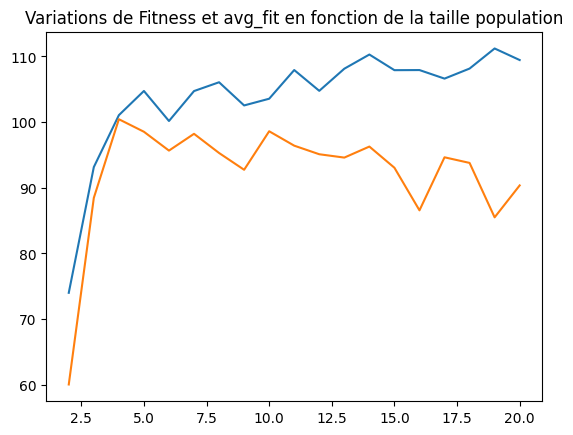

In [18]:
import matplotlib.pyplot as plt 
plt.plot(Results[:,0],Results[:,1])
plt.plot(Results[:,0],Results[:,2])
plt.title("Variations de Fitness et avg_fit en fonction de la taille population")
plt.show()

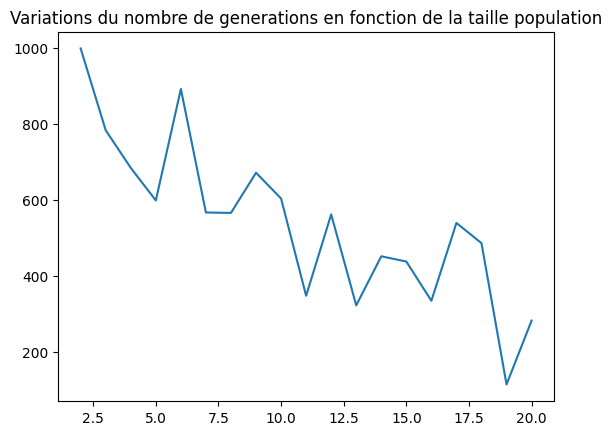

In [19]:
plt.plot(Results[:,0],Results[:,3])
plt.title("Variations du nombre de generations en fonction de la taille population")
plt.show()

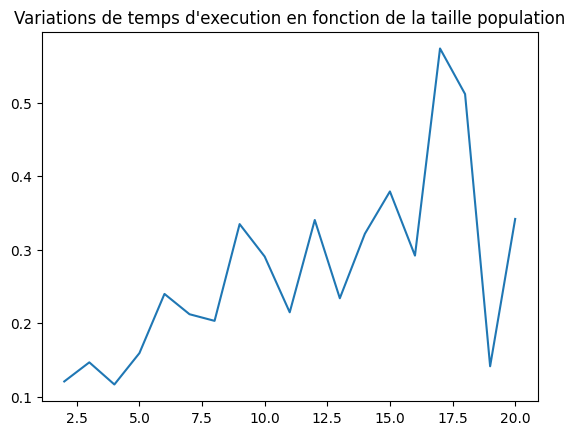

In [20]:
plt.plot(Results[:,0],Results[:,4])
plt.title("Variations de temps d'execution en fonction de la taille population")
plt.show()

# Question 5 (3pts)


L'influence de la taille du chromosome : si elle est trop faible, l'algorithme est susceptible de se bloquer dans un maximum local au lieu de converger vers le maximum global.

En suivant le même schema mais en fixant POPULATION_SIZE à la bonne valueur déduite de la question précedente (le cas écheant utiliser POPULATION_SIZE=6), et en variant 
Nmax sur [16, 32, 64, 128, 255, 1024, 2047]

Tracer les courbes des resultats (fitness, avg_fitness, generations, temps) en fonction de n_bits(Nmax)

Note: fitness et avg_fitness pouvent être ploté sur la même figure.

Commentez les courbes.




In [21]:
ResultsN = np.empty([7, 5])
current_populationN = []
fitnessRN= [ ]
avg_fitnessRN=  [ ]
generationsRN= [ ]
timeRN= [ ]
L =  [15,31, 63, 127, 255, 1023, 2047]
for j in range(0, 7):
    Nmax = L[j]
    for i in range(1,5):
        gen_i, x,  min_fit,  fitness, avg_fit, stdev_fit, t = run_genetic()
        fitnessRN.append(fitness)
        avg_fitnessRN.append(avg_fit)
        generationsRN.append(gen_i)
        timeRN.append(t)
        
    current_populationN.append(n_bits(Nmax))    
    current_populationN.append(mean(fitnessRN))    
    current_populationN.append(mean(avg_fitnessRN))
    current_populationN.append(mean(generationsRN))
    current_populationN.append(mean(timeRN))
    
    ResultsN[j] = current_populationN
    
    current_populationN.clear()
    fitnessRN.clear()
    avg_fitnessRN.clear()
    generationsRN.clear()
    timeR.clear()

GENERATION 00
Population: [1111, 1111, 1111, 1100, 0100, 1010, 1010, 0001, 0010, 0110, 0110, 1000, 0111, 1001, 1101, 1110, 0101, 0101, 1011, 0011]
  Min 46.2627019072883
  Max 78.89776767499974
  Avg 59.172567119233086
  Std 10.15650606349536
GENERATION 01
Population: [1111, 1111, 1111, 1100, 1100, 1100, 0100, 0001, 0110, 0110, 0110, 1000, 0111, 1001, 1101, 1110, 1110, 1110, 0101, 0011]
  Min 46.2627019072883
  Max 78.89776767499974
  Avg 59.579808203631536
  Std 10.074997144577965
GENERATION 02
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1100, 1100, 1100, 1100, 1100, 0100, 0100, 1010, 0001, 0010, 0110, 1101, 1110, 0000]
  Min 32.20223232500025
  Max 78.89776767499974
  Avg 64.9929653352948
  Std 12.066989506660223
GENERATION 03
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1100, 0100, 1010, 1010, 0110, 1000, 1101, 1101, 1110, 1110, 0101, 0011, 0000, 0000]
  Min 32.20223232500025
  Max 78.89776767499974
  Avg 60.02878334891466
  Std 15.261259189742626
GENERATION 04
Population: 

GENERATION 239
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 1110, 1110, 1110]
  Min 50.24408058607549
  Max 78.89776767499974
  Avg 73.41799691931557
  Std 11.288387797886323
GENERATION 240
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 0111, 0111, 1101, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 72.31964869324291
  Std 11.824079443490238
GENERATION 241
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 0111, 1101, 1101, 1110, 1011, 0011]
  Min 46.2627019072883
  Max 78.89776767499974
  Avg 69.0090230495716
  Std 13.972002658703792
GENERATION 242
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 0111, 0111, 1101, 1110, 1011, 0011]
  Min 46.2627019072883
  Max 78.89776767499974
  Avg 69.25521105041113
  Std 13.665755437899797
GENERATION 243
Populati

GENERATION 490
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1100, 1000, 0111, 0111, 0111, 1001, 1101, 1101, 1011, 1011, 1011, 0011, 0011]
  Min 46.2627019072883
  Max 78.89776767499974
  Avg 61.27424309421445
  Std 13.97279476039359
GENERATION 491
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0100, 0110, 0111, 0111, 1001, 1001, 1101, 1011, 1011, 0011, 0011]
  Min 46.2627019072883
  Max 78.89776767499974
  Avg 64.28051592208425
  Std 14.19545856031262
GENERATION 492
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1100, 0111, 1001, 1101, 1011, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 69.48214982401618
  Std 13.67593294991919
GENERATION 493
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1010, 1011, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 73.20365192645778
  Std 12.035066373840703
GENERATION 494
Population

GENERATION 766
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0110, 0110, 0111, 0111, 1101, 1110, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 69.97470919960851
  Std 12.708839278981415
GENERATION 767
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0110, 0111, 1110, 1011, 0011]
  Min 46.2627019072883
  Max 78.89776767499974
  Avg 71.99956571252041
  Std 12.485612165697775
GENERATION 768
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 1110, 1110, 0011]
  Min 46.2627019072883
  Max 78.89776767499974
  Avg 73.21892798537621
  Std 11.744457511602596
GENERATION 769
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 0111, 1101, 1110, 1110, 0011]
  Min 46.2627019072883
  Max 78.89776767499974
  Avg 70.6093045998456
  Std 13.11061023360579
GENERATION 770
Population

  Std 14.051365369397848
GENERATION 11
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1100, 1010, 1101, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 74.28284317722861
  Std 10.07030600274509
GENERATION 12
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 0111, 1101, 1110, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 72.06868203114223
  Std 12.250723100468237
GENERATION 13
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 0111, 1101, 1110, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 72.06868203114223
  Std 12.250723100468237
GENERATION 14
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1010, 0111, 1011, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 72.02193423411225
  Std 12.59388674717471
G

GENERATION 238
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 0111, 0111, 0111, 0111, 1101, 1101, 1110, 1110]
  Min 50.24408058607549
  Max 78.89776767499974
  Avg 67.2679991180095
  Std 13.300341067067208
GENERATION 239
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 0111, 0111, 1101, 1101, 1110, 1110, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 66.42131407963026
  Std 14.32091603866184
GENERATION 240
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1010, 0111, 0111, 0111, 0111, 1101, 1110, 1110, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 67.39362717806844
  Std 13.346707217569437
GENERATION 241
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0110, 0110, 0110, 0111, 0111, 1101, 1110, 1011, 1011, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 64.1125421492362
  Std 14.177582482318444
GENERATION 242
Populati

GENERATION 517
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1101, 1110, 1110, 1110, 0101]
  Min 49.78093460373039
  Max 78.89776767499974
  Avg 71.71596726491256
  Std 12.762799652270003
GENERATION 518
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 1101, 1101]
  Min 50.3396538112984
  Max 78.89776767499974
  Avg 74.86023859628406
  Std 9.903964106504752
GENERATION 519
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1100, 0110, 1101, 1110, 1110, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 71.24942316650584
  Std 12.469639551781693
GENERATION 520
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1100, 0111, 0111, 1101, 1101, 1101, 1110]
  Min 50.24408058607549
  Max 78.89776767499974
  Avg 70.11490737719285
  Std 12.648737932314253
GENERATION 521
Populat

  Avg 70.64077633795716
  Std 13.051033587779449
GENERATION 763
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0100, 0111, 0111, 0111, 1110]
  Min 50.24408058607549
  Max 78.89776767499974
  Avg 73.19021368755209
  Std 10.408126580756663
GENERATION 764
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 1110, 1110, 0101]
  Min 49.78093460373039
  Max 78.89776767499974
  Avg 73.39483962019831
  Std 11.338791994310842
GENERATION 765
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 77.2927074634646
  Std 7.178047481945573
GENERATION 766
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 1110, 1110, 1110]
  Min 50.24408058607549
  Max 78.89776767499974
  Avg 73.4179969193155

GENERATION 25
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 0111, 1101, 1101, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 72.07346069240339
  Std 12.241777252363635
GENERATION 26
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 0111, 1001, 1101, 1101, 1110, 0101, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 66.29208412112544
  Std 14.4429766490907
GENERATION 27
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 1001, 1001, 1101, 1101, 1101, 1101, 1110, 1110, 1011, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 61.74829716294984
  Std 14.507733098472034
GENERATION 28
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1010, 0111, 1101, 1101, 1101, 1101, 1110, 1110, 0101, 1011, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 61.98910109891609
  Std 14.497034710614397
GENERATION 29
Population: 

GENERATION 283
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0001, 0110, 0111, 0111, 1110, 1110]
  Min 50.24408058607549
  Max 78.89776767499974
  Avg 71.71988475259562
  Std 11.454195684374495
GENERATION 284
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 0111, 1110, 1110, 1110, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 70.63121901543488
  Std 13.066706372614078
GENERATION 285
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1101, 1110]
  Min 50.24408058607549
  Max 78.89776767499974
  Avg 76.03717762736846
  Std 8.804724039520138
GENERATION 286
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1001, 1110, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 74.57223275728526
  Std 10.614482773353886
GENERATION 287
Popula

  Std 14.095699152797545
GENERATION 528
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 0111, 0111, 0111, 1101, 1110, 1011, 1011, 1011, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 63.285005800310564
  Std 14.77586986748757
GENERATION 529
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1101, 1110, 1011, 1011, 1011, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 68.01187656969272
  Std 15.250511144870522
GENERATION 530
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 1001, 1001, 1101, 1011, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 68.89738295139746
  Std 14.127576221533218
GENERATION 531
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1001, 1001, 1011, 1011, 1011, 1011, 1011, 0011]
  Min 46.2627019072883
  Max 78.89776767499974
  Avg 66.6651326254722
  Std 15.4774200044422

GENERATION 821
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 1101, 1101, 1101, 1101, 1110]
  Min 50.24408058607549
  Max 78.89776767499974
  Avg 70.57174285546772
  Std 13.089622545822982
GENERATION 822
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1100, 1101, 1101, 1101, 1101, 0101, 0101, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 67.96637790448298
  Std 14.134917343130388
GENERATION 823
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 77.2927074634646
  Std 7.178047481945573
GENERATION 824
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111]
  Min 78.89776767499974
  Max 78.89776767499974
  Avg 78.89776767499974
  Std 0.0
GENERATION 825
Population: [1111, 111

GENERATION 14
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0100, 1101, 1101, 1101, 1101, 1101, 1101, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 67.99555674838936
  Std 14.066969442872942
GENERATION 15
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0001, 1000, 0111, 1001, 1101, 1101, 1110]
  Min 50.24408058607549
  Max 78.89776767499974
  Avg 70.08461240189655
  Std 12.519462869131155
GENERATION 16
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1000, 0111, 0111, 1001, 1001, 1001, 1110, 1110, 1110]
  Min 50.24408058607549
  Max 78.89776767499974
  Avg 67.21984909661626
  Std 13.327245438857698
GENERATION 17
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 1001, 1101, 1110, 1110]
  Min 50.24408058607549
  Max 78.89776767499974
  Avg 72.1349852288436
  Std 12.06315221202478
GENERATION 18
Population: 

GENERATION 211
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 1101, 1110, 1110, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 70.21265515750642
  Std 13.704719037587987
GENERATION 212
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1010, 1101, 1110, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 73.55318230189681
  Std 11.250276913316947
GENERATION 213
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1010, 1110, 1110, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 73.54840364063566
  Std 11.260671530416088
GENERATION 214
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1010, 0111, 1110, 1011, 1011, 1011, 1011, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 65.77406924506059
  Std 15.264202891118323
GENERATION 215
Popul

  Min 50.24408058607549
  Max 78.89776767499974
  Avg 71.74868188655212
  Std 12.704281536314078
GENERATION 426
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1101, 1101, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 74.43689607709446
  Std 10.915058501435926
GENERATION 427
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 0111, 0111, 1110]
  Min 50.24408058607549
  Max 78.89776767499974
  Avg 75.10164793586246
  Std 9.318879099736472
GENERATION 428
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1110, 1110, 1110, 1110, 1110]
  Min 50.24408058607549
  Max 78.89776767499974
  Avg 71.73434590276868
  Std 12.729734543088355
GENERATION 429
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1110, 1110, 1011]
  Min 46.796563444296

  Max 78.89776767499974
  Avg 64.6074901191475
  Std 14.017174422282418
GENERATION 598
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1010, 1101, 1101, 1110, 1110, 1110, 1110, 1110, 1110, 1011, 0011]
  Min 46.2627019072883
  Max 78.89776767499974
  Avg 63.3301015480951
  Std 14.716327254549752
GENERATION 599
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1101, 1101, 1101, 1101, 1101, 1110, 1110, 1110, 1110, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 62.81738136821926
  Std 14.958473435758096
GENERATION 600
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1001, 1101, 1101, 1110, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 71.71642137091513
  Std 12.803329610071447
GENERATION 601
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1101, 1101, 1101, 1110, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974

GENERATION 831
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1100, 0111, 0111, 0111, 1110, 1110, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 68.574101986886
  Std 13.46520971177837
GENERATION 832
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1010, 0111, 0111, 1101, 1110, 1011, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 67.97962649413543
  Std 14.086427941455462
GENERATION 833
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1010, 1110, 1011, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 73.37602778354672
  Std 11.65564456692562
GENERATION 834
Population: [1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1111, 1010, 1010, 1001, 1011]
  Min 46.79656344429675
  Max 78.89776767499974
  Avg 74.24704688385847
  Std 9.94534109159039
GENERATION 835
Population:

GENERATION 49
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11000, 11110]
  Min 1.0681348575490484
  Max 97.40122742508181
  Avg 91.45828858000736
  Std 21.862128677610976
GENERATION 50
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11000, 10100, 01100, 11101, 11110]
  Min 1.0681348575490484
  Max 97.40122742508181
  Avg 84.97568922803565
  Std 25.586450411400985
GENERATION 51
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11000, 10101, 01100, 01100, 01100, 11101, 11110, 11110]
  Min 1.0681348575490484
  Max 97.40122742508181
  Avg 76.04392723875115
  Std 31.672673710423457
GENERATION 52
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 10100, 01100, 01100, 01100, 11101, 11110]
  Min 1.0681348575490484
  Max 97.4012

GENERATION 247
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11000, 11000, 11000, 01000, 10101]
  Min 58.55938577715054
  Max 97.40122742508181
  Avg 90.15952791393019
  Std 13.490314963445735
GENERATION 248
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11000, 11000, 11000, 01000, 01000, 01100]
  Min 57.212131134617465
  Max 97.40122742508181
  Avg 88.17141040314193
  Std 15.191811359750497
GENERATION 249
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11000, 11000, 11000, 11000, 11000, 01000, 01100, 01100, 11110]
  Min 1.0681348575490484
  Max 97.40122742508181
  Avg 81.01348730550805
  Std 24.226978178800355
GENERATION 250
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11000, 11000, 10100, 01100, 11101, 11110, 11110]
  Min 1.0681348575490484
  Max 97.4

GENERATION 473
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11000, 10100, 01000, 01100, 11110]
  Min 1.0681348575490484
  Max 97.40122742508181
  Avg 85.68218463628739
  Std 24.59628267859938
GENERATION 474
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11000, 11000, 11000, 10100, 01100, 11101, 11110, 11110, 11110]
  Min 1.0681348575490484
  Max 97.40122742508181
  Avg 73.08981153788673
  Std 35.0041997074668
GENERATION 475
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11000, 11000, 10100]
  Min 60.48334041437888
  Max 97.40122742508181
  Avg 93.30276464115103
  Std 10.366432028264185
GENERATION 476
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11000, 11000, 11000, 11000, 11000, 11000, 10101, 01100]
  Min 57.212131134617465
  Max 97.4012

GENERATION 660
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11000, 10100, 11101]
  Min 44.85622368681483
  Max 97.40122742508181
  Avg 91.8017986709355
  Std 14.517217013361021
GENERATION 661
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11000, 10100, 10100, 11101]
  Min 44.85622368681483
  Max 97.40122742508181
  Avg 89.95590432040035
  Std 16.035467125251685
GENERATION 662
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 10100, 10100, 10100, 10100]
  Min 60.48334041437888
  Max 97.40122742508181
  Avg 90.01765002294123
  Std 15.150781151082764
GENERATION 663
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 10100, 10100, 01100, 01100, 01100, 01100]
  Min 57.212131134617465
  Max 97.4012

  Std 24.183619990317823
GENERATION 843
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 10100, 01100, 11110, 11110]
  Min 1.0681348575490484
  Max 97.40122742508181
  Avg 83.91256900327018
  Std 30.69317185236955
GENERATION 844
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 01100, 01100, 01100, 11101, 11110]
  Min 1.0681348575490484
  Max 97.40122742508181
  Avg 83.92895816622217
  Std 26.41420246337553
GENERATION 845
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 01100, 11101, 11110, 11110]
  Min 1.0681348575490484
  Max 97.40122742508181
  Avg 83.13121316689197
  Std 31.50906652074802
GENERATION 846
Population: [11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 11100, 01100, 11101]
  Min 44.856

GENERATION 36
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 11001, 00011]
  Min 13.698772574918202
  Max 110.03186514245095
  Avg 100.1231777440001
  Std 24.379711308926446
GENERATION 37
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 11001]
  Min 57.47601959816633
  Max 110.03186514245095
  Avg 106.17195261880673
  Std 12.714240933395311
GENERATION 38
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 00101, 11001, 10001, 10001, 10001]
  Min 55.92999708423314
  Max 110.03186514245095
  Avg 95.59243191721407
  Std 21.9987475812349
GENERATION 39
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 00101, 00101, 10001, 00011]
  Min 13.698772574918202
  Max 110.031

GENERATION 227
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 00101, 10001, 10001]
  Min 55.92999708423314
  Max 110.03186514245095
  Avg 100.9253175973392
  Std 17.795896116129285
GENERATION 228
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 10001, 10001, 00011]
  Min 13.698772574918202
  Max 110.03186514245095
  Avg 97.34078321539255
  Std 26.285190957874324
GENERATION 229
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 00101, 10101, 00000]
  Min 32.20223232500025
  Max 110.03186514245095
  Avg 99.87039879402342
  Std 21.1056294205339
GENERATION 230
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 10101, 00100]
  Min 53.05363219227813
  Max 110.0

GENERATION 447
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 01001, 10001, 10001, 10001, 10001, 00000]
  Min 32.20223232500025
  Max 110.03186514245095
  Avg 93.14179604559641
  Std 27.10394979255655
GENERATION 448
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 10000]
  Min 55.59958747003111
  Max 110.03186514245095
  Avg 107.31025125882996
  Std 12.17142730456748
GENERATION 449
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 10001, 00000]
  Min 32.20223232500025
  Max 110.03186514245095
  Avg 102.20316985223754
  Std 20.98363095569709
GENERATION 450
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 01001, 10001, 00011]
  Min 13.698772574918202
  Max 110.

GENERATION 631
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 01001, 10001, 00000, 00011]
  Min 13.698772574918202
  Max 110.03186514245095
  Avg 93.97618113309245
  Std 29.218929766544267
GENERATION 632
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 10001, 10001, 10001, 00000, 00000]
  Min 32.20223232500025
  Max 110.03186514245095
  Avg 92.90150140554321
  Std 28.68540868460611
GENERATION 633
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 00000, 00000]
  Min 32.20223232500025
  Max 110.03186514245095
  Avg 99.7846613678459
  Std 24.310812004844525
GENERATION 634
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 00101, 00000, 00011]
  Min 13.698772574918202
  Max 110.

  Std 21.487618651347013
GENERATION 836
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 01001, 00000]
  Min 32.20223232500025
  Max 110.03186514245095
  Avg 102.73004941080997
  Std 19.86297246300337
GENERATION 837
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 01001, 01001, 00000, 00000]
  Min 32.20223232500025
  Max 110.03186514245095
  Avg 96.66035392559898
  Std 26.09889875328448
GENERATION 838
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101]
  Min 85.38946021385111
  Max 110.03186514245095
  Avg 107.56762464959097
  Std 7.5847722000179845
GENERATION 839
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 01101, 10001, 00000, 00011]
  Min 13.

GENERATION 53
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 01001, 01001, 10001, 00000]
  Min 32.20223232500025
  Max 110.03186514245095
  Avg 99.07886240999062
  Std 23.37428967237801
GENERATION 54
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 01001]
  Min 66.46758825568185
  Max 110.03186514245095
  Avg 107.8536512981125
  Std 9.741268450943863
GENERATION 55
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 10001, 10001, 10001]
  Min 55.92999708423314
  Max 110.03186514245095
  Avg 100.68446468728828
  Std 20.05362101105828
GENERATION 56
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00000, 00011, 00011, 00011]
  Min 13.698772574918202
  Max 110.03186

GENERATION 265
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 10101, 10001]
  Min 55.92999708423314
  Max 110.03186514245095
  Avg 102.28890727841505
  Std 17.155414322637164
GENERATION 266
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 00101, 01001, 10001, 00000]
  Min 32.20223232500025
  Max 110.03186514245095
  Avg 97.56071551503909
  Std 22.470405090818833
GENERATION 267
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 00101, 00101, 01001, 00000, 00011]
  Min 13.698772574918202
  Max 110.03186514245095
  Avg 94.21703404314336
  Std 27.779372807003202
GENERATION 268
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 01001, 10101, 10001, 00000, 00000, 00011]
  Min 13.698772574918202
  Max 1

GENERATION 470
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 01001, 10001, 00011]
  Min 13.698772574918202
  Max 110.03186514245095
  Avg 100.33190326682497
  Std 25.36381370119413
GENERATION 471
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 01001, 01001, 01001, 01001, 01101]
  Min 56.94662236079314
  Max 110.03186514245095
  Avg 98.66474762601425
  Std 20.294153515374617
GENERATION 472
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 01001, 01001, 11001]
  Min 57.47601959816633
  Max 110.03186514245095
  Avg 103.04764517655981
  Std 17.1406300497874
GENERATION 473
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 01001, 11011, 00000, 00011]
  Min 13.698772574918202
  Max 110

GENERATION 687
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 10001, 00100, 00100, 00000, 00011]
  Min 13.698772574918202
  Max 110.03186514245095
  Avg 91.68869192884361
  Std 31.31787341165308
GENERATION 688
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 00101, 10101, 10001, 10001, 00000]
  Min 32.20223232500025
  Max 110.03186514245095
  Avg 94.46021198820164
  Std 24.637486259077573
GENERATION 689
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 00101, 00101, 00101, 10001, 00011]
  Min 13.698772574918202
  Max 110.03186514245095
  Avg 96.34951587901347
  Std 24.601223575694984
GENERATION 690
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 10101, 10001, 10001, 10001]
  Min 55.92999708423314
  Max 110

GENERATION 901
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 10001, 10001, 10001, 00011]
  Min 13.698772574918202
  Max 110.03186514245095
  Avg 94.63568981248166
  Std 27.658398411692456
GENERATION 902
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 00111, 00000, 00000, 00000, 00011]
  Min 13.698772574918202
  Max 110.03186514245095
  Avg 87.3861546869179
  Std 35.43554984823903
GENERATION 903
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 01101, 00011]
  Min 13.698772574918202
  Max 110.03186514245095
  Avg 100.09670788213144
  Std 24.428689960347594
GENERATION 904
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 01001, 01001, 01101, 10001, 00111, 00000]
  Min 32.20223232500025
  Max 11

GENERATION 106
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 01001, 01001]
  Min 66.46758825568185
  Max 110.03186514245095
  Avg 104.44331720734405
  Std 14.101704267177107
GENERATION 107
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 01001, 10001, 10001, 10001]
  Min 55.92999708423314
  Max 110.03186514245095
  Avg 98.50625084294984
  Std 21.311394313200157
GENERATION 108
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 11000, 01001, 10001, 00011]
  Min 13.698772574918202
  Max 110.03186514245095
  Avg 96.10984667139871
  Std 25.832389223629814
GENERATION 109
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 01001, 10001]
  Min 55.92999708423314
  Max 11

  Min 32.20223232500025
  Max 110.03186514245095
  Avg 96.3285952686091
  Std 22.426148354694522
GENERATION 338
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 00101, 01001, 10001, 00000]
  Min 32.20223232500025
  Max 110.03186514245095
  Avg 97.56071551503909
  Std 22.470405090818833
GENERATION 339
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 10001, 00000, 00000]
  Min 32.20223232500025
  Max 110.03186514245095
  Avg 98.311688211365
  Std 26.058550259724434
GENERATION 340
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 00101, 01001, 01001, 10001]
  Min 55.92999708423314
  Max 110.03186514245095
  Avg 99.27398331157318
  Std 18.10758564652078
GENERATION 341
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 000

GENERATION 579
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 10001, 10001]
  Min 55.92999708423314
  Max 110.03186514245095
  Avg 104.62167833662917
  Std 16.652203630529623
GENERATION 580
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 01001, 10001]
  Min 55.92999708423314
  Max 110.03186514245095
  Avg 103.91643764877162
  Std 15.701386797805963
GENERATION 581
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 01001, 01001, 01101, 10001, 00011]
  Min 13.698772574918202
  Max 110.03186514245095
  Avg 94.26730703697363
  Std 27.58492586920487
GENERATION 582
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 01001, 01011, 00111, 00011, 00011]
  Min 13.698772574918202
  Max 1

GENERATION 774
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 00101, 10101, 10101, 10001, 00100, 00111, 00000]
  Min 32.20223232500025
  Max 110.03186514245095
  Avg 88.05239936366004
  Std 28.22573920505795
GENERATION 775
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 00101, 01001, 01001, 10001, 10111, 00000, 00011]
  Min 13.698772574918202
  Max 110.03186514245095
  Avg 87.66994719260897
  Std 30.118496054195123
GENERATION 776
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 01001, 01001, 10001, 00000]
  Min 32.20223232500025
  Max 110.03186514245095
  Avg 97.84674216356062
  Std 23.415986434905218
GENERATION 777
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 01001, 01001, 01001, 01001, 10001, 10001]
  Min 55.92999708423314
  Max 110.

GENERATION 975
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 00101, 10101]
  Min 58.55938577715054
  Max 110.03186514245095
  Avg 104.99400068132594
  Std 13.290896779311838
GENERATION 976
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00101, 01001, 10001, 00000]
  Min 32.20223232500025
  Max 110.03186514245095
  Avg 100.02495600789908
  Std 22.345132055146316
GENERATION 977
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 01001, 10001]
  Min 55.92999708423314
  Max 110.03186514245095
  Avg 105.1485578952016
  Std 15.12739681685123
GENERATION 978
Population: [00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 00001, 01001, 10101, 00000, 00011]
  Min 13.698772574918202
  Max 11

GENERATION 189
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 001010, 001010, 001010, 001010, 110010, 010010, 001110]
  Min 35.4892924746227
  Max 109.70265927184342
  Avg 96.74184122751993
  Std 20.31458185610472
GENERATION 190
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 001010, 001010, 010010, 010011]
  Min 62.10148597816981
  Max 109.70265927184342
  Avg 102.8007714224605
  Std 14.971344375416509
GENERATION 191
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 001010, 001010, 010010]
  Min 67.46656321053823
  Max 109.70265927184342
  Avg 104.82083824859767
  Std 11.518235962301366
GENERATION 192
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000

  Std 17.32962229383978
GENERATION 371
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 001010, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 104.62262573368427
  Std 17.87530362491275
GENERATION 372
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 001010, 010010]
  Min 67.46656321053823
  Max 109.70265927184342
  Avg 106.38584227796117
  Std 10.62441097584312
GENERATION 373
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000110]
  Min 13.98775023355337
  Max 109.70265927184342
  Avg 104.91691381992891
  Std 21.402504306982557
GENERATION 374
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 0

GENERATION 562
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 010010, 010010, 100010, 100010, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 96.2255886504856
  Std 24.843707028559805
GENERATION 563
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 010010, 010010, 010010, 000000, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 95.61720216796333
  Std 26.553118311157693
GENERATION 564
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000001, 010010, 010010, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 100.20094363311831
  Std 21.22051942659407
GENERATION 565
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000

  Std 16.413458903443892
GENERATION 741
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 000011, 001010, 010010, 010010, 100010, 100010]
  Min 55.91826259299209
  Max 109.70265927184342
  Avg 97.4556304528247
  Std 19.387565637280527
GENERATION 742
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 001010, 110010, 010010, 101010, 011010, 100110]
  Min 53.18886442806371
  Max 109.70265927184342
  Avg 95.8508385619817
  Std 21.061796323109476
GENERATION 743
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 001010, 000001, 101010, 100010, 110110, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 93.69920074891269
  Std 26.19964899903481
GENERATION 744
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 0000

Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 001010, 001011, 100010, 100010]
  Min 55.91826259299209
  Max 109.70265927184342
  Avg 101.11925180717586
  Std 17.800764092174393
GENERATION 951
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 001010, 001010, 001010]
  Min 85.60241545550372
  Max 109.70265927184342
  Avg 105.72763086084595
  Std 8.820687072487932
GENERATION 952
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 001010, 001010, 011010, 100010, 000000, 000110]
  Min 13.98775023355337
  Max 109.70265927184342
  Avg 93.3308019536742
  Std 29.549251502893103
GENERATION 953
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 0

GENERATION 179
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 000011, 000011, 001010, 001010, 010010, 010011, 100011, 100110]
  Min 53.18886442806371
  Max 109.70265927184342
  Avg 95.47966760574523
  Std 19.900702497478015
GENERATION 180
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 000011, 001010, 001010, 001010, 010010, 010010, 100010, 100111]
  Min 54.77523879527534
  Max 109.70265927184342
  Avg 94.98845488130489
  Std 19.327125885002182
GENERATION 181
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 100010, 100011, 001000]
  Min 49.27553629807404
  Max 109.70265927184342
  Avg 100.57664473032565
  Std 20.375916893448228
GENERATION 182
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 0

GENERATION 361
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 100010, 100010]
  Min 55.91826259299209
  Max 109.70265927184342
  Avg 103.60423592686524
  Std 16.456293957313356
GENERATION 362
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 001010, 010011, 000000, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 98.00755388311191
  Std 25.3144993331621
GENERATION 363
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 010010, 100010, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 101.02661328749343
  Std 21.977847501398333
GENERATION 364
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 110010, 000100, 10

GENERATION 554
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 000011, 000011, 000011, 000011, 000001, 010010, 010011, 001101]
  Min 40.56342671981124
  Max 109.70265927184342
  Avg 97.83080662141481
  Std 19.414451319273816
GENERATION 555
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 000011, 000011, 000011, 000011, 001010, 010010, 010010, 010001, 000101]
  Min 31.93788776969588
  Max 109.70265927184342
  Avg 95.66579184152275
  Std 21.218488257399873
GENERATION 556
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 000011, 001011, 001011, 010010, 010010, 010001, 010011, 010011, 000000, 000111, 000110]
  Min 13.98775023355337
  Max 109.70265927184342
  Avg 80.79302016287639
  Std 31.118737306406477
GENERATION 557
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 000011, 00

GENERATION 766
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 001010, 100010, 000000, 000110, 000110]
  Min 13.98775023355337
  Max 109.70265927184342
  Avg 92.3619149959127
  Std 33.86393722143601
GENERATION 767
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 001010, 001010, 000110]
  Min 13.98775023355337
  Max 109.70265927184342
  Avg 102.50688943829495
  Std 22.10906606882065
GENERATION 768
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 001010, 001010, 000110, 000110]
  Min 13.98775023355337
  Max 109.70265927184342
  Avg 97.36115214783392
  Std 29.459975360084396
GENERATION 769
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 0010

GENERATION 992
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 000011, 000011, 000011, 000011, 000011, 000011, 000011, 001010, 001011, 101010, 100110]
  Min 53.18886442806371
  Max 109.70265927184342
  Avg 98.01289549217464
  Std 16.18439848180363
GENERATION 993
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 000011, 000011, 000011, 000011, 000011, 000011, 000011, 000011, 100011, 100011, 000110]
  Min 13.98775023355337
  Max 109.70265927184342
  Avg 95.56609383232981
  Std 24.652415195368572
GENERATION 994
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 000011, 000011, 000011, 000011, 000011, 000011, 100011, 110011]
  Min 53.61448377764136
  Max 109.70265927184342
  Avg 100.96286906842094
  Std 16.207429141142867
GENERATION 995
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 00

GENERATION 210
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 001010, 010010, 010010, 100010, 010000, 000110]
  Min 13.98775023355337
  Max 109.70265927184342
  Avg 94.10619984628583
  Std 27.374917602189996
GENERATION 211
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 001010, 000100, 000100, 010010, 100010, 100010, 100010, 010000]
  Min 55.845212416783255
  Max 109.70265927184342
  Avg 91.5355565643747
  Std 23.717596231170393
GENERATION 212
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000100, 010010, 010010, 010011, 100010, 010000, 010100, 000000, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 85.16451296621977
  Std 29.299999794972983
GENERATION 213
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 010010, 01

  Avg 95.4828025497784
  Std 24.10568647348003
GENERATION 382
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 001010, 001010, 001010, 001010, 001011, 010010, 010010, 010010]
  Min 67.46656321053823
  Max 109.70265927184342
  Avg 96.90723233196077
  Std 16.97720436261323
GENERATION 383
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 001011, 001011, 010010, 010010, 010010, 011010, 010000]
  Min 55.845212416783255
  Max 109.70265927184342
  Avg 94.42260684317424
  Std 21.16950014323363
GENERATION 384
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 001010, 010010, 010011, 011000, 000000, 000000, 000000, 000110]
  Min 13.98775023355337
  Max 109.70265927184342
  Avg 84.56608737743406
  Std 34.085779041160706
GENERATION 385
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 0000

GENERATION 587
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 000011, 100010, 000000, 000110]
  Min 13.98775023355337
  Max 109.70265927184342
  Avg 96.91270528445811
  Std 28.093934027213106
GENERATION 588
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 100010, 100010, 100010, 100011, 000110]
  Min 13.98775023355337
  Max 109.70265927184342
  Avg 93.43381575921448
  Std 28.613567367812305
GENERATION 589
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 000011, 000011, 100010, 100010, 100010, 100000]
  Min 55.556449741731065
  Max 109.70265927184342
  Avg 97.1277301007775
  Std 21.40672220944755
GENERATION 590
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 000011, 000011, 000011, 001

Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 010010, 100010, 000110]
  Min 13.98775023355337
  Max 109.70265927184342
  Avg 99.75589734437457
  Std 25.0379387304327
GENERATION 831
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 001010, 010010, 000110]
  Min 13.98775023355337
  Max 109.70265927184342
  Avg 100.88011314895363
  Std 23.02513760397843
GENERATION 832
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 001010, 001010]
  Min 85.60241545550372
  Max 109.70265927184342
  Avg 107.29263489020944
  Std 7.4178985306615886
GENERATION 833
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 001010, 001010, 00

GENERATION 10
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 000011, 100010, 000000, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 97.82342938903045
  Std 25.433527629501615
GENERATION 11
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 000011, 001010, 100010, 100010, 000000, 000110]
  Min 13.98775023355337
  Max 109.70265927184342
  Avg 93.01847325969857
  Std 29.176516993645638
GENERATION 12
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 000011, 000011, 000011, 000011, 001010, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 102.10268286385863
  Std 17.463960857189928
GENERATION 13
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 000011, 00001

GENERATION 189
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 100010, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 102.41843441346565
  Std 20.444474438623313
GENERATION 190
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 010010, 100010, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 99.94663777185387
  Std 21.685405171960543
GENERATION 191
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000001, 010010, 010010, 010010, 100011, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 95.03369210971285
  Std 23.841466273576085
GENERATION 192
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 0

  Avg 85.15317605377392
  Std 28.378218712336942
GENERATION 390
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 001010, 001011, 000100, 010010, 011010, 011010, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 92.88230394493213
  Std 24.08538320239537
GENERATION 391
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 001010, 001010, 001010, 011100, 010100, 010110, 000101]
  Min 31.93788776969588
  Max 109.70265927184342
  Avg 93.36270923103388
  Std 25.23651709881387
GENERATION 392
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 001010, 001010, 000000, 000000, 000101]
  Min 31.93788776969588
  Max 109.70265927184342
  Avg 95.29436178187123
  Std 28.21113298627677
GENERATION 393
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 0000

GENERATION 525
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 000011, 001010, 000001, 010010, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 100.02776072972702
  Std 19.79091246217628
GENERATION 526
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000001, 010010, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 101.95275659763705
  Std 19.77276231450644
GENERATION 527
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 105.46764608595474
  Std 17.3196679997018
GENERATION 528
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000

GENERATION 675
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 010010, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 103.35584128288949
  Std 19.244137405662876
GENERATION 676
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 001010, 010010]
  Min 67.46656321053823
  Max 109.70265927184342
  Avg 106.38584227796117
  Std 10.62441097584312
GENERATION 677
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 001010, 001011, 010010, 010010, 011010, 100010, 100010]
  Min 55.91826259299209
  Max 109.70265927184342
  Avg 94.64378773625583
  Std 22.008630717342694
GENERATION 678
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 001010, 001010, 001010, 010010, 0

  Std 13.955195050675893
GENERATION 853
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 000011, 001010, 001010, 001010, 001010, 000001, 001011, 001011]
  Min 76.90338392346492
  Max 109.70265927184342
  Avg 99.47961461139217
  Std 13.130504950498015
GENERATION 854
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000011, 001010, 001010, 001010, 000001, 001011, 001001, 100010, 000000, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 90.52201104706823
  Std 25.53936044711654
GENERATION 855
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 001010, 001010, 001010, 001011, 100010, 100010, 000000, 000000]
  Min 32.20223232500025
  Max 109.70265927184342
  Avg 91.31917656940409
  Std 27.00620201681176
GENERATION 856
Population: [000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000010, 000

  Std 17.388380175892852
GENERATION 40
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0010101, 0010001, 0000001, 0000001]
  Min 57.71124863908515
  Max 110.60353602046645
  Avg 101.53862714034136
  Std 19.266663398266047
GENERATION 41
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000111, 0010101, 0010001, 0000001, 0001101]
  Min 14.831203950055833
  Max 110.60353602046645
  Avg 98.2420654540601
  Std 25.6484728118652
GENERATION 42
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000100, 0100101, 0100101, 0000001]
  Min 57.71124863908515
  Max 110.60353602046645
  Avg 103.35451848549278
  Std 17.317825470714617
GENERATION 43
Population: [0000101, 0000101, 0000101, 000010

GENERATION 246
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000111, 0010101, 0010101, 0010101, 0100111, 0001101]
  Min 14.831203950055833
  Max 110.60353602046645
  Avg 98.17158629110881
  Std 24.387902407570294
GENERATION 247
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000111, 0000111, 0000111, 0000111, 0100101, 0001101]
  Min 14.831203950055833
  Max 110.60353602046645
  Avg 99.19829884889567
  Std 23.48180211332778
GENERATION 248
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000111, 0000111, 1100101, 0100111, 1000101]
  Min 55.94189420926363
  Max 110.60353602046645
  Avg 101.04738160826024
  Std 18.431339343604613
GENERATION 249
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101

GENERATION 470
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000001, 0000001, 1000101, 0001110]
  Min 21.70794705867663
  Max 110.60353602046645
  Avg 98.02887526287097
  Std 26.482746488118384
GENERATION 471
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0010101, 1000101, 1000101, 1000100, 1000100, 1000100]
  Min 55.867477356685825
  Max 110.60353602046645
  Avg 95.5443472048788
  Std 24.209381184985386
GENERATION 472
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0010101, 0100100, 0100101, 1000100, 1000100]
  Min 55.867477356685825
  Max 110.60353602046645
  Avg 99.38219217532294
  Std 20.510905006242666
GENERATION 473
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101,

GENERATION 682
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000111, 0010100, 0100101, 0000001, 1000101]
  Min 55.94189420926363
  Max 110.60353602046645
  Avg 100.54365395257973
  Std 18.987658738191477
GENERATION 683
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000100, 0000100, 0000111, 0010101, 0010101, 0100101, 0100101, 0000001]
  Min 57.71124863908515
  Max 110.60353602046645
  Avg 99.54429784467018
  Std 18.063887021993494
GENERATION 684
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000100, 0000100, 0000111, 0010101, 0110101, 1000101]
  Min 55.94189420926363
  Max 110.60353602046645
  Avg 102.55322064016406
  Std 17.391413040836763
GENERATION 685
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101

GENERATION 884
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000100, 0000100, 0000100, 0000100, 0000100, 0000100, 0010100, 0100101, 0000001, 1000101, 1000100]
  Min 55.867477356685825
  Max 110.60353602046645
  Avg 98.58291378839347
  Std 21.156393740857478
GENERATION 885
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000100, 0000100, 0000100, 0000110, 0010100, 1000101, 1000100, 1000001]
  Min 55.57055534988858
  Max 110.60353602046645
  Avg 100.4811997115724
  Std 20.0728370362693
GENERATION 886
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000100, 0000100, 0000100, 0000100, 0000110, 0010100, 0010101, 0000001, 1000100, 1000111, 1000001, 0001101]
  Min 14.831203950055833
  Max 110.60353602046645
  Avg 91.65162790071392
  Std 28.310948282517696
GENERATION 887
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 

GENERATION 27
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000001, 0000001, 1000101]
  Min 55.94189420926363
  Max 110.60353602046645
  Avg 102.58122519176818
  Std 19.595829032193908
GENERATION 28
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0010101, 0010101, 1000101, 1000101]
  Min 55.94189420926363
  Max 110.60353602046645
  Avg 102.47971065035335
  Std 17.871606409118325
GENERATION 29
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0010101, 0010101, 0010101, 0100101, 0001101]
  Min 14.831203950055833
  Max 110.60353602046645
  Avg 99.6069039111102
  Std 23.893224313112416
GENERATION 30
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 00

GENERATION 179
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000111]
  Min 88.62805179194777
  Max 110.60353602046645
  Avg 109.3971913282328
  Std 4.899682258315103
GENERATION 180
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000111, 0000111, 0000111, 0000111, 0100101]
  Min 66.17306157353626
  Max 110.60353602046645
  Avg 103.87934497160848
  Std 12.57351867246191
GENERATION 181
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000100, 0000110, 0000111, 0100101]
  Min 66.17306157353626
  Max 110.60353602046645
  Avg 106.74432350956309
  Std 10.808403750266045
GENERATION 182
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 

GENERATION 373
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0010101, 0000001]
  Min 57.71124863908515
  Max 110.60353602046645
  Avg 106.57630581649713
  Std 12.938510128379416
GENERATION 374
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0010101, 0100101, 0001101]
  Min 14.831203950055833
  Max 110.60353602046645
  Avg 102.21077985969914
  Std 23.446594378091575
GENERATION 375
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000111, 0100100, 0000001, 0000001]
  Min 57.71124863908515
  Max 110.60353602046645
  Avg 101.964364168576
  Std 18.39010630600963
GENERATION 376
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101,

GENERATION 554
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000111, 0000111, 0000111, 0010101, 0010111, 0100101, 0001101]
  Min 14.831203950055833
  Max 110.60353602046645
  Avg 96.91339305113584
  Std 24.3246148094901
GENERATION 555
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000110, 0000111, 0000111, 0000111, 0000111, 0000111, 0010101]
  Min 84.02692413053836
  Max 110.60353602046645
  Avg 103.40327551292104
  Std 10.615458150809374
GENERATION 556
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000110, 0000111, 0000111, 1000101, 1000111]
  Min 55.66739414189129
  Max 110.60353602046645
  Avg 102.54853955720635
  Std 17.36766429705005
GENERATION 557
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 

GENERATION 725
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000100, 0000100, 0000110, 0000111, 0010101]
  Min 84.02692413053836
  Max 110.60353602046645
  Avg 107.58323139700933
  Std 7.498920081781387
GENERATION 726
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000111, 0000111, 0100101, 0100110, 0000000]
  Min 32.20223232500025
  Max 110.60353602046645
  Avg 99.83962245021567
  Std 21.78753271864809
GENERATION 727
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000111, 0100100, 0100101, 0100101, 0100101, 0000000]
  Min 32.20223232500025
  Max 110.60353602046645
  Avg 96.77652703570901
  Std 23.582073515778678
GENERATION 728
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0

GENERATION 949
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000111, 0000111, 0010101, 1000101]
  Min 55.94189420926363
  Max 110.60353602046645
  Avg 104.23650443175032
  Std 14.237806705414005
GENERATION 950
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000111, 0100101, 0000001, 1000101, 1000001]
  Min 55.57055534988858
  Max 110.60353602046645
  Avg 99.04632211272818
  Std 21.27766000881047
GENERATION 951
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000111, 0000111, 0100101, 0000001, 1000001, 0001101]
  Min 14.831203950055833
  Max 110.60353602046645
  Avg 95.94579862874572
  Std 26.79615577476509
GENERATION 952
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 

GENERATION 151
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000100, 0000100, 0000111, 0010100, 0100100, 0100100]
  Min 67.73156759009312
  Max 110.60353602046645
  Avg 103.7481068107104
  Std 14.240321330914961
GENERATION 152
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000100, 0000100, 0000111, 0000111, 0100100, 0000000]
  Min 32.20223232500025
  Max 110.60353602046645
  Avg 102.12718302970715
  Std 19.892171529810675
GENERATION 153
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000100, 0000100, 0000110, 0000110, 0000111, 0000111]
  Min 88.62805179194777
  Max 110.60353602046645
  Avg 107.43572892416047
  Std 6.8202982387737645
GENERATION 154
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101

GENERATION 334
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000100, 0000100, 0000011, 0000111, 0000111, 0000001, 0001111, 0000000]
  Min 32.20223232500025
  Max 110.60353602046645
  Avg 97.20095744656946
  Std 25.57095526343418
GENERATION 335
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000110, 0000111, 0000111, 0000111, 1000101]
  Min 55.94189420926363
  Max 110.60353602046645
  Avg 104.14278719930532
  Std 13.879202003517657
GENERATION 336
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000110, 0000111]
  Min 88.62805179194777
  Max 110.60353602046645
  Avg 109.01963247231346
  Std 5.089108367889457
GENERATION 337
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 

GENERATION 529
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000100, 0000111]
  Min 88.62805179194777
  Max 110.60353602046645
  Avg 109.34340608782892
  Std 4.891640455854274
GENERATION 530
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100]
  Min 109.52783121238922
  Max 110.60353602046645
  Avg 110.49596553965873
  Std 0.33109495389634713
GENERATION 531
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0100101, 1000101, 0001101]
  Min 14.831203950055833
  Max 110.60353602046645
  Avg 100.75274312323154
  Std 25.33548956956845
GENERATION 532
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 00001

GENERATION 752
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0010101, 0010101, 0010101, 0110101]
  Min 57.11378557637705
  Max 110.60353602046645
  Avg 103.94255671477276
  Std 14.676743857647669
GENERATION 753
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0010101]
  Min 84.02692413053836
  Max 110.60353602046645
  Avg 109.27470542597004
  Std 5.942711079750836
GENERATION 754
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000111, 0000111]
  Min 88.62805179194777
  Max 110.60353602046645
  Avg 108.35220235721071
  Std 6.749779293560166
GENERATION 755
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101,

GENERATION 985
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000100, 0000111, 0000001]
  Min 57.71124863908515
  Max 110.60353602046645
  Avg 106.69879171875986
  Std 12.521658778588531
GENERATION 986
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000100, 0000100, 0000100, 0000110, 0000110, 1000101]
  Min 55.94189420926363
  Max 110.60353602046645
  Avg 106.84641001604834
  Std 12.194479823505633
GENERATION 987
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000100, 0000100, 0000100, 0000100, 0000110, 0100101, 0000000]
  Min 32.20223232500025
  Max 110.60353602046645
  Avg 103.76167681500414
  Std 19.53212448877977
GENERATION 988
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101

GENERATION 194
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000111, 0010101, 1000101]
  Min 55.94189420926363
  Max 110.60353602046645
  Avg 105.33527864317625
  Std 13.811430921566314
GENERATION 195
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000111, 0010101, 0100101, 0000001, 1000101, 0001101]
  Min 14.831203950055833
  Max 110.60353602046645
  Avg 95.78809442904786
  Std 26.882970363142352
GENERATION 196
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000111, 0000111, 0000111, 1100101, 0100101, 0100101, 0000001, 0000001, 1000101]
  Min 55.94189420926363
  Max 110.60353602046645
  Avg 92.72061310452125
  Std 22.117999992917664
GENERATION 197
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101

GENERATION 360
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0010101, 1000101, 1000101]
  Min 55.94189420926363
  Max 110.60353602046645
  Avg 103.75475600444591
  Std 17.388967853540166
GENERATION 361
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000111, 0010100, 0010101, 0010101, 1000101, 1000101]
  Min 55.94189420926363
  Max 110.60353602046645
  Avg 100.07283400484621
  Std 18.186045500684372
GENERATION 362
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0010100, 0010100, 0010101, 0010101, 0010101]
  Min 84.02692413053836
  Max 110.60353602046645
  Avg 104.05462460921869
  Std 11.518841599090878
GENERATION 363
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 000010

Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000111, 0000111, 0000111, 0100101, 0100101, 0000001]
  Min 57.71124863908515
  Max 110.60353602046645
  Avg 100.11198109161884
  Std 17.76358440890652
GENERATION 513
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000111, 0000111, 0010101, 0010101, 0010101, 0100101, 0100101, 0010001, 0000001]
  Min 57.71124863908515
  Max 110.60353602046645
  Avg 94.83119921246886
  Std 19.535628656044295
GENERATION 514
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000111, 0010101, 0010101, 0010101, 0010101, 0100101, 0000001]
  Min 57.71124863908515
  Max 110.60353602046645
  Avg 99.32330133963933
  Std 17.067935989963885
GENERATION 515
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 000010

GENERATION 705
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0010100, 0010101, 0100101, 1000101, 0001101]
  Min 14.831203950055833
  Max 110.60353602046645
  Avg 98.27716581586552
  Std 25.578727423339796
GENERATION 706
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0010101, 0100101, 0100101, 0000001, 1000101, 0001101, 0001101, 0001100]
  Min 14.224992380868816
  Max 110.60353602046645
  Avg 85.05780113262688
  Std 36.28958891149558
GENERATION 707
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0010101, 0100101, 0100101, 0001101, 0001101]
  Min 14.831203950055833
  Max 110.60353602046645
  Avg 95.25442477423597
  Std 31.02395108548209
GENERATION 708
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101,

  Std 21.206512091151453
GENERATION 929
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000100, 0000100, 0000111, 0010100, 0010101, 0100101, 0000001, 0110101, 1000101]
  Min 55.94189420926363
  Max 110.60353602046645
  Avg 96.486550595475
  Std 21.097465974505173
GENERATION 930
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000100, 0000111, 0010100, 0010101, 0110101, 0001001, 0001101, 0001100]
  Min 14.224992380868816
  Max 110.60353602046645
  Avg 91.58134663170372
  Std 32.049183274718246
GENERATION 931
Population: [0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000101, 0000111, 0010100, 0010101, 1000101, 0001101, 0001101]
  Min 14.831203950055833
  Max 110.60353602046645
  Avg 94.61129872326556
  Std 30.810203407376317
GENERATION 932
Population: [0000101, 0000101, 0000101, 00

  Min 40.43414548825846
  Max 97.44176712041767
  Avg 86.30137350664614
  Std 19.19869523835879
GENERATION 120
Population: [11100110, 11100110, 11100110, 11100110, 11100110, 11100110, 11100110, 11100110, 11100111, 11100111, 11100111, 11100111, 11100111, 11100100, 01000110, 10100110, 10100110, 01100111, 10000111, 01101111]
  Min 55.72178427219413
  Max 97.44176712041767
  Avg 85.82262369388926
  Std 17.577255139393504
GENERATION 121
Population: [11100110, 11100110, 11100110, 11100110, 11100110, 11100110, 11100110, 11100110, 11100110, 11100111, 11100111, 11100111, 11100111, 11100111, 11100111, 11100111, 01000110, 01100110, 10000110, 11101110]
  Min 50.24408058607549
  Max 97.44176712041767
  Avg 89.25798545915264
  Std 16.400963075553353
GENERATION 122
Population: [11100110, 11100110, 11100110, 11100110, 11100110, 11100110, 11100110, 11100110, 11100110, 11100110, 11100110, 11100110, 11100110, 11100111, 11100111, 11100111, 11100111, 01100110, 10000110, 11110110]
  Min -0.08457627084485467

GENERATION 01
Population: [0000011001, 1110100000, 1110100001, 0010100000, 0010101110, 0010101110, 0000111100, 0100110000, 1010011000, 0100111001, 0100111100, 0100111100, 0110011001, 0100000110, 1000011101, 0110111101, 1000011000, 1000000110, 1000000110, 0111110111]
  Min 55.542618523130194
  Max 100.85329507573066
  Avg 68.60806252207959
  Std 15.98355483358015
GENERATION 02
Population: [0000100001, 0000110000, 0000011001, 1110011001, 1110100000, 0010101001, 0010101110, 0100100000, 1100110000, 0010111100, 0010111101, 1010011000, 0100111001, 0110011100, 0110011110, 0110100000, 0110100000, 0100111110, 0110111110, 1000000100]
  Min 55.55111851171079
  Max 110.03186514245095
  Avg 73.01581523938029
  Std 18.67940936877805
GENERATION 03
Population: [0000100001, 0000110000, 0000110000, 0000110000, 0000110001, 0000011001, 1110100001, 0000111000, 0010101001, 1100011001, 1110000100, 0010111100, 0010111100, 0010111110, 1010011000, 1010011000, 0110001001, 1010000001, 1000011001, 0110111110]
  Mi

  Avg 108.84186716135787
  Std 0.32072289210080596
GENERATION 164
Population: [00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111110, 00000111101, 00000111101, 00000111101, 00000111101, 00000111101, 00000111101, 00000110111, 01000111111, 01000111101]
  Min 67.82058207137666
  Max 108.97318627078778
  Avg 104.3584391380422
  Std 12.530620260336297
GENERATION 165
Population: [00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111101, 00000111101, 00000111101, 00000111101, 00000111101, 00000111101]
  Min 108.09772554125506
  Max 108.97318627078778
  Avg 108.71054805192796
  Std 0.41160867041189003
GENERATION 166
Population: [00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 000

GENERATION 389
Population: [00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111110, 00000111110, 00000111011, 00000110111, 00000110111, 00000101111, 00100111111, 00100110111, 00100110110, 00100110110, 10100110111, 10000111110]
  Min 55.7924461809791
  Max 108.97318627078778
  Avg 97.81028336225621
  Std 16.65161674999658
GENERATION 390
Population: [00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111110, 00000111110, 00000111110, 00000111110, 00000111110, 00000111110, 00000110111, 00000110111, 00000110111, 00100111011, 00100110110, 00000010111, 10000111111, 10000111111, 00010111111]
  Min 14.726873465980157
  Max 108.97318627078778
  Avg 93.62779975577666
  Std 25.953048454349876
GENERATION 391
Population: [00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111110, 00000111110, 00000111110, 00000111110, 00000110111, 00000110111, 00000110111, 001001

  Std 17.239815852695205
GENERATION 560
Population: [00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111011, 00000111011, 00000111011, 00000111011, 00000110111, 00100110111, 00001110111, 10000111011]
  Min 55.76889217915814
  Max 108.97318627078778
  Avg 103.09280657064497
  Std 13.673382895945918
GENERATION 561
Population: [00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111011, 00000111011, 00000111011, 00000111011, 00000110111, 00100111111, 00100111111, 10000111011, 10010111111]
  Min 53.27756427131567
  Max 108.97318627078778
  Avg 100.5573678998583
  Std 17.287581547579524
GENERATION 562
Population: [00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111110, 00000111101, 00000111011, 00000111011, 00000

Population: [00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111101, 00000111101, 00000111101, 00000111101, 00000111101, 00000111011, 00000111011, 00000111011, 00001111111]
  Min 72.40863660650417
  Max 108.97318627078778
  Avg 106.64250609301662
  Std 8.087937622478567
GENERATION 124
Population: [00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111101, 00000111101, 00000111101, 00000111101, 00000111101, 00000111011, 00000111011, 00000111011, 00001111101, 00001111111]
  Min 72.40863660650417
  Max 108.97318627078778
  Avg 104.93445104579807
  Std 10.741641891350103
GENERATION 125
Population: [00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111101, 00000111101, 00000111101, 00000111101, 00000111101, 00000111011, 000001

GENERATION 367
Population: [00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111110, 00000111110, 00000111101, 00000111101, 00000111101, 00000111100, 00000110111, 00000011100, 10000111111]
  Min 55.800274058446185
  Max 108.97318627078778
  Avg 104.18277124101242
  Std 13.595436546799835
GENERATION 368
Population: [00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111101, 00000111101, 00000111100, 00000011101, 10000111110, 00010111111]
  Min 14.726873465980157
  Max 108.97318627078778
  Avg 99.84256939862381
  Std 24.143208569009566
GENERATION 369
Population: [00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111111, 00000111101, 00000111101, 00

In [22]:
ResultsN

array([[4.00000000e+00, 7.88977677e+01, 7.08430897e+01, 9.99000000e+02,
        9.74126518e-01],
       [5.00000000e+00, 1.06874206e+02, 9.00622328e+01, 9.99000000e+02,
        1.04972646e+00],
       [6.00000000e+00, 1.09702659e+02, 9.48100378e+01, 9.99000000e+02,
        1.10336618e+00],
       [7.00000000e+00, 1.10603536e+02, 1.01499866e+02, 9.99000000e+02,
        1.12845159e+00],
       [8.00000000e+00, 1.11184576e+02, 1.00605183e+02, 7.07500000e+01,
        9.20085526e-01],
       [1.00000000e+01, 1.11191722e+02, 8.16323223e+01, 6.25000000e+00,
        7.68402239e-01],
       [1.10000000e+01, 1.11225671e+02, 9.38845106e+01, 2.87500000e+02,
        7.07133097e-01]])

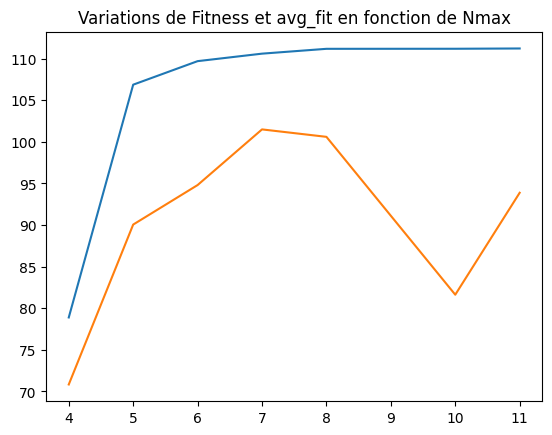

In [23]:
plt.plot(ResultsN[:,0],ResultsN[:,1])
plt.plot(ResultsN[:,0],ResultsN[:,2])
plt.title("Variations de Fitness et avg_fit en fonction de Nmax")
plt.show()

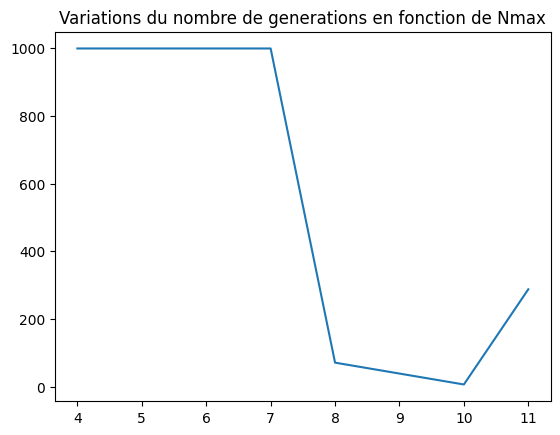

In [24]:
plt.plot(ResultsN[:,0],ResultsN[:,3])
plt.title("Variations du nombre de generations en fonction de Nmax")
plt.show()

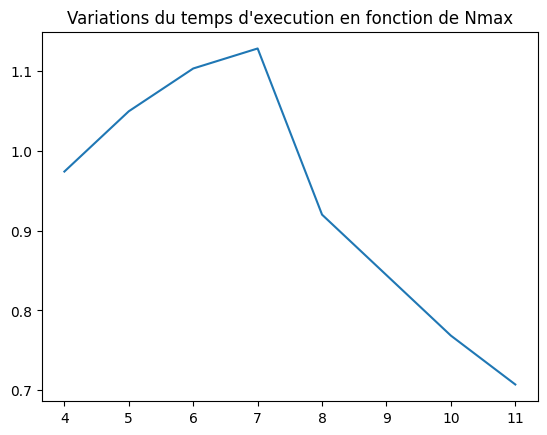

In [25]:
plt.plot(ResultsN[:,0],ResultsN[:,4])
plt.title("Variations du temps d'execution en fonction de Nmax")
plt.show()

# Question 6 (2pts)

#### MINIMIZING g(x) =x^2/10 cos(1/(10x))sin(x/10) USING GENETIC ALGORITHM 
reécrire les codes de la question 3 pour lancer un teste de minimization de g(x)

In [26]:


def gx(chromosome: Chromosome):
    x= chromosome_to_x(chromosome)
    if x==0: 
        return 0
    gx= x**2/10*np.cos(1/(10*x))*np.sin(x/10)
    return gx

FITNESS_LIMIT = 0
POPULATION_SIZE = 4
MUTATION_RATE = 0.15
GENERATION_LIMIT =  1000


In [27]:
def run_genetic():
    start = time.time()
    population, best_f, generations =  run_evolution(
            populate_func=partial(generate_population, size=POPULATION_SIZE, genome=genome_gx(), chromosome_length=n_bits(Nmax)),
            fitness_func=fitness_gx, mutation_func=partial(mutation, genome=genome_gx(), probability=MUTATION_RATE),
            fitness_limit=FITNESS_LIMIT, crossover_func=single_point_crossover,
            printer=print_statistics, maximize=False,
            generation_limit=GENERATION_LIMIT) 
    end = time.time() 
    elapsed_time=(end - start)
    generation_id,  min_fit ,  max_fit ,  avg_fit , stdev_fit  = \
                                    get_statistics(population, generations, fitness_func=fitness_gx)
    
    return generation_id, chromosome_to_x(population[0]), min_fit,  max_fit, avg_fit,  stdev_fit,  elapsed_time


gen_i, x,  min_fit,  max_fit, avg_fit, stdev_fit, t = run_genetic()
print("x qui minimise g {:.2f}".format(x))
print("g( {:.2f} )= {:.2f}".format(x, (x * x * np.cos(1 / (10. * x)) * np.sin(x / 10.) / 10.)))
print("fitness de x : {:.2f}".format(fitness))
print("nombre de generations:", gen_i)
print("la moyen des fitness de la generation ", gen_i, " est {:.2f}".format(avg_fit))
print("Le temps d'execution est  {:.3f}".format(t))

GENERATION 00
Population: [00010110110, 01010110111, 01010001100, 00101101001]
  Min 17.96720430176596
  Max 75.05397254788822
  Avg 49.08596346048128
  Std 23.579366269751045
GENERATION 01
Population: [00010110110, 01010110111, 01010110110, 00010001100]
  Min 17.96720430176596
  Max 56.558719479152494
  Avg 43.242892636944646
  Std 17.20165658186531
GENERATION 02
Population: [00010110110, 00010110110, 01010110111, 01010110110]
  Min 17.96720430176596
  Max 49.23173144203159
  Avg 33.595013842598014
  Std 18.04544155629617
GENERATION 03
Population: [00010110110, 00010110110, 00010110110, 00010110110]
  Min 17.96720430176596
  Max 17.96720430176596
  Avg 17.96720430176596
  Std 0.0
GENERATION 04
Population: [00010110110, 00010110110, 00010110110, 00010110110]
  Min 17.96720430176596
  Max 17.96720430176596
  Avg 17.96720430176596
  Std 0.0
GENERATION 05
Population: [00010110110, 00010110110, 00010110110, 00010110110]
  Min 17.96720430176596
  Max 17.96720430176596
  Avg 17.9672043017659